In [1]:
# Install the required libraries
#!pip install prophet
#!pip install jupyter_bokeh
#!pip install hvplot
#!pip install prophet
#!pip install seaborn
#!pip install cartopy
#!pip install geoviews



In [2]:
!pip install cartopy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 32.9 MB/s eta 0:00:00


In [3]:
!pip install geoviews

INFO: pip is looking at multiple versions of panel to determine which version is compatible with other requirements. This could take a while.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 563.2/563.2 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 43.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 27.4/27.4 MB 21.3 MB/s eta 0:00:00
  Attempting uninstall: bokeh
    Found existing installation: bokeh 3.4.3
    Uninstalling bokeh-3.4.3:
      Successfully uninstalled bokeh-3.4.3
  Attempting uninstall: panel
    Found existing installation: panel 1.4.5
    Uninstalling panel-1.4.5:
      Successfully uninstalled panel-1.4.5


In [4]:
!pip install prophet

In [5]:
!pip install hvplot

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 161.0/161.0 kB 3.9 MB/s eta 0:00:00


In [6]:
!pip install jupyter_bokeh

  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.6/148.6 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 49.5 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.9
    Uninstalling widgetsnbextension-3.6.9:
      Successfully uninstalled widgetsnbextension-3.6.9
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1


In [7]:
#import supporting liberaries - Panda, Matplotlib, Prophet, Numpy, hvplot
import pandas as pd
import matplotlib.pyplot as plt
import prophet as Prophet
import numpy as np
import datetime as dt
import hvplot.pandas
import panel as pn # for panels to use with hvplot.points


# Phase 1:
Cleaning and filtering the dataset to improve its usability and narrow the scope of our project


In [8]:
#upload ufoSighting.csv - available at https://docs.google.com/spreadsheets/d/1iNNPzkDTDiaTnbYqBY4ELH_0rPts2uXgl_JSdKCEgUE/edit?usp=drive_link
# path = 'resources/ufoSightings.csv'

In [9]:
from google.colab import files
uploaded = files.upload()

Saving ufoSightings.csv to ufoSightings.csv


In [10]:
#importing csv file in a dataframe
ufo_sightings_df = pd.read_csv("ufoSightings.csv",
                 #index_col="datetime",
                 parse_dates=['datetime'],
                 infer_datetime_format=True
                )

# Preview the dataset
ufo_sightings_df.head()

<ipython-input-10-1c61957ed029>:2: FutureWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  ufo_sightings_df = pd.read_csv("ufoSightings.csv",
<ipython-input-10-1c61957ed029>:2: DtypeWarning: Columns (5,9) have mixed types. Specify dtype option on import or set low_memory=False.
  ufo_sightings_df = pd.read_csv("ufoSightings.csv",


,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude
0,10/10/1949 20:30,san marcos,tx,us,cylinder,2700,45 minutes,This event took place in early fall around 194...,4/27/2004,29.8830556,-97.941111
1,10/10/1949 21:00,lackland afb,tx,NaN,light,7200,1-2 hrs,1949 Lackland AFB&#44 TX. Lights racing acros...,12/16/2005,29.38421,-98.581082
2,10/10/1955 17:00,chester (uk/england),NaN,gb,circle,20,20 seconds,Green/Orange circular disc over Chester&#44 En...,1/21/2008,53.2,-2.916667
3,10/10/1956 21:00,edna,tx,us,circle,20,1/2 hour,My older brother and twin sister were leaving ...,1/17/2004,28.9783333,-96.645833
4,10/10/1960 20:00,kaneohe,hi,us,light,900,15 minutes,AS a Marine 1st Lt. flying an FJ4B fighter/att...,1/22/2004,21.4180556,-157.803611


In [11]:
#cast datetime column as datetime datatype - #convert datetime column to datetime format
ufo_sightings_df['datetime'] = pd.to_datetime(ufo_sightings_df['datetime'], errors='coerce')
#ufo_sightings_df['datetime_1'] = ufo_sightings_df['datetime'].dt.strftime('%m/%d/%Y %H:%M')
ufo_sightings_df.dtypes

,0
datetime,datetime64[ns]
city,object
state,object
country,object
shape,object
duration (seconds),object
duration (hours/min),object
comments,object
date posted,object
latitude,object


In [12]:
#create a slice for country=us and drop any blank values and display first 5 and last 5 columns
us_ufo_df = ufo_sightings_df[ufo_sightings_df['country'] == 'us']
us_ufo_df = us_ufo_df.dropna(how='any')
display(us_ufo_df.head())
display(us_ufo_df.tail())

,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude
0,1949-10-10 20:30:00,san marcos,tx,us,cylinder,2700,45 minutes,This event took place in early fall around 194...,4/27/2004,29.8830556,-97.941111
3,1956-10-10 21:00:00,edna,tx,us,circle,20,1/2 hour,My older brother and twin sister were leaving ...,1/17/2004,28.9783333,-96.645833
4,1960-10-10 20:00:00,kaneohe,hi,us,light,900,15 minutes,AS a Marine 1st Lt. flying an FJ4B fighter/att...,1/22/2004,21.4180556,-157.803611
5,1961-10-10 19:00:00,bristol,tn,us,sphere,300,5 minutes,My father is now 89 my brother 52 the girl wit...,4/27/2007,36.595,-82.188889
7,1965-10-10 23:45:00,norwalk,ct,us,disk,1200,20 minutes,A bright orange color changing to reddish colo...,10/2/1999,41.1175,-73.408333


,datetime,city,state,country,shape,duration (seconds),duration (hours/min),comments,date posted,latitude,longitude
80327,2013-09-09 21:15:00,nashville,tn,us,light,600.0,10 minutes,Round from the distance/slowly changing colors...,9/30/2013,36.165833,-86.784444
80328,2013-09-09 22:00:00,boise,id,us,circle,1200.0,20 minutes,Boise&#44 ID&#44 spherical&#44 20 min&#44 10 r...,9/30/2013,43.613611,-116.202500
80329,2013-09-09 22:00:00,napa,ca,us,other,1200.0,hour,Napa UFO&#44,9/30/2013,38.297222,-122.284444
80330,2013-09-09 22:20:00,vienna,va,us,circle,5.0,5 seconds,Saw a five gold lit cicular craft moving fastl...,9/30/2013,38.901111,-77.265556
80331,2013-09-09 23:00:00,edmond,ok,us,cigar,1020.0,17 minutes,2 witnesses 2 miles apart&#44 Red &amp; White...,9/30/2013,35.652778,-97.477778


In [13]:
#drop unwanted columns like duration hour/min, comments, date posted
cleaned_us_ufo_df = us_ufo_df.drop(columns=['duration (hours/min)', 'comments', 'date posted'])
cleaned_us_ufo_df.tail()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude
80327,2013-09-09 21:15:00,nashville,tn,us,light,600.0,36.165833,-86.784444
80328,2013-09-09 22:00:00,boise,id,us,circle,1200.0,43.613611,-116.202500
80329,2013-09-09 22:00:00,napa,ca,us,other,1200.0,38.297222,-122.284444
80330,2013-09-09 22:20:00,vienna,va,us,circle,5.0,38.901111,-77.265556
80331,2013-09-09 23:00:00,edmond,ok,us,cigar,1020.0,35.652778,-97.477778


In [14]:
# Sorting data by datetime column
cleaned_us_ufo_df.sort_values(by=['datetime'], inplace=True)
cleaned_us_ufo_df.shape

(63099, 8)

In [15]:
# Checking range data available in dataset
display(cleaned_us_ufo_df['datetime'].min())
cleaned_us_ufo_df['datetime'].max()

Timestamp('1910-06-01 15:00:00')

Timestamp('2014-05-08 00:00:00')

In [16]:
#casting duration in seconds to float to perform agreegation
# Convert 'duration (seconds)' to numeric before calculating mean
cleaned_us_ufo_df['duration (seconds)'] = pd.to_numeric(cleaned_us_ufo_df['duration (seconds)'], errors='coerce')

#cleaned_us_ufo_df['duration (seconds)'] = cleaned_us_ufo_df['duration (seconds)'].astype(float)
#check to ensure conversion of column type
cleaned_us_ufo_df.dtypes

,0
datetime,datetime64[ns]
city,object
state,object
country,object
shape,object
duration (seconds),float64
latitude,object
longitude,float64


In [17]:
#add a column for year by extracting from datetime column to use for grouping and display last (10) records
cleaned_us_ufo_df['year'] = cleaned_us_ufo_df['datetime'].dt.year
cleaned_us_ufo_df.tail(10)

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year
46144,2014-05-07 03:30:00,calera,al,us,circle,240.0,33.1027778,-86.753611,2014
46145,2014-05-07 09:30:00,port richey,fl,us,unknown,1.0,28.2713889,-82.719722,2014
46147,2014-05-07 15:00:00,san jose,ca,us,disk,30.0,37.3394444,-121.893889,2014
46148,2014-05-07 17:30:00,lakeville,mn,us,oval,90.0,44.6497222,-93.242500,2014
46151,2014-05-07 20:30:00,visalia,ca,us,fireball,180.0,36.3302778,-119.291111,2014
46150,2014-05-07 20:30:00,seagrove beach,fl,us,fireball,60.0,30.3183333,-86.130278,2014
46152,2014-05-07 21:00:00,theodore,al,us,circle,120.0,30.5475,-88.175278,2014
46153,2014-05-07 21:10:00,naugatuck,ct,us,unknown,300.0,41.4858333,-73.051111,2014
46154,2014-05-07 21:20:00,hillsboro,mo,us,fireball,360.0,38.2322222,-90.562778,2014
46301,2014-05-08 00:00:00,memphis,tn,us,rectangle,900.0,35.1494444,-90.048889,2014


In [18]:
cleaned_us_ufo_df_copy = cleaned_us_ufo_df.copy()
cleaned_us_ufo_df_copy.dropna()
cleaned_us_ufo_df_copy.tail()
# drop NaT values from datetime
cleaned_us_ufo_df_copy = cleaned_us_ufo_df_copy[cleaned_us_ufo_df_copy['datetime'].notna()]
cleaned_us_ufo_df_copy.tail()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year
46150,2014-05-07 20:30:00,seagrove beach,fl,us,fireball,60.0,30.3183333,-86.130278,2014
46152,2014-05-07 21:00:00,theodore,al,us,circle,120.0,30.5475,-88.175278,2014
46153,2014-05-07 21:10:00,naugatuck,ct,us,unknown,300.0,41.4858333,-73.051111,2014
46154,2014-05-07 21:20:00,hillsboro,mo,us,fireball,360.0,38.2322222,-90.562778,2014
46301,2014-05-08 00:00:00,memphis,tn,us,rectangle,900.0,35.1494444,-90.048889,2014


# Phase 2:
Identifying the most active period and states for UFO sightings¶

## 2.1 Count, Mean, and Sum of United States UFO Sightings

,duration (seconds)
year,
1910,120.0
1920,60.0
1925,60.0
1929,60.0
1931,930.0
...,...
2010,2295.1
2011,2375.1
2012,10803.3


<Figure size 1200x400 with 0 Axes>

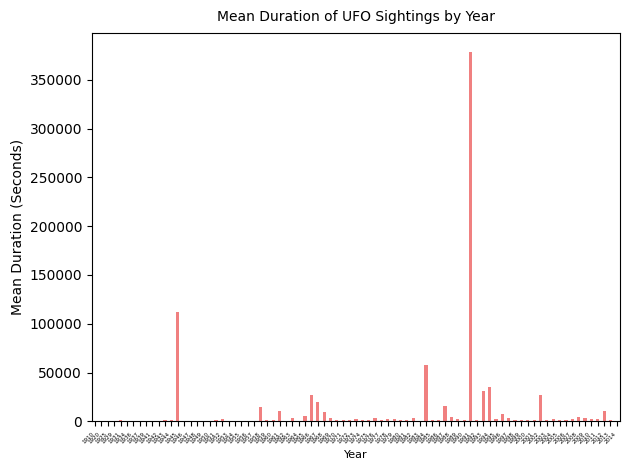

In [19]:
import matplotlib.pyplot as plt

# Create a pivot table for average sighting by year
us_ufo_df_year_avg = pd.pivot_table(cleaned_us_ufo_df,
                                   index='year',
                                   values='duration (seconds)',
                                   aggfunc='mean').round(1)

# Display all the data
display(us_ufo_df_year_avg)

# Plot with updated aesthetics and lightcoral color
plt.figure(figsize=(12, 4))  # Adjusted figure size for more data
ax = us_ufo_df_year_avg.plot(kind='bar', color='lightcoral', legend=False)

# Set the title and axis labels with improved font sizes
ax.set_title('Mean Duration of UFO Sightings by Year', fontsize=10, pad=9)
ax.set_xlabel('Year', fontsize=8)
ax.set_ylabel('Mean Duration (Seconds)', fontsize=10)

# Rotate x-axis labels for better readability
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=4)

# Tighter layout to prevent labels from overlapping
plt.tight_layout()

# Show the plot
plt.show()


,duration (seconds)
year,
1985,1121.9
1986,1272.4
1987,15769.9
1988,4039.2
1989,2633.2
1990,1270.7
1991,378622.1
1992,883.9
1993,31490.6


<Figure size 1200x600 with 0 Axes>

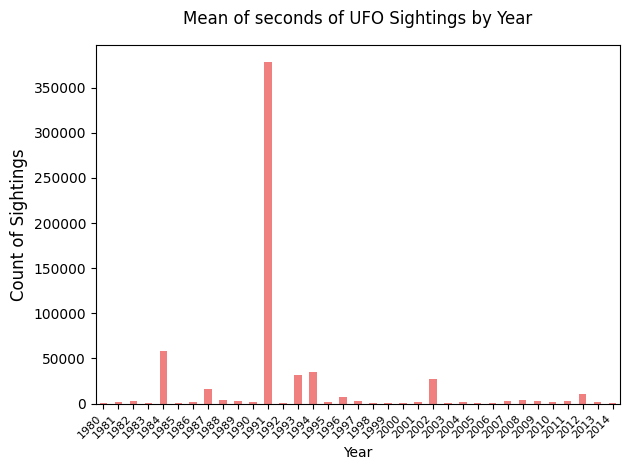

In [20]:
import matplotlib.pyplot as plt

# Create the pivot table
us_ufo_df_year = pd.pivot_table(cleaned_us_ufo_df,
                                index='year',
                                values='duration (seconds)',
                                aggfunc='mean').round(1)

# Display the last 30 years of data
display(us_ufo_df_year.tail(30))

# Plot with updated aesthetics and purple color
plt.figure(figsize=(12, 6))  # Adjust the figure size here (width, height)
ax = us_ufo_df_year.tail(35).plot(kind='bar', legend=False, color='lightcoral')

# Title and axis labels
ax.set_title('Mean of seconds of UFO Sightings by Year', fontsize=12, pad=15)
ax.set_xlabel('Year', fontsize=10)
ax.set_ylabel('Count of Sightings', fontsize=12)

# Rotate x-axis labels for better readability
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=8)

# Make the layout tighter to remove extra whitespace
plt.tight_layout()

# Show the plot
plt.show()

,duration (seconds)
year,
1910,1
1920,1
1925,1
1929,1
1931,2
...,...
2010,3488
2011,4306
2012,6216


<Figure size 1200x600 with 0 Axes>

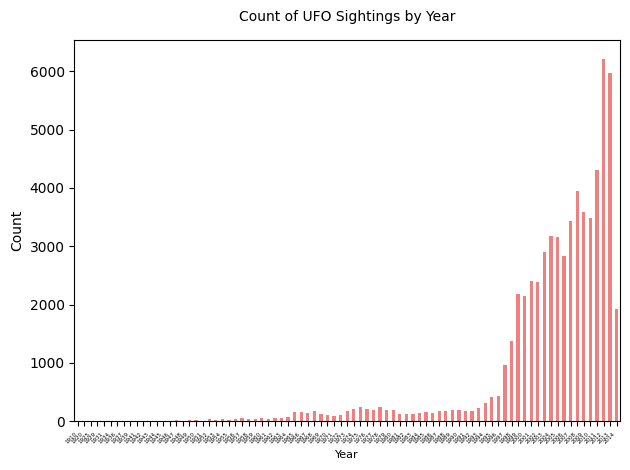

In [21]:
import matplotlib.pyplot as plt
# Best_longform
# Create a pivot table for average sighting by year
us_ufo_df_year_avg = pd.pivot_table(cleaned_us_ufo_df,
                                   index='year',
                                   values='duration (seconds)',
                                   aggfunc='count').round(1)

# Display all the data
display(us_ufo_df_year_avg)

# Plot with updated aesthetics and lightcoral color
plt.figure(figsize=(12, 6))  # Adjusted figure size for more data
ax = us_ufo_df_year_avg.plot(kind='bar', color='lightcoral', legend=False)

# Set the title and axis labels with improved font sizes
ax.set_title('Count of UFO Sightings by Year', fontsize=10, pad=14)
ax.set_xlabel('Year', fontsize=8)
ax.set_ylabel('Count', fontsize=10)

# Rotate x-axis labels for better readability
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=4)

# Tighter layout to prevent labels from overlapping
plt.tight_layout()

# Show the plot
plt.show()


<Figure size 2200x800 with 0 Axes>

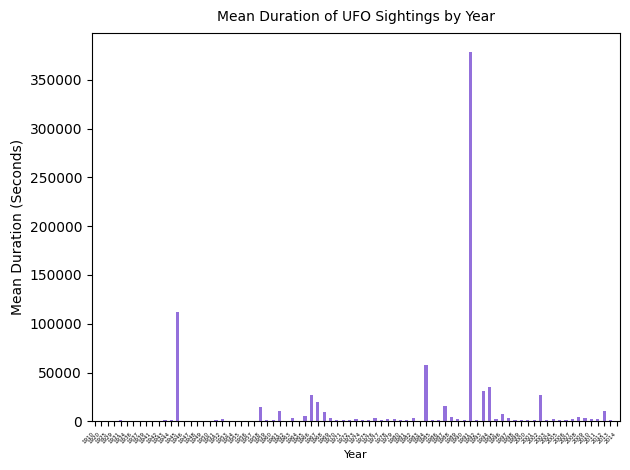

In [22]:
import matplotlib.pyplot as plt

# Create a pivot table for average sighting by year
us_ufo_df_year_avg = pd.pivot_table(cleaned_us_ufo_df,
                                   index='year',
                                   values='duration (seconds)',
                                   aggfunc='mean').round(1)

# Display all the data
# display(us_ufo_df_year_avg)

# Plot with updated aesthetics and color
plt.figure(figsize=(22, 8))  # Adjusted figure size for more data
ax = us_ufo_df_year_avg.plot(kind='bar', color='mediumpurple', legend=False)

# Set the title and axis labels with improved font sizes
ax.set_title('Mean Duration of UFO Sightings by Year', fontsize=10, pad=9)
ax.set_xlabel('Year', fontsize=8)
ax.set_ylabel('Mean Duration (Seconds)', fontsize=10)

# Rotate x-axis labels for better readability
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=4)

# Tighter layout to prevent labels from overlapping
plt.tight_layout()

# Show the plot
plt.show()


,duration (seconds)
year,
1910,120.0
1920,60.0
1925,60.0
1929,60.0
1931,1860.0
...,...
2010,8005414.2
2011,10227166.1
2012,67153526.9


<Figure size 2200x800 with 0 Axes>

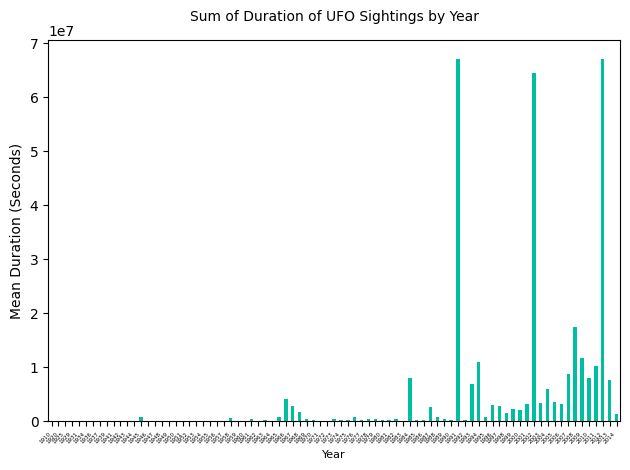

In [23]:
import matplotlib.pyplot as plt
# Best_longform
# Create a pivot table for average sighting by year
us_ufo_df_year_avg = pd.pivot_table(cleaned_us_ufo_df,
                                   index='year',
                                   values='duration (seconds)',
                                   aggfunc='sum').round(1)

# Display all the data
display(us_ufo_df_year_avg)

# Plot with updated aesthetics and color
plt.figure(figsize=(22, 8))  # Adjusted figure size for more data
ax = us_ufo_df_year_avg.plot(kind='bar', color='#00bfa0', legend=False)

# Set the title and axis labels with improved font sizes
ax.set_title('Sum of Duration of UFO Sightings by Year', fontsize=10, pad=14)
ax.set_xlabel('Year', fontsize=8)
ax.set_ylabel('Mean Duration (Seconds)', fontsize=10)

# Rotate x-axis labels for better readability
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=4)

# Tighter layout to prevent labels from overlapping
plt.tight_layout()

# Show the plot
plt.show()


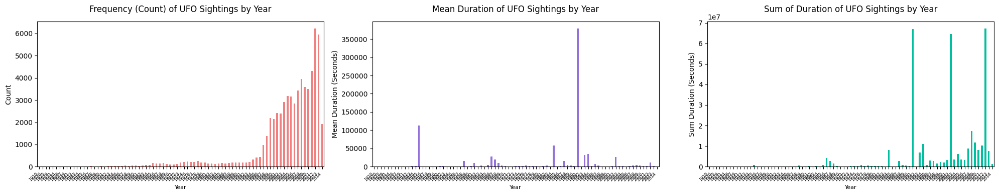

In [24]:
import matplotlib.pyplot as plt
import pandas as pd

# Set a white background without grid lines
plt.style.use('default')

# Set the figure size and number of subplots (1 row, 3 columns)
fig, axes = plt.subplots(1, 3, figsize=(20, 4))

# ---------------- Plot 1: Count of UFO Sightings by Year ----------------

# Create a pivot table for the count of sightings by year
us_ufo_df_year_count = pd.pivot_table(cleaned_us_ufo_df,
                                      index='year',
                                      values='duration (seconds)',
                                      aggfunc='count').round(1)

# Plot the count of UFO sightings by year
us_ufo_df_year_count.plot(kind='bar', color='lightcoral', legend=False, ax=axes[0])

# Set the title and axis labels
axes[0].set_title('Frequency (Count) of UFO Sightings by Year', fontsize=12, pad=14)
axes[0].set_xlabel('Year', fontsize=8)
axes[0].set_ylabel('Count', fontsize=10)

# Rotate x-axis labels for better readability
axes[0].set_xticklabels(axes[0].get_xticklabels(), rotation=45, ha='right', fontsize=6)

# Remove the grid lines and set the background to white
axes[0].set_facecolor('white')
axes[0].grid(False)

# ---------------- Plot 2: Mean Duration of UFO Sightings by Year ----------------

# Create a pivot table for the mean duration of sightings by year
us_ufo_df_year_avg = pd.pivot_table(cleaned_us_ufo_df,
                                    index='year',
                                    values='duration (seconds)',
                                    aggfunc='mean').round(1)

# Plot the mean duration of UFO sightings by year
us_ufo_df_year_avg.plot(kind='bar', color='mediumpurple', legend=False, ax=axes[1])

# Set the title and axis labels
axes[1].set_title('Mean Duration of UFO Sightings by Year', fontsize=12, pad=14)
axes[1].set_xlabel('Year', fontsize=8)
axes[1].set_ylabel('Mean Duration (Seconds)', fontsize=10)

# Rotate x-axis labels for better readability
axes[1].set_xticklabels(axes[1].get_xticklabels(), rotation=45, ha='right', fontsize=6)

# Remove the grid lines and set the background to white
axes[1].set_facecolor('white')
axes[1].grid(False)

# ---------------- Plot 3: Sum of Duration of UFO Sightings by Year ----------------

# Create a pivot table for the sum of durations by year
us_ufo_df_year_sum = pd.pivot_table(cleaned_us_ufo_df,
                                    index='year',
                                    values='duration (seconds)',
                                    aggfunc='sum').round(1)

# Plot the sum of UFO sighting durations by year
us_ufo_df_year_sum.plot(kind='bar', color='#00bfa0', legend=False, ax=axes[2])

# Set the title and axis labels
axes[2].set_title('Sum of Duration of UFO Sightings by Year', fontsize=12, pad=14)
axes[2].set_xlabel('Year', fontsize=8)
axes[2].set_ylabel('Sum Duration (Seconds)', fontsize=10)

# Rotate x-axis labels for better readability
axes[2].set_xticklabels(axes[2].get_xticklabels(), rotation=45, ha='right', fontsize=6)

# Remove the grid lines and set the background to white
axes[2].set_facecolor('white')
axes[2].grid(False)

# ---------------- Final adjustments ----------------

# Adjust layout to prevent overlapping of elements
plt.tight_layout()

# Show the final figure with all three plots side by side
plt.show()


,duration (seconds)
year,
1910,1
1920,1
1925,1
1929,1
1931,2
...,...
2010,3488
2011,4306
2012,6216


<Figure size 2200x800 with 0 Axes>

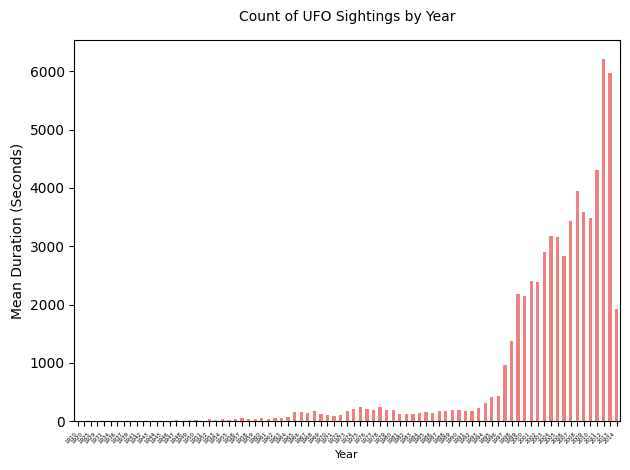

In [27]:
import matplotlib.pyplot as plt
# Best_longform
# Create a pivot table for average sighting by year
us_ufo_df_year_avg = pd.pivot_table(cleaned_us_ufo_df,
                                   index='year',
                                   values='duration (seconds)',
                                   aggfunc='count').round(1)

# Display all the data
display(us_ufo_df_year_avg)

# Plot with updated aesthetics and lightcoral color
plt.figure(figsize=(22, 8))  # Adjusted figure size for more data
ax = us_ufo_df_year_avg.plot(kind='bar', color='lightcoral', legend=False)

# Set the title and axis labels with improved font sizes
ax.set_title('Count of UFO Sightings by Year', fontsize=10, pad=14)
ax.set_xlabel('Year', fontsize=8)
ax.set_ylabel('Mean Duration (Seconds)', fontsize=10)

# Rotate x-axis labels for better readability
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha='right', fontsize=4)

# Tighter layout to prevent labels from overlapping
plt.tight_layout()

# Show the plot
plt.show()


## 2.2 create a dateframe for all US sightings with duration (seconds) greater than 300

In [29]:
#create a dateframe from us_ufo_df_year where duration (seconds) is greater than 300
us_ufo_df_year_over_300 = us_ufo_df_year[us_ufo_df_year['duration (seconds)'] > 300]

#take 1st value of index and store it to variable named selected
selected = us_ufo_df_year_over_300.index[0]

In [30]:
#group a dataframe by state and aggregate by count and sum

cleaned_us_ufo_df.groupby('state').agg({'duration (seconds)': ['count', 'sum', 'mean']}).head()

duration (seconds)                            
                   count          sum           mean
state                                               
ak                   303   1021662.00    3371.821782
al                   625    889050.50    1422.480800
ar                   569  66983744.20  117721.870299
az                  2348  15443101.60    6577.130153
ca                  8620  23938330.47    2777.068500

In [31]:
#based on analysis, extracting data for year which has data over 300
cleaned_us_ufo_df_new = cleaned_us_ufo_df[cleaned_us_ufo_df['year'] >= selected]
cleaned_us_ufo_df_new.head()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year
10885,1994-01-01 00:00:00,el segundo,ca,us,other,1800.0,33.9191667,-118.415556,1994
10887,1994-01-01 18:00:00,ringwood,nj,us,unknown,240.0,41.1133333,-74.245833,1994
24283,1994-01-03 23:30:00,albuquerque (30-60 miles west of city),nm,us,triangle,240.0,35.0844444,-106.650556,1994
24471,1994-01-04 23:00:00,susquehanna,pa,us,triangle,300.0,41.9433333,-75.600000,1994
11891,1994-01-12 18:00:00,cedar key,fl,us,chevron,300.0,29.1383333,-83.035278,1994


## 2.3 Top Ten States > 300: Count, Mean, Sum after 1999

In [32]:
#calculate count and avg duration anf group by state after 1990
us_ufo_state_count = pd.pivot_table(cleaned_us_ufo_df_new,
                             index='state',
                             values='duration (seconds)',
                             aggfunc='count').round(1)
us_ufo_state_count = us_ufo_state_count.sort_values(by=['duration (seconds)'], ascending=False)
#Selecting top 10 states by count
top_10_states_count = us_ufo_state_count[:10]
top_10_states_count

,duration (seconds)
state,
ca,7930
fl,3491
wa,3470
tx,3007
ny,2522
az,2255
il,2235
pa,2080
oh,1992


In [33]:
#agregate by mean and create a pivot table
us_ufo_state_average = pd.pivot_table(cleaned_us_ufo_df_new,
                             index='state',
                             values='duration (seconds)',
                             aggfunc='mean').round(1)

us_ufo_state_average =us_ufo_state_average.sort_values(by=['duration (seconds)'], ascending=False)
top_10_states_average = us_ufo_state_average[:10]
top_10_states_average

,duration (seconds)
state,
hi,29100.3
wa,16250.7
fl,15898.8
la,14335.9
va,11981.1
ms,10941.6
wv,7497.7
ut,5979.3
nm,4631.1


In [34]:
#agregate by mean and create a pivot table
us_ufo_state_total_seconds = pd.pivot_table(cleaned_us_ufo_df_new,
                             index='state',
                             values='duration (seconds)',
                             aggfunc='sum').round(1)

us_ufo_state_total_seconds =us_ufo_state_total_seconds.sort_values(by=['duration (seconds)'], ascending=False)
us_ufo_state_total_seconds = us_ufo_state_total_seconds[:10]
us_ufo_state_total_seconds

,duration (seconds)
state,
wa,56389887.4
fl,55502855.0
ca,21518701.5
va,13514651.0
ny,8544800.4
la,6752194.0
hi,6693062.0
az,6520462.6
tx,4136171.2


In [35]:
us_ufo_state_df = pd.merge(us_ufo_state_count, us_ufo_state_average, on='state')
us_ufo_state_df.columns = ['count', 'average_duration']
display(us_ufo_state_df.head())
display(us_ufo_state_df.tail())

,count,average_duration
state,,
ca,7930,2713.6
fl,3491,15898.8
wa,3470,16250.7
tx,3007,1375.5
ny,2522,3388.1


,count,average_duration
state,,
wy,153,1003.8
de,145,809.8
nd,106,1195.4
pr,15,1630.2
dc,7,235.1


In [36]:
us_ufo_state_df.describe()

,count,average_duration
count,52.000000,52.000000
mean,1106.596154,3588.584615
std,1284.706196,5303.259175
min,7.000000,235.100000
25%,409.750000,1023.825000
50%,730.500000,1383.900000
75%,1288.000000,3408.575000
max,7930.000000,29100.300000


In [37]:
count_percentile80 = us_ufo_state_df['count'].quantile(0.8)
count_percentile90 = us_ufo_state_df['count'].quantile(0.9)
avg_percentile80 = us_ufo_state_df['average_duration'].quantile(0.8)
avg_percentile90 = us_ufo_state_df['average_duration'].quantile(0.9)

print(f"90% quantile of average duration is {round(avg_percentile90,2)}")
print(f"80% quantile of average duration is {round(avg_percentile80,2)}")
print(f"90% quantile of count is {count_percentile90}")
print(f"80% quantile of count is {count_percentile80}")


90% quantile of average duration is 10597.21
80% quantile of average duration is 3902.66
90% quantile of count is 2253.0
80% quantile of count is 1566.4


In [38]:
# create a dataframe from us_ufo_state_df that has count and avg duration greater than or equalt to 90 percentile
#us_ufo_state_top_df = us_ufo_state_df[us_ufo_state_df['count'] > count_percentile80]
us_ufo_state_top_df = us_ufo_state_df[(us_ufo_state_df['count'] >= count_percentile90) | (us_ufo_state_df['average_duration'] >= avg_percentile90)]
us_ufo_state_top_df = us_ufo_state_top_df.sort_values(by=["state"])

In [39]:
#adding columns for calculating minutes and hour
us_ufo_state_top_df["average_duration_min"] = us_ufo_state_top_df['average_duration'] / 60
us_ufo_state_top_df["average_duration_hour"] = us_ufo_state_top_df['average_duration_min'] / 60
us_ufo_state_top_df.reset_index(inplace=True)
us_ufo_state_top_df

,state,count,average_duration,average_duration_min,average_duration_hour
0,az,2255,2891.6,48.193333,0.803222
1,ca,7930,2713.6,45.226667,0.753778
2,fl,3491,15898.8,264.980000,4.416333
3,hi,230,29100.3,485.005000,8.083417
4,la,471,14335.9,238.931667,3.982194
5,ms,303,10941.6,182.360000,3.039333
6,ny,2522,3388.1,56.468333,0.941139
7,tx,3007,1375.5,22.925000,0.382083
8,va,1128,11981.1,199.685000,3.328083
9,wa,3470,16250.7,270.845000,4.514083


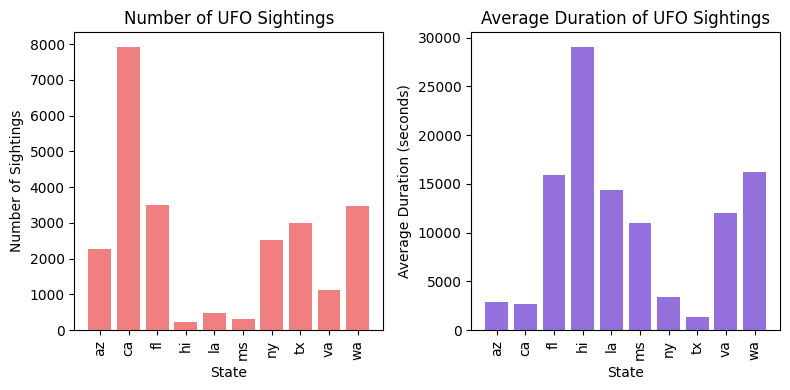

In [40]:
# Create a subplots to show data by counts and seconds side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 4))  # 1 row, 2 columns

# Plot the number of sightings on the first subplot
ax1.bar(us_ufo_state_top_df['state'], us_ufo_state_top_df['count'], color='lightcoral')
ax1.set_xlabel('State')
ax1.set_ylabel('Number of Sightings')
ax1.set_title('Number of UFO Sightings')
ax1.tick_params(axis='x', rotation=90)

# Plot the average duration on the second subplot
ax2.bar(us_ufo_state_top_df['state'], us_ufo_state_top_df['average_duration'], color='mediumpurple')
ax2.set_xlabel('State')
ax2.set_ylabel('Average Duration (seconds)')
ax2.set_title('Average Duration of UFO Sightings')
ax2.tick_params(axis='x', rotation=90)

# Adjust layout to prevent labels from overlapping
plt.tight_layout()

# Display the plot
plt.show()
# plt.savefig('ufo_sightings_subplots.png')


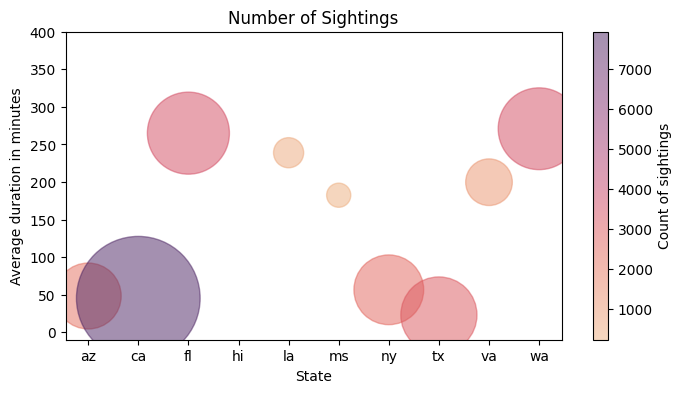

<Figure size 640x480 with 0 Axes>

In [41]:
import matplotlib.pyplot as plt
import seaborn as sns
#creatihg bubble chart to show states in top 90% counts

# Set figure size
plt.figure(figsize=(8, 4))

# Create scatter plot with the rocket color palette
scatter = plt.scatter(us_ufo_state_top_df["state"],
                      us_ufo_state_top_df["average_duration_min"],
                      s=us_ufo_state_top_df["count"],
                      c=us_ufo_state_top_df["count"],  # Use the count for color mapping
                      cmap=sns.color_palette("flare", as_cmap=True),  # Apply the rocket colormap
                      alpha=0.5)

# Set y-axis limits
plt.ylim(-10, 400)

# Set title and labels
plt.title("Number of Sightings")
plt.xlabel("State")
plt.ylabel("Average duration in minutes")

# Add color bar to show the scale of the 'count'
cbar = plt.colorbar(scatter)
cbar.set_label('Count of sightings')

# Show the plot
plt.show()

# Save the figure
plt.savefig('ufo_sightings_by_state_rocket.png')


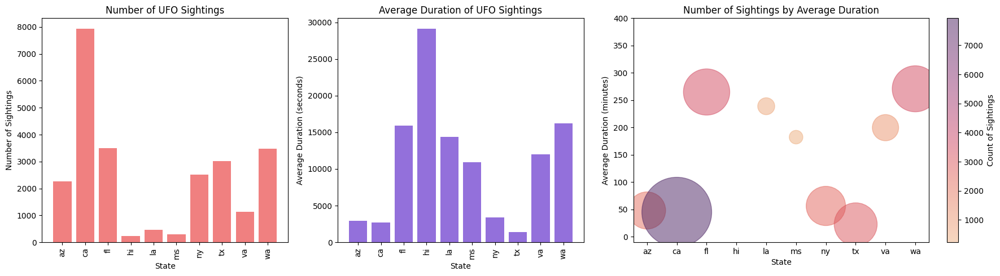

In [42]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.gridspec as gridspec

# Set up the figure and define gridspec for different width ratios
fig = plt.figure(figsize=(18, 5))
gs = gridspec.GridSpec(1, 3, width_ratios=[1, 1, 1.5])  # Plot 3 is 1.5x wider than Plots 1 and 2

# ----- Plot 1: Number of Sightings by State -----
ax1 = plt.subplot(gs[0])
ax1.bar(us_ufo_state_top_df['state'], us_ufo_state_top_df['count'], color='lightcoral')
ax1.set_xlabel('State')
ax1.set_ylabel('Number of Sightings')
ax1.set_title('Number of UFO Sightings')
ax1.tick_params(axis='x', rotation=90)

# ----- Plot 2: Average Duration by State -----
ax2 = plt.subplot(gs[1])
ax2.bar(us_ufo_state_top_df['state'], us_ufo_state_top_df['average_duration'], color='mediumpurple')
ax2.set_xlabel('State')
ax2.set_ylabel('Average Duration (seconds)')
ax2.set_title('Average Duration of UFO Sightings')
ax2.tick_params(axis='x', rotation=90)

# ----- Plot 3: Scatter Plot for Average Duration vs. Number of Sightings -----
ax3 = plt.subplot(gs[2])
scatter = ax3.scatter(us_ufo_state_top_df["state"],
                     us_ufo_state_top_df["average_duration_min"],
                     s=us_ufo_state_top_df["count"],
                     c=us_ufo_state_top_df["count"],  # Use the count for color mapping
                     cmap=sns.color_palette("flare", as_cmap=True),  # Apply the flare colormap
                     alpha=0.5)

# Set y-axis limits for Plot 3
ax3.set_ylim(-10, 400)

# Set title and labels for Plot 3
ax3.set_title("Number of Sightings by Average Duration")
ax3.set_xlabel("State")
ax3.set_ylabel("Average Duration (minutes)")

# Add color bar to show the scale of the 'count' for Plot 3
cbar = fig.colorbar(scatter, ax=ax3)
cbar.set_label('Count of Sightings')

# Adjust layout to prevent labels from overlapping
plt.tight_layout()

# Show all the plots
plt.show()


In [43]:
#import matplotlib.pyplot as plt


# Calculate the correlation coefficient
correlation = us_ufo_state_top_df['count'].corr(us_ufo_state_top_df['average_duration_min'])
print("Correlation coefficient:", correlation)


Correlation coefficient: -0.48557160943179895


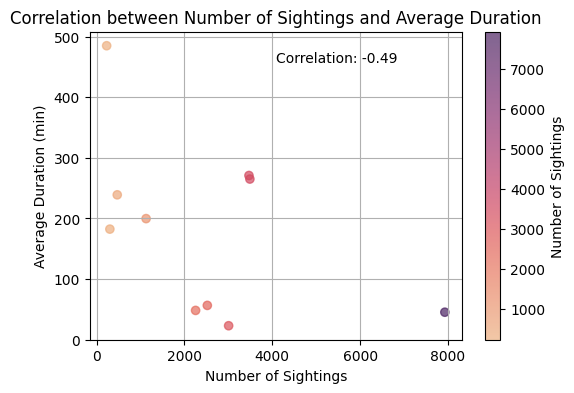

<Figure size 640x480 with 0 Axes>

In [44]:
import matplotlib.pyplot as plt
import seaborn as sns

# Create a scatter plot with the flare color palette
plt.figure(figsize=(6, 4))

# Use the 'count' variable to color the points based on the flare palette
scatter = plt.scatter(us_ufo_state_top_df['count'],
                      us_ufo_state_top_df['average_duration_min'],
                      c=us_ufo_state_top_df['count'],  # Use count for color mapping
                      cmap=sns.color_palette("flare", as_cmap=True),  # Apply the flare palette
                      alpha=0.7)

# Add color bar to indicate the values of 'count'
cbar = plt.colorbar(scatter)
cbar.set_label('Number of Sightings')

# Add labels and title
plt.xlabel('Number of Sightings')
plt.ylabel('Average Duration (min)')
plt.title('Correlation between Number of Sightings and Average Duration')

# Calculate and add the correlation coefficient to the plot
correlation = us_ufo_state_top_df['count'].corr(us_ufo_state_top_df['average_duration'])
plt.text(0.5, 0.9, f"Correlation: {correlation:.2f}", transform=plt.gca().transAxes)

# Add grid and display the plot
plt.grid(True)
plt.show()

# Save the figure
plt.savefig('correlation_sighting_duration_flare.png')


# Phase 3: Shapes¶

Shape to form

In [45]:
# add a new empty column to ufo_shape_data labeled 'form'
cleaned_us_ufo_df['form'] = ''
cleaned_us_ufo_df.head()
# if value in ufo_shape_data_df['shape'] column equals cigar, circle, round, sphere, oval, egg, cylinder or disk, then value in ufo_shape_data_df['form'] column equals circular
cleaned_us_ufo_df.loc[cleaned_us_ufo_df['shape'].isin(['cigar', 'circle', 'round', 'sphere', 'oval', 'egg', 'cylinder', 'disk']), 'form'] = 'circular'
# if value in ufo_shape_data_df['shape'] column equals fireball, flare, flash or light, then value in ufo_shape_data_df['form'] column equals light
cleaned_us_ufo_df.loc[cleaned_us_ufo_df['shape'].isin(['fireball', 'flare', 'flash', 'light']), 'form'] = 'light'
# if value in ufo_shape_data_df['shape'] column equals chevron, delta, triangle, pyramid or cone, then value in ufo_shape_data_df['form'] column equals triangle
cleaned_us_ufo_df.loc[cleaned_us_ufo_df['shape'].isin(['chevron', 'delta', 'triangle', 'pyramid', 'cone']), 'form'] = 'triangle'
# if value in ufo_shape_data_df['shape'] column equals formation, changed or changing, then value in ufo_shape_data_df['form'] column equals formation_changing
cleaned_us_ufo_df.loc[cleaned_us_ufo_df['shape'].isin(['formation', 'changed', 'changing']), 'form'] = 'formation_changing'
# if value in ufo_shape_data_df['shape'] column equals diamond, hexagon, crescent, cross, rectangle or teardrop, then value in ufo_shape_data_df['form'] column equals geometric
cleaned_us_ufo_df.loc[cleaned_us_ufo_df['shape'].isin(['diamond', 'hexagon', 'crescent', 'cross', 'rectangle', 'teardrop']), 'form'] = 'geometric'
# if value in ufo_shape_data_df['shape'] column equals other or unknown, then value in ufo_shape_data_df['form'] column equals other_unknown
cleaned_us_ufo_df.loc[cleaned_us_ufo_df['shape'].isin(['other', 'unknown']), 'form'] = 'other_unknown'
cleaned_us_ufo_df.head()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form
46858,1910-06-01 15:00:00,wills point,tx,us,cigar,120.0,32.7091667,-96.008056,1910,circular
46694,1920-06-11 21:00:00,cicero,in,us,unknown,60.0,40.1238889,-86.013333,1920,other_unknown
20951,1925-12-28 18:00:00,atkinson (6 miles north of),il,us,disk,60.0,41.4208333,-90.015000,1925,circular
62760,1929-07-05 14:00:00,buchanan (or burns),or,us,disk,60.0,43.6425,-118.627500,1929,circular
26550,1931-02-15 14:00:00,holyoke (6-8 miles southwest of),co,us,oval,60.0,40.5844444,-102.301944,1931,circular


## 3.1 Shape data all States
cleaned_

In [47]:
cleaned_us_ufo_df_tail = cleaned_us_ufo_df.tail(30)
# sort index by datetime column
cleaned_us_ufo_df_tail.sort_values('datetime', inplace=True, ascending=True)

# cleaned_us_ufo_df_tail.sort_index(inplace=True)
cleaned_us_ufo_df_tail.head()

<ipython-input-47-452869a2b453>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  cleaned_us_ufo_df_tail.sort_values('datetime', inplace=True, ascending=True)


,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form,TimeRange
45830,2014-05-05 03:20:00,byron,ga,us,circle,3000.0,32.6536111,-83.759722,2014,circular,2000-2014
45831,2014-05-05 09:40:00,vallejo,ca,us,sphere,120.0,38.1041667,-122.255556,2014,circular,2000-2014
45833,2014-05-05 19:30:00,honolulu,hi,us,changing,120.0,21.3069444,-157.858333,2014,formation_changing,2000-2014
45834,2014-05-05 20:09:00,nashville,tn,us,triangle,300.0,36.1658333,-86.784444,2014,triangle,2000-2014
45835,2014-05-05 20:30:00,boca raton,fl,us,triangle,300.0,26.3583333,-80.083333,2014,triangle,2000-2014


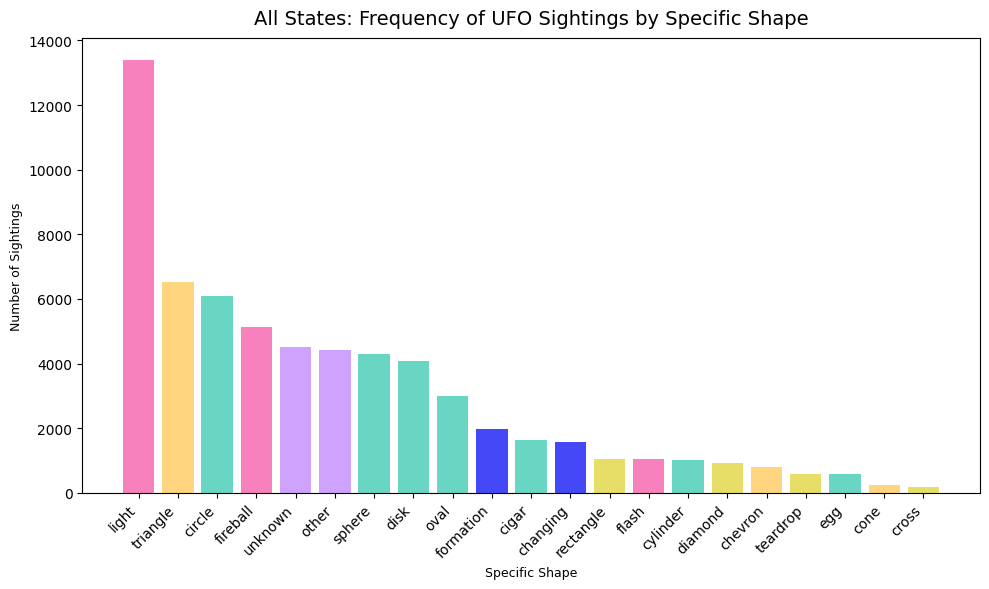

In [49]:
import matplotlib.pyplot as plt
import pandas as pd

# Data
data = {
    'Specific Shape': ['light', 'triangle', 'circle', 'fireball', 'unknown', 'other', 'sphere', 'disk', 'oval',
                       'formation', 'cigar', 'changing', 'rectangle', 'flash', 'cylinder', 'diamond', 'chevron',
                       'teardrop', 'egg', 'cone', 'cross'],
    'Number of Sightings': [13408, 6518, 6079, 5120, 4526, 4422, 4310, 4070, 3004, 1979, 1627, 1567, 1062, 1061,
                            1014, 921, 812, 590, 577, 246, 186]
}

# Create a DataFrame from the data
df = pd.DataFrame(data)

# Define the specific colors for each shape
shape_colors = {
    'light': '#f781bd',
    'triangle': '#FFD580',
    'circle': '#69d6c4',
    'fireball': '#f781bd',
    'unknown': '#CEA2FD',
    'other': '#CEA2FD',
    'sphere': '#69d6c4',
    'disk': '#69d6c4',
    'oval': '#69d6c4',
    'formation': '#4548f7',
    'cigar': '#69d6c4',
    'changing': '#4548f7',
    'rectangle': '#e6de67',
    'flash': '#f781bd',
    'cylinder': '#69d6c4',
    'diamond': '#e6de67',
    'chevron': '#FFD580',
    'teardrop': '#e6de67',
    'egg': '#69d6c4',
    'cone': '#FFD580',
    'cross': '#e6de67'
}

# Create a list of colors based on the shape
colors = [shape_colors[shape] for shape in df['Specific Shape']]

# Plot the bar chart
plt.figure(figsize=(10, 6))
plt.bar(df['Specific Shape'], df['Number of Sightings'], color=colors)

# Set labels and title
plt.xlabel('Specific Shape', fontsize=9)
plt.ylabel('Number of Sightings', fontsize=9)
plt.title('All States: Frequency of UFO Sightings by Specific Shape', fontsize=14, pad=10)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Tighter layout to avoid overlapping elements
plt.tight_layout()

# Show the plot
plt.show()


In [50]:
average_durations = cleaned_us_ufo_df.groupby('shape')['duration (seconds)'].mean()

# Sort shapes by average duration from highest to lowest
average_durations = average_durations.sort_values(ascending=False)

print(average_durations)

shape
crescent     37800.000000
light        15244.466042
flash         6474.389727
unknown       6282.328966
cylinder      4179.805720
other         4068.602374
circle        3726.184993
changed       3600.000000
fireball      3064.885260
delta         2682.500000
oval          2269.990679
cigar         2191.612477
changing      2159.434227
egg           2116.312998
cone          1608.483740
sphere        1599.553121
diamond       1451.965761
triangle      1441.690633
disk          1423.174504
formation     1014.116109
teardrop       940.734746
cross          742.864865
rectangle      639.601224
chevron        486.149815
round          452.500000
hexagon        240.000000
pyramid        120.000000
flare           30.000000
Name: duration (seconds), dtype: float64


In [51]:
# find the row with the word 'crescent'
cleaned_us_ufo_df.loc[cleaned_us_ufo_df['shape'] == 'crescent']

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form,TimeRange
32974,1997-03-22 22:30:00,stevens point,wi,us,crescent,37800.0,44.5236111,-89.574444,1997,geometric,1990-1999


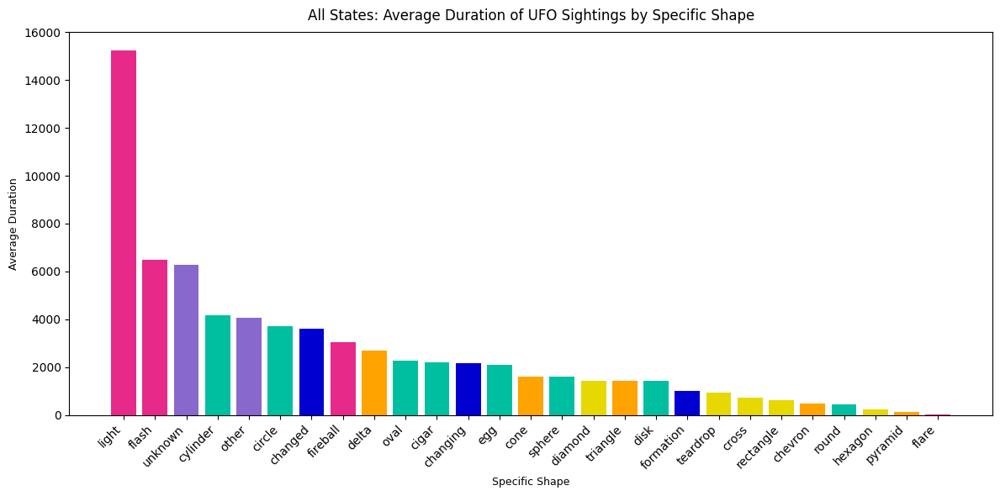

In [52]:
import matplotlib.pyplot as plt
import pandas as pd

# Data
data = {
    'Specific Shape': ['light', 'flash', 'unknown', 'cylinder', 'other', 'circle', 'changed', 'fireball', 'delta',
                       'oval', 'cigar', 'changing', 'egg', 'cone', 'sphere', 'diamond', 'triangle', 'disk', 'formation',
                       'teardrop', 'cross', 'rectangle', 'chevron', 'round', 'hexagon', 'pyramid', 'flare'],
    'Average Duration': [15244, 6474, 6282, 4180, 4069, 3726, 3600, 3065, 2683, 2270, 2192, 2159, 2116, 1608,
                         1600, 1452, 1442, 1423, 1014, 941, 743, 640, 486, 453, 240, 120, 30]
}

# Create a DataFrame from the data
df = pd.DataFrame(data)

# Define the specific colors for each shape
shape_colors = {
    'light': '#e7298a',
    'flash': '#e7298a',
    'unknown': '#8968CD',
    'cylinder': '#00bfa0',
    'other': '#8968CD',
    'circle': '#00bfa0',
    'changed': '#0000D1',
    'fireball': '#e7298a',
    'delta': '#ffa300',
    'oval': '#00bfa0',
    'cigar': '#00bfa0',
    'changing': '#0000D1',
    'egg': '#00bfa0',
    'cone': '#ffa300',
    'sphere': '#00bfa0',
    'diamond': '#e6d800',
    'triangle': '#ffa300',
    'disk': '#00bfa0',
    'formation': '#0000D1',
    'teardrop': '#e6d800',
    'cross': '#e6d800',
    'rectangle': '#e6d800',
    'chevron': '#ffa300',
    'round': '#00bfa0',
    'hexagon': '#e6d800',
    'pyramid': '#ffa300',
    'flare': '#e7298a'
}

# Create a list of colors based on the shape
colors = [shape_colors[shape] for shape in df['Specific Shape']]

# Plot the bar chart
plt.figure(figsize=(12, 6))
plt.bar(df['Specific Shape'], df['Average Duration'], color=colors)

# Set labels and title
plt.xlabel('Specific Shape', fontsize=9)
plt.ylabel('Average Duration', fontsize=9)
plt.title('All States: Average Duration of UFO Sightings by Specific Shape', fontsize=12, pad=10)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Tighter layout to avoid overlapping elements
plt.tight_layout()

# Show the plot
plt.show()


In [53]:
#agreegating count of form by grouping on form
cleaned_us_ufo_df.groupby('form').agg({'form': ['count']}).sort_values(by=[('form', 'count')], ascending=False)

,form
,count
form,
circular,20681
light,19589
other_unknown,8948
triangle,7576
formation_changing,3546
geometric,2759


In [54]:
# create a new column in ca_circular_seconds_sum_df using the year only from the datetime column and put it before the total_seconds column
cleaned_us_ufo_df['year'] = cleaned_us_ufo_df['datetime'].dt.year
cleaned_us_ufo_df.head()

# make a copy of cleaned_us_ufo_df with only the following columns in the order provided: datetime, year, state, duration (seconds), form

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form,TimeRange
46858,1910-06-01 15:00:00,wills point,tx,us,cigar,120.0,32.7091667,-96.008056,1910,circular,1910-1919
46694,1920-06-11 21:00:00,cicero,in,us,unknown,60.0,40.1238889,-86.013333,1920,other_unknown,1920-1929
20951,1925-12-28 18:00:00,atkinson (6 miles north of),il,us,disk,60.0,41.4208333,-90.015000,1925,circular,1920-1929
62760,1929-07-05 14:00:00,buchanan (or burns),or,us,disk,60.0,43.6425,-118.627500,1929,circular,1920-1929
26550,1931-02-15 14:00:00,holyoke (6-8 miles southwest of),co,us,oval,60.0,40.5844444,-102.301944,1931,circular,1930-1939


### Count, Mean, and Sum by Year Range

In [55]:
# make a copy of cleaned_us_ufo_df with only the following columns in the order provided: datetime, year, state, duration (seconds), form
revised_cleaned_us_ufo_df = cleaned_us_ufo_df[['datetime', 'year', 'state', 'duration (seconds)', 'form']]
revised_cleaned_us_ufo_df.head()

#sort index by datetime
# revised_cleaned_us_ufo_df.sort_values('datetime', inplace=True, ascending=True)
# revised_cleaned_us_ufo_df.head()

,datetime,year,state,duration (seconds),form
46858,1910-06-01 15:00:00,1910,tx,120.0,circular
46694,1920-06-11 21:00:00,1920,in,60.0,other_unknown
20951,1925-12-28 18:00:00,1925,il,60.0,circular
62760,1929-07-05 14:00:00,1929,or,60.0,circular
26550,1931-02-15 14:00:00,1931,co,60.0,circular


In [56]:
# make a copy of cleaned_us_ufo_df with only the following columns in the order provided: datetime, year, state, duration (seconds), form
revised_cleaned_us_ufo_df = cleaned_us_ufo_df[['datetime', 'year', 'state', 'duration (seconds)', 'form']]
# revised_cleaned_us_ufo_df.head()

#sort index by datetime
revised_cleaned_us_ufo_df.sort_values('datetime', inplace=True, ascending=True)
revised_cleaned_us_ufo_df.head()

<ipython-input-56-6f5f4907c435>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  revised_cleaned_us_ufo_df.sort_values('datetime', inplace=True, ascending=True)


,datetime,year,state,duration (seconds),form
46858,1910-06-01 15:00:00,1910,tx,120.0,circular
46694,1920-06-11 21:00:00,1920,in,60.0,other_unknown
20951,1925-12-28 18:00:00,1925,il,60.0,circular
62760,1929-07-05 14:00:00,1929,or,60.0,circular
26550,1931-02-15 14:00:00,1931,co,60.0,circular


In [57]:
# change the column names of the the following columns in revised_cleaned_us_ufo_df: 'duration (seconds)' to 	'duration_seconds'; and 'form' to 'shape'
revised_cleaned_us_ufo_df.rename(columns={'duration (seconds)': 'duration_seconds', 'form': 'shape'}, inplace=True)
revised_cleaned_us_ufo_df.head()

<ipython-input-57-0028c8b04e18>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  revised_cleaned_us_ufo_df.rename(columns={'duration (seconds)': 'duration_seconds', 'form': 'shape'}, inplace=True)


,datetime,year,state,duration_seconds,shape
46858,1910-06-01 15:00:00,1910,tx,120.0,circular
46694,1920-06-11 21:00:00,1920,in,60.0,other_unknown
20951,1925-12-28 18:00:00,1925,il,60.0,circular
62760,1929-07-05 14:00:00,1929,or,60.0,circular
26550,1931-02-15 14:00:00,1931,co,60.0,circular


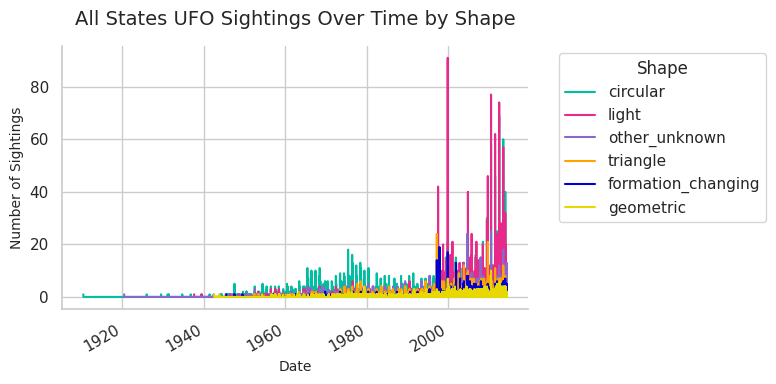

In [58]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Def_use
# Set a seaborn style for aesthetics
sns.set(style="whitegrid")

# Define the specific colors for each shape
# Define the specific colors for each shape
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'other_unknown': '#8968CD',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800'
}

# Desired order of shapes
shape_order = ['circular', 'light', 'other_unknown', 'triangle', 'formation_changing', 'geometric']

# Assume 'datetime' is already a datetime object; if not, convert it
# top_us_shape_df['datetime'] = pd.to_datetime(top_us_shape_df['datetime'])

# Sort the DataFrame by 'datetime'
df_sorted2 = revised_cleaned_us_ufo_df.sort_values('datetime')

# Group the data by 'shape'
grouped = df_sorted2.groupby('shape')

# Create a figure and axis
fig, ax = plt.subplots(figsize=(8, 4))

# Plot each group in the desired shape order using the specified color for each shape
for series_name in shape_order:
    if series_name in grouped.groups:  # Only plot if the shape exists in the data
        series = grouped.get_group(series_name)
        # Count occurrences per date
        counted = series.set_index('datetime').resample('D').size().reset_index(name='counts')
        # Plot the series with the specific color for each shape
        ax.plot(counted['datetime'], counted['counts'], label=series_name, color=shape_colors[series_name])

# Add title and labels
ax.set_title('All States UFO Sightings Over Time by Shape', fontsize=14, pad=15)
ax.set_xlabel('Date', fontsize=10)
ax.set_ylabel('Number of Sightings', fontsize=10)

# Format x-axis dates
plt.gcf().autofmt_xdate()

# Place the legend outside the plot with the desired shape order
ax.legend(title='Shape', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()

# Remove top and right spines
sns.despine()

# Show the plot
plt.show()


<ipython-input-60-3be906022079>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  revised_cleaned_us_ufo_df['year'] = revised_cleaned_us_ufo_df['datetime'].dt.year


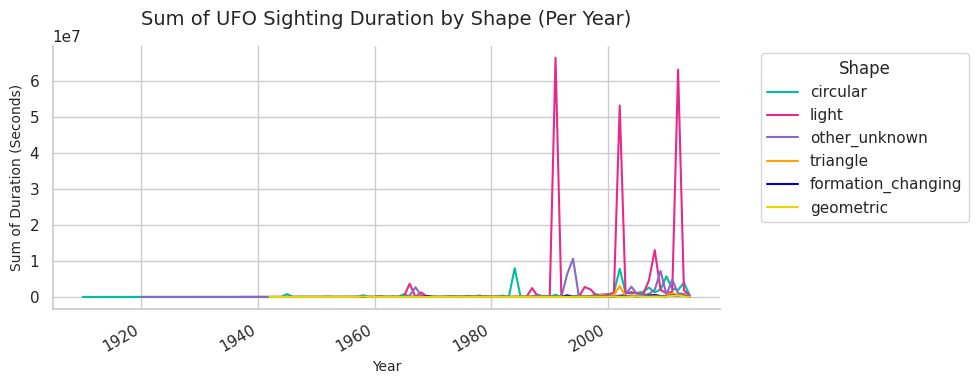

In [60]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Set a seaborn style for aesthetics
sns.set(style="whitegrid")

# Define the specific colors for each shape
shape_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'other_unknown': '#8968CD',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800'
}

# Desired order of shapes
shape_order = ['circular', 'light', 'other_unknown', 'triangle', 'formation_changing', 'geometric']

# Assume 'datetime' is already a datetime object; if not, convert it
# Convert 'datetime' to 'year' if not done already
revised_cleaned_us_ufo_df['year'] = revised_cleaned_us_ufo_df['datetime'].dt.year

# Sort the DataFrame by 'year'
df_sorted2 = revised_cleaned_us_ufo_df.sort_values('year')

# Group the data by 'shape' and 'year', then sum 'duration_seconds' for each combination
grouped = df_sorted2.groupby(['shape', 'year'])['duration_seconds'].sum().reset_index()

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 4))

# Plot each shape in the desired order using the specified color for each shape
for shape_name in shape_order:
    shape_data = grouped[grouped['shape'] == shape_name]
    if not shape_data.empty:  # Only plot if data exists for this shape
        ax.plot(shape_data['year'], shape_data['duration_seconds'], label=shape_name, color=shape_colors[shape_name])

# Add title and labels
ax.set_title('Sum of UFO Sighting Duration by Shape (Per Year)', fontsize=14, pad=15)
ax.set_xlabel('Year', fontsize=10)
ax.set_ylabel('Sum of Duration (Seconds)', fontsize=10)

# Format x-axis to show the years properly
plt.gcf().autofmt_xdate()

# Place the legend outside the plot with the desired shape order
ax.legend(title='Shape', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()

# Remove top and right spines
sns.despine()

# Show the plot
plt.show()


<ipython-input-61-68a58d9eee05>:23: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  revised_cleaned_us_ufo_df['year'] = revised_cleaned_us_ufo_df['datetime'].dt.year


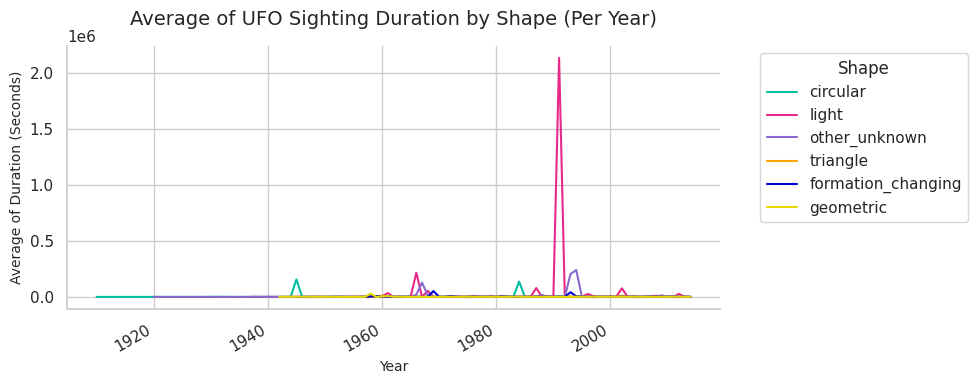

In [61]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Set a seaborn style for aesthetics
sns.set(style="whitegrid")

# Define the specific colors for each shape
shape_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'other_unknown': '#8968CD',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800'
}

# Desired order of shapes
shape_order = ['circular', 'light', 'other_unknown', 'triangle', 'formation_changing', 'geometric']

# Assume 'datetime' is already a datetime object; if not, convert it
# Convert 'datetime' to 'year' if not done already
revised_cleaned_us_ufo_df['year'] = revised_cleaned_us_ufo_df['datetime'].dt.year

# Sort the DataFrame by 'year'
df_sorted2 = revised_cleaned_us_ufo_df.sort_values('year')

# Group the data by 'shape' and 'year', then sum 'duration_seconds' for each combination
grouped = df_sorted2.groupby(['shape', 'year'])['duration_seconds'].mean().reset_index()

# Create a figure and axis
fig, ax = plt.subplots(figsize=(10, 4))

# Plot each shape in the desired order using the specified color for each shape
for shape_name in shape_order:
    shape_data = grouped[grouped['shape'] == shape_name]
    if not shape_data.empty:  # Only plot if data exists for this shape
        ax.plot(shape_data['year'], shape_data['duration_seconds'], label=shape_name, color=shape_colors[shape_name])

# Add title and labels
ax.set_title('Average of UFO Sighting Duration by Shape (Per Year)', fontsize=14, pad=15)
ax.set_xlabel('Year', fontsize=10)
ax.set_ylabel('Average of Duration (Seconds)', fontsize=10)

# Format x-axis to show the years properly
plt.gcf().autofmt_xdate()

# Place the legend outside the plot with the desired shape order
ax.legend(title='Shape', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to make room for the legend
plt.tight_layout()

# Remove top and right spines
sns.despine()

# Show the plot
plt.show()


<ipython-input-62-b38cc01f4a21>:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  revised_cleaned_us_ufo_df['year'] = revised_cleaned_us_ufo_df['datetime'].dt.year


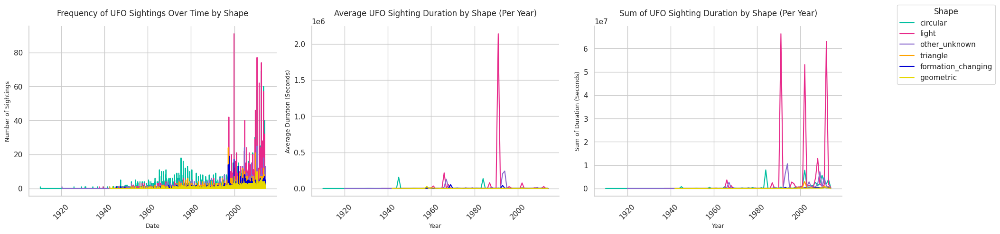

In [62]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Set a seaborn style for aesthetics
sns.set(style="whitegrid")

# Define the specific colors for each shape
shape_colors = {
  'circular': '#00bfa0',
  'light': '#e7298a',
  'triangle': '#ffa300',
  'other_unknown': '#8968CD',
  'formation_changing': '#0000D1',
  'geometric': '#e6d800'
}

# Desired order of shapes
shape_order = ['circular', 'light', 'other_unknown', 'triangle', 'formation_changing', 'geometric']

# Convert 'datetime' to 'year' if not done already
revised_cleaned_us_ufo_df['year'] = revised_cleaned_us_ufo_df['datetime'].dt.year

# Sort the DataFrame by 'datetime'
df_sorted2 = revised_cleaned_us_ufo_df.sort_values('datetime')

# Create a figure with 3 subplots (side by side)
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 5))

# ----- Plot 1: Frequency of UFO Sightings Over Time by Shape -----
# Group the data by 'shape'
grouped = df_sorted2.groupby('shape')

# Plot each group in the desired shape order using the specified color for each shape
for series_name in shape_order:
    if series_name in grouped.groups:
        series = grouped.get_group(series_name)
        counted = series.set_index('datetime').resample('D').size().reset_index(name='counts')
        ax1.plot(counted['datetime'], counted['counts'], label=series_name, color=shape_colors[series_name])

# Add title and labels for Plot 1
ax1.set_title('Frequency of UFO Sightings Over Time by Shape', fontsize=12, pad=15)
ax1.set_xlabel('Date', fontsize=9)
ax1.set_ylabel('Number of Sightings', fontsize=9)
ax1.xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter('%Y'))
ax1.tick_params(axis='x', rotation=45)

# ----- Plot 2: Average of UFO Sighting Duration by Shape (Per Year) -----
grouped_avg = df_sorted2.groupby(['shape', 'year'])['duration_seconds'].mean().reset_index()

# Plot each shape in the desired order using the specified color for each shape
for shape_name in shape_order:
    shape_data = grouped_avg[grouped_avg['shape'] == shape_name]
    if not shape_data.empty:
        ax2.plot(shape_data['year'], shape_data['duration_seconds'], label=shape_name, color=shape_colors[shape_name])

# Add title and labels for Plot 2
ax2.set_title('Average UFO Sighting Duration by Shape (Per Year)', fontsize=12, pad=15)
ax2.set_xlabel('Year', fontsize=9)
ax2.set_ylabel('Average Duration (Seconds)', fontsize=9)
ax2.tick_params(axis='x', rotation=45)

# ----- Plot 3: Sum of UFO Sighting Duration by Shape (Per Year) -----
grouped_sum = df_sorted2.groupby(['shape', 'year'])['duration_seconds'].sum().reset_index()

# Plot each shape in the desired order using the specified color for each shape
for shape_name in shape_order:
    shape_data = grouped_sum[grouped_sum['shape'] == shape_name]
    if not shape_data.empty:
        ax3.plot(shape_data['year'], shape_data['duration_seconds'], label=shape_name, color=shape_colors[shape_name])

# Add title and labels for Plot 3
ax3.set_title('Sum of UFO Sighting Duration by Shape (Per Year)', fontsize=12, pad=15)
ax3.set_xlabel('Year', fontsize=9)
ax3.set_ylabel('Sum of Duration (Seconds)', fontsize=9)
ax3.tick_params(axis='x', rotation=45)

# ----- Shared Legend -----
# Add a single shared legend for all plots, using the third axis for reference
handles, labels = ax3.get_legend_handles_labels()
fig.legend(handles, labels, title='Shape', bbox_to_anchor=(1.05, 1), loc='upper left')

# Adjust layout to prevent overlap and make room for the legend
plt.tight_layout()

# Remove top and right spines for all subplots
sns.despine()

# Show the plot
plt.show()


### Count, Mean, and Sum by Specific Year

In [ ]:
# Import necessary libraries
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Calculate sum_durations and merge it back into the original DataFrame
sum_durations = revised_cleaned_us_ufo_df.groupby('shape')['duration_seconds'].sum().reset_index(name='sum_durations')
revised_cleaned_us_ufo_df = pd.merge(revised_cleaned_us_ufo_df, sum_durations, on='shape', how='left')


# Create a chart to visualize the average_durations of UFO shapes by state
chart = alt.Chart(revised_cleaned_us_ufo_df).mark_bar().encode(
    x='year:N',  # State as a nominal value
    y='sum_durations:Q',  # sum_durations is now a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Sum Durations of UFO Shapes by State'
)

# Display the chart
chart

In [66]:
revised_cleaned_us_ufo_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,51175566.48
1,1920-06-11 21:00:00,1920,in,60.0,other_unknown,46425180.60
2,1925-12-28 18:00:00,1925,il,60.0,circular,51175566.48
3,1929-07-05 14:00:00,1929,or,60.0,circular,51175566.48
4,1931-02-15 14:00:00,1931,co,60.0,circular,51175566.48


In [ ]:
import altair as alt
import pandas as pd

import altair as alt

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
   'circular': '#69d6c4',
   'light': '#f781bd',
   'triangle': '#FFD580',
   'formation_changing': '#4548f7',
   'geometric': '#e6de67',
   'other_unknown': '#CEA2FD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Calculate sum_durations by year and shape, and filter for years 1943 to 1990
sum_durations_by_year = revised_cleaned_us_ufo_df.groupby(['year', 'shape'])['duration_seconds'].sum().reset_index(name='sum_durations')
filtered_data = sum_durations_by_year.query('1943 <= year <= 2013')

# Create a chart to visualize the sum of durations of UFO shapes by year within the filtered range
chart = alt.Chart(filtered_data).mark_bar().encode(
   x='year:O',  # Year as an ordinal value
   y='sum_durations:Q',  # Sum of durations is a quantitative field
   color=alt.Color(
       'shape:N',  # Shape as a nominal value
       scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                       range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
   )
).properties(
   title='Sum Durations of UFO Shapes by Year (1943 - 2013)'
)

# Display the chart
chart



In [ ]:
# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Create a chart to visualize the frequency of UFO shapes by state
chart = alt.Chart(revised_cleaned_us_ufo_df).mark_bar().encode(
    x='state:N',  # State as a nominal value
    y='count()',  # Count of occurrences
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Frequency of UFO Shapes by State'
)

# Display the chart
chart

#### Mean Durations of UFO Shapes by Year

In [ ]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Assuming 'year' is a column in the DataFrame
# Calculate sum_durations by year and shape
sum_durations_by_year = revised_cleaned_us_ufo_df.groupby(['state', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')

# Create a chart to visualize the sum of durations of UFO shapes by year
chart = alt.Chart(sum_durations_by_year).mark_bar().encode(
    x='state:O',  # Year as an ordinal value
    y='avg_durations:Q',  # Sum of durations is a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Mean Durations of UFO Shapes by State'
)

# Display the chart
chart


In [72]:
# make a copy of revised_cleaned_us_ufo_df removing all rows with 'ar' in the 'state' colum
revised_cleaned_us_ufo_df_no_ar = revised_cleaned_us_ufo_df[revised_cleaned_us_ufo_df['state'] != 'AR']


In [73]:
revised_cleaned_us_ufo_df_no_ar = revised_cleaned_us_ufo_df_no_ar.reset_index(drop=True)


In [74]:
revised_cleaned_us_ufo_df_no_ar['state'].unique()

array(['tx', 'in', 'il', 'or', 'co', 'ks', 'nd', 'ak', 'ca', 'al', 'sc',
       'ia', 'mi', 'ga', 'tn', 'ky', 'nm', 'fl', 'nc', 'va', 'ny', 'wa',
       'me', 'az', 'oh', 'pa', 'mn', 'wi', 'md', 'nv', 'id', 'mo', 'ok',
       'wv', 'ms', 'nj', 'ct', 'wy', 'ut', 'ri', 'ar', 'ma', 'ne', 'la',
       'de', 'nh', 'sd', 'vt', 'mt', 'hi', 'pr', 'dc'], dtype=object)

In [75]:

revised_cleaned_us_ufo_df_no_ar = revised_cleaned_us_ufo_df_no_ar[revised_cleaned_us_ufo_df_no_ar['state'] != 'ar']

In [76]:
revised_cleaned_us_ufo_df_no_ar['state'].unique()

array(['tx', 'in', 'il', 'or', 'co', 'ks', 'nd', 'ak', 'ca', 'al', 'sc',
       'ia', 'mi', 'ga', 'tn', 'ky', 'nm', 'fl', 'nc', 'va', 'ny', 'wa',
       'me', 'az', 'oh', 'pa', 'mn', 'wi', 'md', 'nv', 'id', 'mo', 'ok',
       'wv', 'ms', 'nj', 'ct', 'wy', 'ut', 'ri', 'ma', 'ne', 'la', 'de',
       'nh', 'sd', 'vt', 'mt', 'hi', 'pr', 'dc'], dtype=object)

In [77]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Assuming 'year' is a column in the DataFrame
# Calculate sum_durations by year and shape
sum_durations_by_year = revised_cleaned_us_ufo_df_no_ar.groupby(['state', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')

# Create a chart to visualize the sum of durations of UFO shapes by year
chart = alt.Chart(sum_durations_by_year).mark_bar().encode(
    x='state:O',  # Year as an ordinal value
    y='avg_durations:Q',  # Sum of durations is a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Mean Durations of UFO Shapes by State'
)

# Display the chart
chart


/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [78]:

revised_cleaned_us_ufo_df_no_ar_la_hi = revised_cleaned_us_ufo_df_no_ar[revised_cleaned_us_ufo_df_no_ar['state'] != 'la']

In [79]:
revised_cleaned_us_ufo_df_no_ar_la_hi['state'].unique()

array(['tx', 'in', 'il', 'or', 'co', 'ks', 'nd', 'ak', 'ca', 'al', 'sc',
       'ia', 'mi', 'ga', 'tn', 'ky', 'nm', 'fl', 'nc', 'va', 'ny', 'wa',
       'me', 'az', 'oh', 'pa', 'mn', 'wi', 'md', 'nv', 'id', 'mo', 'ok',
       'wv', 'ms', 'nj', 'ct', 'wy', 'ut', 'ri', 'ma', 'ne', 'de', 'nh',
       'sd', 'vt', 'mt', 'hi', 'pr', 'dc'], dtype=object)

In [80]:

revised_cleaned_us_ufo_df_no_ar_la_hi = revised_cleaned_us_ufo_df_no_ar_la_hi[revised_cleaned_us_ufo_df_no_ar_la_hi['state'] != 'hi']

In [81]:
revised_cleaned_us_ufo_df_no_ar_la_hi['state'].unique()

array(['tx', 'in', 'il', 'or', 'co', 'ks', 'nd', 'ak', 'ca', 'al', 'sc',
       'ia', 'mi', 'ga', 'tn', 'ky', 'nm', 'fl', 'nc', 'va', 'ny', 'wa',
       'me', 'az', 'oh', 'pa', 'mn', 'wi', 'md', 'nv', 'id', 'mo', 'ok',
       'wv', 'ms', 'nj', 'ct', 'wy', 'ut', 'ri', 'ma', 'ne', 'de', 'nh',
       'sd', 'vt', 'mt', 'pr', 'dc'], dtype=object)

In [82]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Assuming 'year' is a column in the DataFrame
# Calculate sum_durations by year and shape
sum_durations_by_year = revised_cleaned_us_ufo_df_no_ar_la_hi.groupby(['state', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')

# Create a chart to visualize the sum of durations of UFO shapes by year
chart = alt.Chart(sum_durations_by_year).mark_bar().encode(
    x='state:O',  # Year as an ordinal value
    y='avg_durations:Q',  # Sum of durations is a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Mean Durations of UFO Shapes by State (minus AR, LA, and HI)'
)

# Display the chart
chart


/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [83]:
south_central_mean_duration_df = revised_cleaned_us_ufo_df_no_ar[revised_cleaned_us_ufo_df_no_ar['state'].isin(['nm', 'tx', 'la', 'ok', 'mi', 'al'])]
south_central_mean_duration_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,5.117557e+07
9,1939-06-01 20:00:00,1939,al,300.0,light,2.269441e+08
12,1941-06-01 13:00:00,1941,mi,30.0,circular,5.117557e+07
17,1944-04-02 11:00:00,1944,nm,90.0,circular,5.117557e+07
18,1944-06-01 12:00:00,1944,nm,3600.0,circular,5.117557e+07


In [84]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Desired order of South Central states
state_order_south_central = ['nm', 'tx', 'la', 'ok', 'mi', 'al']  # Texas, Louisiana, Oklahoma, Arkansas

# Assuming 'year' is a column in the DataFrame
# Calculate sum_durations by state and shape
sum_durations_by_year_south_central = south_central_mean_duration_df.groupby(['state', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')

# Reorder the DataFrame based on the desired state order
sum_durations_by_year_south_central['state'] = pd.Categorical(sum_durations_by_year_south_central['state'], categories=state_order_south_central, ordered=True)
sum_durations_by_year_south_central = sum_durations_by_year_south_central.sort_values('state')

# Create a chart to visualize the sum of durations of UFO shapes by state in the specified order
chart = alt.Chart(sum_durations_by_year_south_central).mark_bar().encode(
    x=alt.X('state:O', sort=state_order_south_central),  # State as an ordinal value, ordered
    y='avg_durations:Q',  # Sum of durations is a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Mean Durations of UFO Shapes by South Central States'
)

# Display the chart
chart


/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [85]:
outlier_mean_duration_df = revised_cleaned_us_ufo_df_no_ar[revised_cleaned_us_ufo_df_no_ar['state'].isin(['ak', 'hi'])]
outlier_mean_duration_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations
7,1936-10-15 17:00:00,1936,ak,180.0,circular,51175566.48
73,1949-06-10 21:00:00,1949,ak,180.0,circular,51175566.48
75,1949-07-01 11:00:00,1949,ak,120.0,circular,51175566.48
177,1954-02-01 02:00:00,1954,ak,1140.0,other_unknown,46425180.60
322,1957-10-01 16:00:00,1957,ak,180.0,other_unknown,46425180.60


In [86]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Desired order of West Coast states
state_order_west_coast = ['ak', 'hi']  # Washington, Oregon, California

# Assuming 'year' is a column in the DataFrame
# Calculate sum_durations by state and shape
sum_durations_by_year_west = outlier_mean_duration_df.groupby(['state', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')

# Reorder the DataFrame based on the desired state order
sum_durations_by_year_west['state'] = pd.Categorical(sum_durations_by_year_west['state'], categories=state_order_west_coast, ordered=True)
sum_durations_by_year_west = sum_durations_by_year_west.sort_values('state')

# Create a chart to visualize the sum of durations of UFO shapes by state in the specified order
chart = alt.Chart(sum_durations_by_year_west).mark_bar().encode(
    x=alt.X('state:O', sort=state_order_west_coast),  # State as an ordinal value, ordered
    y='avg_durations:Q',  # Sum of durations is a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Mean Durations of UFO Shapes by Outlier States'
)

# Display the chart
chart


/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [87]:
west_coast_mean_duration_df = revised_cleaned_us_ufo_df_no_ar_la_hi[revised_cleaned_us_ufo_df_no_ar_la_hi['state'].isin(['wa', 'or', 'ca', 'nv', 'az'])]
west_coast_mean_duration_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations
3,1929-07-05 14:00:00,1929,or,60.0,circular,5.117557e+07
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08
16,1944-01-01 12:00:00,1944,ca,180.0,circular,5.117557e+07
23,1945-08-08 12:00:00,1945,ca,300.0,circular,5.117557e+07
27,1946-02-01 17:00:00,1946,ca,10.0,circular,5.117557e+07


In [88]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Desired order of West Coast states
state_order_west_coast = ['wa', 'or', 'ca', 'nv', 'az']  # Washington, Oregon, California

# Assuming 'year' is a column in the DataFrame
# Calculate sum_durations by state and shape
sum_durations_by_year_west = west_coast_mean_duration_df.groupby(['state', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')

# Reorder the DataFrame based on the desired state order
sum_durations_by_year_west['state'] = pd.Categorical(sum_durations_by_year_west['state'], categories=state_order_west_coast, ordered=True)
sum_durations_by_year_west = sum_durations_by_year_west.sort_values('state')

# Create a chart to visualize the sum of durations of UFO shapes by state in the specified order
chart = alt.Chart(sum_durations_by_year_west).mark_bar().encode(
    x=alt.X('state:O', sort=state_order_west_coast),  # State as an ordinal value, ordered
    y='avg_durations:Q',  # Sum of durations is a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Mean Durations of UFO Shapes by West Coast'
)

# Display the chart
chart


/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [89]:
east_coast_mean_duration_df = revised_cleaned_us_ufo_df_no_ar_la_hi[revised_cleaned_us_ufo_df_no_ar_la_hi['state'].isin(['me', 'nh', 'ma', 'ri', 'ct', 'ny', 'nj', 'pa', 'de', 'md', 'va', 'nc', 'sc', 'ga', 'fl'])]
east_coast_mean_duration_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations
10,1939-06-30 20:00:00,1939,sc,10.0,circular,5.117557e+07
13,1942-06-01 22:30:00,1942,ga,180.0,other_unknown,4.642518e+07
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08
20,1945-06-07 07:00:00,1945,nc,2.0,circular,5.117557e+07
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5.392210e+06


In [90]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

#Desired order of states
state_order = ['me', 'nh', 'ma', 'ri', 'ct', 'ny', 'nj', 'pa', 'de', 'md', 'va', 'nc', 'sc', 'ga', 'fl']

# Assuming 'year' is a column in the DataFrame
# Calculate sum_durations by year and shape
sum_durations_by_year = east_coast_mean_duration_df.groupby(['state', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')

# Create a chart to visualize the sum of durations of UFO shapes by year
chart = alt.Chart(sum_durations_by_year).mark_bar().encode(
    x='state:O',  # Year as an ordinal value
    y='avg_durations:Q',  # Sum of durations is a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Mean Durations of UFO Shapes by East Coast'
)

# Display the chart
chart


/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [91]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Desired order of states
state_order = ['me', 'nh', 'ma', 'ri', 'ct', 'ny', 'nj', 'pa', 'de', 'md', 'va', 'nc', 'sc', 'ga', 'fl']

# Assuming 'year' is a column in the DataFrame
# Calculate sum_durations by state and shape
sum_durations_by_year = east_coast_mean_duration_df.groupby(['state', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')

# Reorder the DataFrame based on the desired state order
sum_durations_by_year['state'] = pd.Categorical(sum_durations_by_year['state'], categories=state_order, ordered=True)
sum_durations_by_year = sum_durations_by_year.sort_values('state')

# Create a chart to visualize the sum of durations of UFO shapes by state in the specified order
chart = alt.Chart(sum_durations_by_year).mark_bar().encode(
    x=alt.X('state:O', sort=state_order),  # State as an ordinal value, ordered
    y='avg_durations:Q',  # Sum of durations is a quantitative field
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Mean Durations of UFO Shapes by East Coast'
)

# Display the chart
chart


/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [92]:
# make a copy of revised_cleaned_us_ufo with only the rows that have the following valriables in the revised_cleaned_us_ufo[state] column: 'az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa'
top_us_shape_df = revised_cleaned_us_ufo_df[revised_cleaned_us_ufo_df['state'].isin(['az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa'])]
top_us_shape_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,5.117557e+07
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08
16,1944-01-01 12:00:00,1944,ca,180.0,circular,5.117557e+07
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5.392210e+06


#### Mean Durations of UFO Shapes by Year

In [ ]:
import altair as alt

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800',
   'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Assuming 'year' is a column in the DataFrame
# Calculate mean durations by year and shape, and filter years between 1943 and 1990
sum_durations_by_year = revised_cleaned_us_ufo_df.groupby(['year', 'shape'])['duration_seconds'].mean().reset_index(name='avg_durations')
filtered_data = sum_durations_by_year.query('1943 <= year <= 2013')

# Create a chart to visualize the mean durations of UFO shapes by year within the filtered range
chart = alt.Chart(filtered_data).mark_bar().encode(
   x='year:O',  # Year as an ordinal value
   y='avg_durations:Q',  # Mean of durations is a quantitative field
   color=alt.Color(
       'shape:N',  # Shape as a nominal value
       scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                       range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
   )
).properties(
   title='Mean Durations of UFO Shapes by Year (1943 - 2013)'
)

# Display the chart
chart


In [100]:
revised_cleaned_us_ufo_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,51175566.48
1,1920-06-11 21:00:00,1920,in,60.0,other_unknown,46425180.60
2,1925-12-28 18:00:00,1925,il,60.0,circular,51175566.48
3,1929-07-05 14:00:00,1929,or,60.0,circular,51175566.48
4,1931-02-15 14:00:00,1931,co,60.0,circular,51175566.48


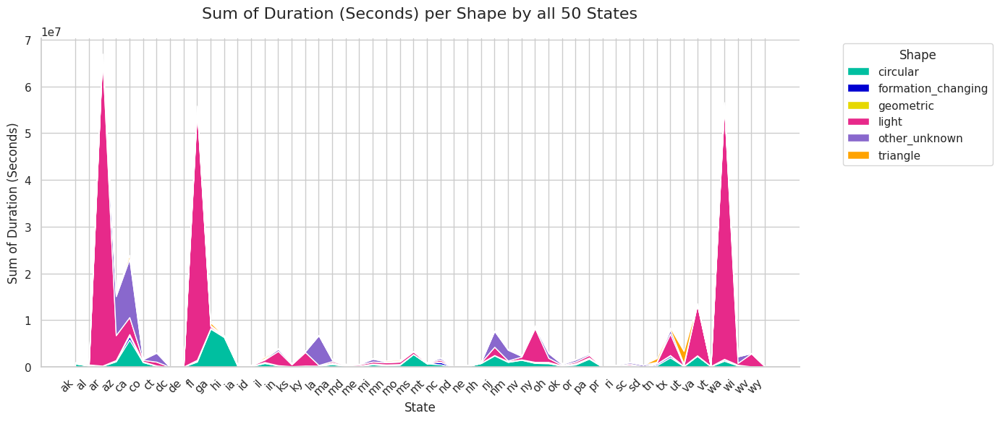

In [101]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the Seaborn theme for better aesthetics
sns.set_theme(style="whitegrid")

# Define the specific colors for each shape
shape_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'other_unknown': '#8968CD',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800'
}

# Group the data by 'state' and 'shape' and calculate the sum of duration_seconds
duration_per_shape_by_state = revised_cleaned_us_ufo_df.groupby(['state', 'shape'])['duration_seconds'].sum().reset_index()

# Pivot the data to create a DataFrame suitable for an area plot
pivot_data = duration_per_shape_by_state.pivot(index='state', columns='shape', values='duration_seconds').fillna(0)

# Set figure size
plt.figure(figsize=(14, 6))

# Create a stacked area plot with the custom color palette
# Ensure colors are ordered according to the order of columns in pivot_data
colors = [shape_colors[shape] for shape in pivot_data.columns]

plt.stackplot(pivot_data.index, pivot_data.T, labels=pivot_data.columns, colors=colors)

# Set chart title and labels
plt.title('Sum of Duration (Seconds) per Shape by all 50 States', fontsize=16, pad=20)
plt.xlabel('State', fontsize=12)
plt.ylabel('Sum of Duration (Seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display legend outside the plot to prevent overlap
plt.legend(title='Shape', bbox_to_anchor=(1.05, 1), loc='upper left')

# Despine the plot for a cleaner look
sns.despine()

# Adjust layout to prevent clipping of labels
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800',
   'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Filter the DataFrame to include only years from 1943 to 1990
filtered_data = revised_cleaned_us_ufo_df.query('1964 <= year <= 1996')

# Create a chart to visualize the frequency of UFO shapes by year
chart = alt.Chart(filtered_data).mark_bar().encode(
   x='year:N',  # Year as a nominal value
   y='count()',  # Count of occurrences
   color=alt.Color(
       'shape:N',  # Shape as a nominal value
       scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                       range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
   )
).properties(
   title='Frequency of UFO Shapes by Year (1964 - 1996)'
)

# Display the chart
chart


### Count, Mean, and Sum by State

In [ ]:
# Import necessary libraries
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']
# shape_order = ['light', 'circular', 'other_unknown', 'triangle', 'formation_changing', 'geometric']

# Calculate average_durations and merge it back into the DataFrame
# Rename the 'average_durations' column to avoid conflict
average_durations = revised_cleaned_us_ufo_df.groupby('shape')['duration_seconds'].mean().reset_index(name='avg_durations')
revised_cleaned_us_ufo_df = pd.merge(revised_cleaned_us_ufo_df, average_durations, on='shape', how='left')

# Create a chart to visualize the average_durations of UFO shapes by state
chart = alt.Chart(revised_cleaned_us_ufo_df).mark_bar().encode(
    x='state:N',  # State as a nominal value
    # Reference the new column name 'avg_durations'
    y='avg_durations:Q',  # average_durations, now specified as quantitative (Q)
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Average Durations of UFO Shapes by State'
)

# Display the chart
chart

In [ ]:
# Import necessary libraries
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']

# Create a chart to visualize the frequency of UFO shapes by state
chart = alt.Chart(revised_cleaned_us_ufo_df).mark_bar().encode(
    x='state:N',  # State as a nominal value
    y='count()',  # Count of occurrences
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Frequency of UFO Shapes by State'
)

# Display the chart
chart


### Frequency vs Duration for all states

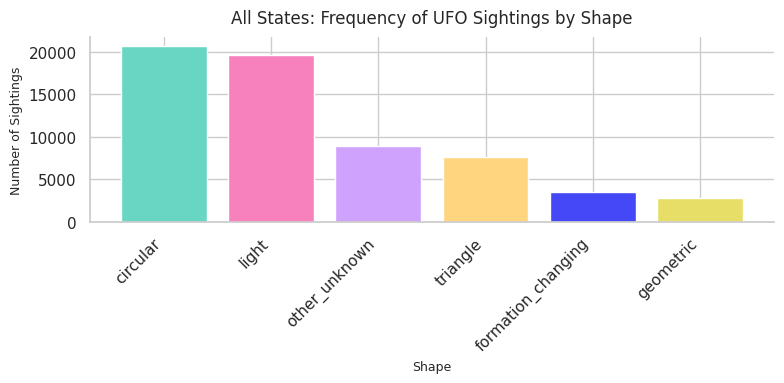

In [115]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Define the specific colors for each shape
# Define the specific colors for each shape
shape_colors = {
    'circular': '#69d6c4',
    'light': '#f781bd',
    'triangle': '#FFD580',
    'formation_changing': '#4548f7',
    'geometric': '#e6de67',
    'other_unknown': '#CEA2FD'
}

# Calculate the count of sightings for each shape
shape_counts = revised_cleaned_us_ufo_df['shape'].value_counts()

# Set Seaborn theme for better aesthetics
sns.set_theme(style="whitegrid")

# Get colors in the same order as the sorted shape_counts
colors = [shape_colors[shape] for shape in shape_counts.index if shape in shape_colors] # check shape exists in the shape_colors to avoid KeyError

# Create a bar chart with custom colors and sorted values
plt.figure(figsize=(8, 4))
plt.bar(shape_counts.index, shape_counts.values, color=colors)

# Set labels and title
plt.xlabel('Shape', fontsize=9)
plt.ylabel('Number of Sightings', fontsize=9)  # Changed ylabel to reflect the count
plt.title('All States: Frequency of UFO Sightings by Shape', fontsize=12, pad=10)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Remove top and right spines for a cleaner look
sns.despine()

# Adjust layout to prevent labels from overlapping
plt.tight_layout()

# Show the plot
plt.show()

In [116]:
print(shape_counts)


shape
circular              20681
light                 19589
other_unknown          8948
triangle               7576
formation_changing     3546
geometric              2759
Name: count, dtype: int64


In [117]:
print(shape_counts / shape_counts.sum() * 100)


shape
circular              32.775480
light                 31.044866
other_unknown         14.180890
triangle              12.006529
formation_changing     5.619740
geometric              4.372494
Name: count, dtype: float64


In [119]:
# Print average_durations totals
print(average_durations)

shape
light                 11585.283897
other_unknown          5188.330420
circular               2474.520888
formation_changing     1520.645736
triangle               1345.499388
geometric               995.131751
Name: duration_seconds, dtype: float64


In [120]:
# Print average_durations percentages
print(average_durations / average_durations.sum() * 100)


shape
light                 50.132318
other_unknown         22.451157
circular              10.707849
formation_changing     6.580201
triangle               5.822300
geometric              4.306175
Name: duration_seconds, dtype: float64


In [121]:
# Print average_durations percentages
all_states_shape_duration = (average_durations / average_durations.sum() * 100)
print(all_states_shape_duration)

shape
light                 50.132318
other_unknown         22.451157
circular              10.707849
formation_changing     6.580201
triangle               5.822300
geometric              4.306175
Name: duration_seconds, dtype: float64


In [122]:
revised_cleaned_us_ufo_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,51175566.48,2474.520888
1,1920-06-11 21:00:00,1920,in,60.0,other_unknown,46425180.60,5188.330420
2,1925-12-28 18:00:00,1925,il,60.0,circular,51175566.48,2474.520888
3,1929-07-05 14:00:00,1929,or,60.0,circular,51175566.48,2474.520888
4,1931-02-15 14:00:00,1931,co,60.0,circular,51175566.48,2474.520888


In [123]:
formated_revised_cleaned_us_ufo_df = revised_cleaned_us_ufo_df.copy()
formated_revised_cleaned_us_ufo_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,51175566.48,2474.520888
1,1920-06-11 21:00:00,1920,in,60.0,other_unknown,46425180.60,5188.330420
2,1925-12-28 18:00:00,1925,il,60.0,circular,51175566.48,2474.520888
3,1929-07-05 14:00:00,1929,or,60.0,circular,51175566.48,2474.520888
4,1931-02-15 14:00:00,1931,co,60.0,circular,51175566.48,2474.520888


In [124]:
# In revised_cleaned_us_ufo_df['shape'], change the unique values as follows circular=Circular, light=Light, other_unknown=Other/Unknown, triangle=Triangler, formation_changing=Formation/Changing, geometric=Geometric
formated_revised_cleaned_us_ufo_df['shape'] = formated_revised_cleaned_us_ufo_df['shape'].replace({'circular': 'Circular', 'light': 'Light', 'other_unknown': 'Other/Unknown', 'triangle': 'Triangler', 'formation_changing': 'Formation/Changing', 'geometric': 'Geometric'})
formated_revised_cleaned_us_ufo_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,Circular,51175566.48,2474.520888
1,1920-06-11 21:00:00,1920,in,60.0,Other/Unknown,46425180.60,5188.330420
2,1925-12-28 18:00:00,1925,il,60.0,Circular,51175566.48,2474.520888
3,1929-07-05 14:00:00,1929,or,60.0,Circular,51175566.48,2474.520888
4,1931-02-15 14:00:00,1931,co,60.0,Circular,51175566.48,2474.520888


In [125]:
formated_revised_cleaned_us_ufo_df['shape'].value_counts()

,count
shape,
Circular,20681
Light,19589
Other/Unknown,8948
Triangler,7576
Formation/Changing,3546
Geometric,2759


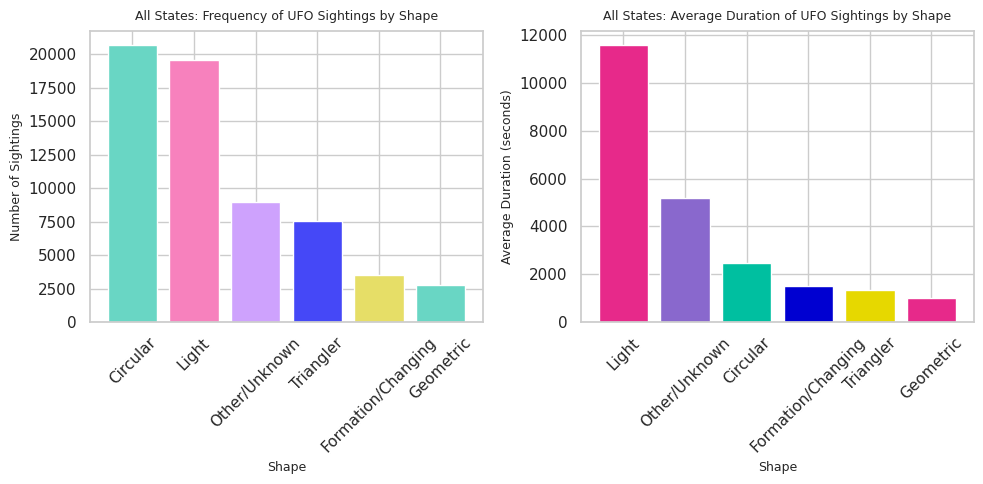

In [126]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Define the specific colors for each shape for both plots
shape_colors_count = {
   'Circular': '#69d6c4',
   'Light': '#f781bd',
   'Triangle': '#FFD580',
   'Formation/Changing': '#4548f7',
   'Geometric': '#e6de67',
   'Other/Unknown': '#CEA2FD'
}

shape_colors_duration = {
   'Circular': '#00bfa0',
   'Light': '#e7298a',
   'Triangle': '#ffa300',
   'Formation/Changing': '#0000D1',
   'Geometric': '#e6d800',
   'Other/Unknown': '#8968CD'
}

# Assuming 'revised_cleaned_us_ufo_df' DataFrame already exists
# Sample DataFrame structure (use your own data here):
# revised_cleaned_us_ufo_df = pd.DataFrame({
#    'shape': ['circular', 'light', 'triangle', 'formation_changing', 'geometric', 'other_unknown', 'circular'],
#    'duration_seconds': [300, 400, 500, 200, 450, 300, 600]
#})

# Calculate the count of sightings for each shape
shape_counts = formated_revised_cleaned_us_ufo_df['shape'].value_counts()

# Calculate average duration for each shape
average_durations = formated_revised_cleaned_us_ufo_df.groupby('shape')['duration_seconds'].mean()

# Sort shapes by count and average duration
shape_counts = shape_counts.sort_values(ascending=False)
average_durations = average_durations.sort_values(ascending=False)

# Set Seaborn theme for better aesthetics
sns.set_theme(style="whitegrid")

# Create subplots to show data by counts and average duration side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns

# ------------------ Plot 1: Number of Sightings ------------------

# Get colors in the same order as the sorted shape_counts for Plot 1
colors_count = [shape_colors_count[shape] for shape in shape_counts.index if shape in shape_colors_count]

# Plot the number of sightings on the first subplot
ax1.bar(shape_counts.index, shape_counts.values, color=colors_count)
ax1.set_xlabel('Shape', fontsize=9)
ax1.set_ylabel('Number of Sightings', fontsize=9)
ax1.set_title('All States: Frequency of UFO Sightings by Shape', fontsize=9, pad=8)

# Rotate x-axis labels for better readability
ax1.tick_params(axis='x', rotation=45)

# ------------------ Plot 2: Average Duration ------------------

# Get colors in the same order as the sorted average_durations for Plot 2
colors_duration = [shape_colors_duration[shape] for shape in average_durations.index if shape in shape_colors_duration]

# Plot the average duration on the second subplot
ax2.bar(average_durations.index, average_durations.values, color=colors_duration)
ax2.set_xlabel('Shape', fontsize=9)
ax2.set_ylabel('Average Duration (seconds)', fontsize=9)
ax2.set_title('All States: Average Duration of UFO Sightings by Shape', fontsize=9, pad=8)

# Rotate x-axis labels for better readability
ax2.tick_params(axis='x', rotation=45)

# Adjust layout to prevent labels from overlapping
plt.tight_layout()

# Display the plot
plt.show()


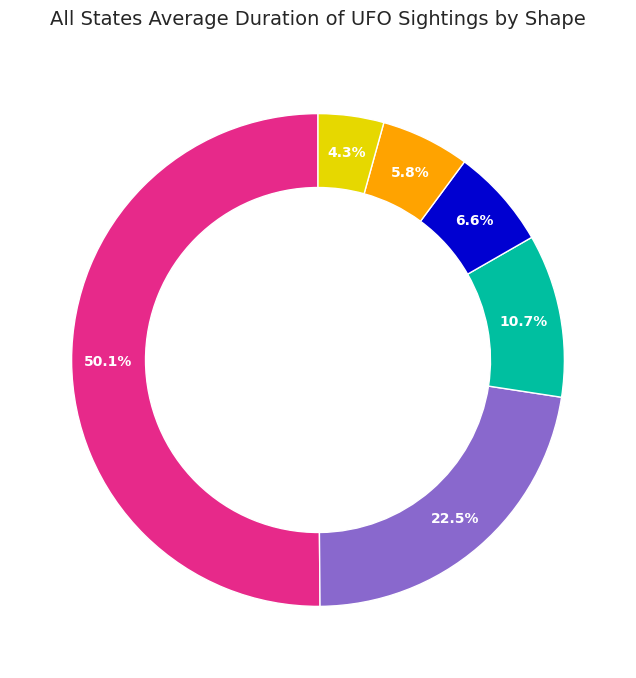

In [127]:
import matplotlib.pyplot as plt

# Create a figure for the pie chart
fig, ax = plt.subplots(figsize=(8, 8))

# Plot the pie chart with percentage values outside the chart
wedges, texts, autotexts = ax.pie(
    all_states_shape_duration,
    colors=[shape_colors[shape] for shape in all_states_shape_duration.index],  # Apply colors
    autopct='%1.1f%%',  # Percentage values
    startangle=90,  # Start angle for better alignment
    wedgeprops=dict(width=0.3),  # Set the width of wedges for better label positioning
    pctdistance=0.85  # Push the percentage text outward
)

# Set the text for labels outside the pie chart
for text in texts:
    text.set_fontsize(12)
    text.set_horizontalalignment('center')

# Set the percentage values (autotexts) outside the pie chart
for autotext in autotexts:
    autotext.set_color('white')  # Change color of percentages (you can change this as needed)
    autotext.set_fontsize(10)
    autotext.set_fontweight('bold')

# Set title and remove y-axis label (for cleaner look)
ax.set_title('All States Average Duration of UFO Sightings by Shape', fontsize=14, pad=20)
ax.set_ylabel('')

# Show the plot
plt.show()


## Sum Duration: All States by Specific Shape

### Revised all States by Light Shape

In [129]:
all_states_light_df = revised_cleaned_us_ufo_df.loc[revised_cleaned_us_ufo_df['shape'] == 'light']
all_states_light_df = all_states_light_df.sort_values(by='datetime')

all_states_light_df.head()


,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08,11585.283897
9,1939-06-01 20:00:00,1939,al,300.0,light,2.269441e+08,11585.283897
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08,11585.283897
30,1946-06-30 21:00:00,1946,wa,30.0,light,2.269441e+08,11585.283897
32,1946-09-30 20:30:00,1946,az,40.0,light,2.269441e+08,11585.283897


In [130]:
all_states_light_by_year = all_states_light_df[['year', 'duration_seconds']]
all_states_light_by_year.head()

,year,duration_seconds
8,1937,600.0
9,1939,300.0
19,1945,300.0
30,1946,30.0
32,1946,40.0


In [131]:
# group top_us_circular_by_year by the 'year' column
all_states_light_by_year_grouped = all_states_light_by_year.groupby('year').sum()
all_states_light_by_year_grouped.head()

,duration_seconds
year,
1937,600.0
1939,300.0
1945,300.0
1946,70.0
1947,300.0


<ipython-input-132-b273a4c8b88e>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


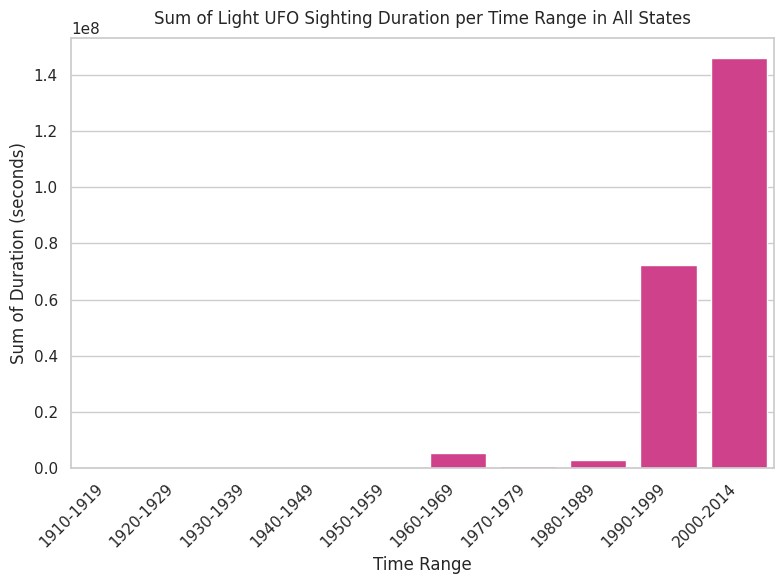

In [132]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = all_states_light_by_year_grouped

df = pd.DataFrame(data)
# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


# Plot the results using seaborn
plt.figure(figsize=(8, 6))
# Change the palette argument to use the color directly with 'color'
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#e7298a')
# Alternatively, if you want to use a palette, use a valid palette name like 'pastel'
# sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='pastel')

# Set the title and labels
plt.title('Sum of Light UFO Sighting Duration per Time Range in All States', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

<ipython-input-133-0540c4e8d80d>:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()


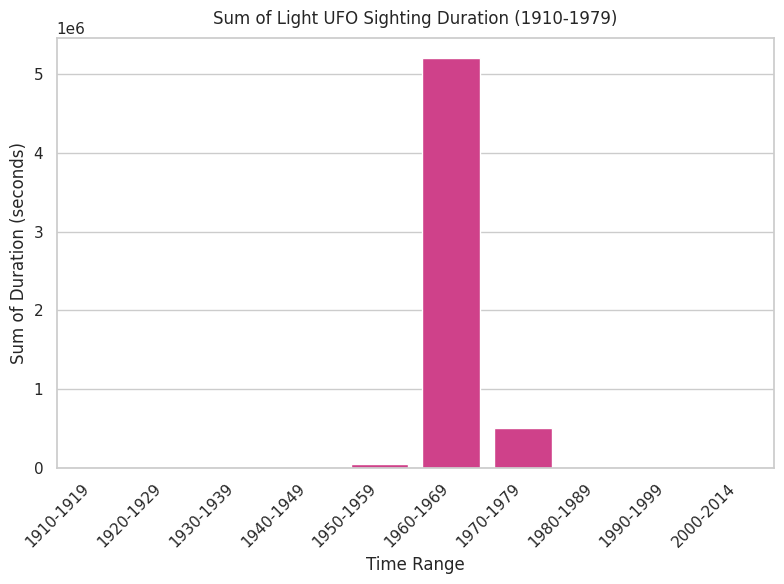

In [133]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create the data as a pandas DataFrame
df = pd.DataFrame(all_states_light_by_year_grouped)

# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Filter the DataFrame to only include years between 1910 and 1979
df_filtered = df[df['TimeRange'].isin(['1910-1919', '1920-1929', '1930-1939',
                                       '1940-1949', '1950-1959', '1960-1969', '1970-1979'])]

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()

# Plot the results using seaborn
plt.figure(figsize=(8, 6))
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#e7298a')

# Set the title and labels
plt.title('Sum of Light UFO Sighting Duration (1910-1979)', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Adjust layout to ensure the plot is not clipped
plt.tight_layout()

# Display the plot
plt.show()


<ipython-input-134-a3e789ef68c9>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['year'].count().reset_index()


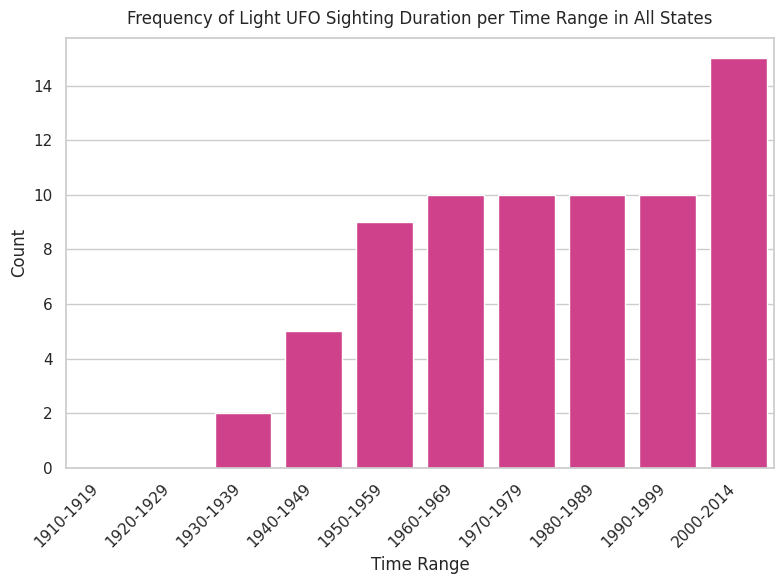

In [134]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = all_states_light_by_year_grouped

df = pd.DataFrame(data)
# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['year'].count().reset_index()


# Plot the results using seaborn
plt.figure(figsize=(8, 6))
# Change the palette argument to use the color directly with 'color'
sns.barplot(x='TimeRange', y='year', data=grouped, color='#e7298a')
# Alternatively, if you want to use a palette, use a valid palette name like 'pastel'
# sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='pastel')

# Set the title and labels
plt.title('Frequency of Light UFO Sighting Duration per Time Range in All States', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Count', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

<ipython-input-135-67b48ee82063>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['duration_seconds'].mean().reset_index()


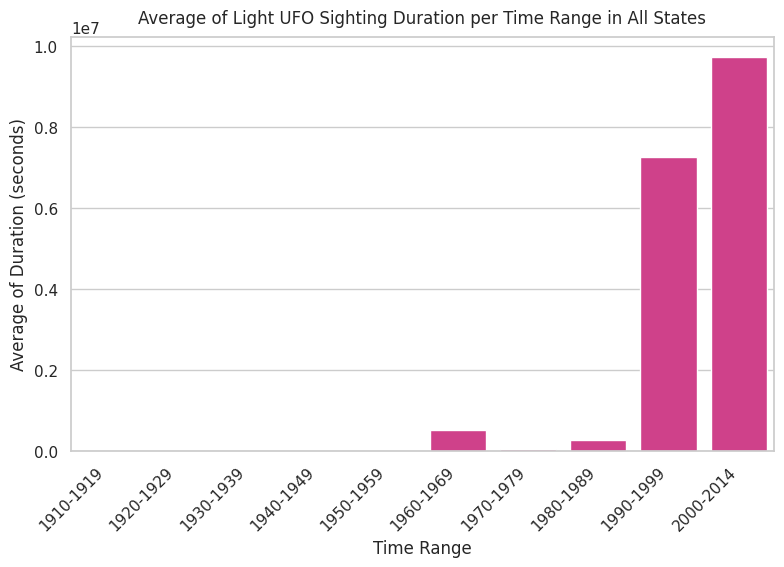

In [135]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = all_states_light_by_year_grouped

df = pd.DataFrame(data)
# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['duration_seconds'].mean().reset_index()


# Plot the results using seaborn
plt.figure(figsize=(8, 6))
# Change the palette argument to use the color directly with 'color'
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#e7298a')
# Alternatively, if you want to use a palette, use a valid palette name like 'pastel'
# sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='pastel')

# Set the title and labels
plt.title('Average of Light UFO Sighting Duration per Time Range in All States', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Average of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

### Revised all States by other_unknown Shape

In [136]:
all_states_other_unknown_df = revised_cleaned_us_ufo_df.loc[revised_cleaned_us_ufo_df['shape'] == 'other_unknown']
all_states_other_unknown_df = all_states_other_unknown_df.sort_values(by='datetime')

all_states_other_unknown_df.head()


,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
1,1920-06-11 21:00:00,1920,in,60.0,other_unknown,46425180.6,5188.33042
13,1942-06-01 22:30:00,1942,ga,180.0,other_unknown,46425180.6,5188.33042
33,1947-01-10 20:00:00,1947,tx,4.0,other_unknown,46425180.6,5188.33042
35,1947-04-15 14:00:00,1947,fl,420.0,other_unknown,46425180.6,5188.33042
38,1947-06-13 20:18:00,1947,pa,600.0,other_unknown,46425180.6,5188.33042


In [137]:
all_states_other_unknown_by_year = all_states_other_unknown_df[['year', 'duration_seconds']]
all_states_other_unknown_by_year.head()

,year,duration_seconds
1,1920,60.0
13,1942,180.0
33,1947,4.0
35,1947,420.0
38,1947,600.0


In [138]:
# group top_us_circular_by_year by the 'year' column
all_states_other_unknown_by_year_grouped = all_states_other_unknown_by_year.groupby('year').sum()
all_states_other_unknown_by_year_grouped.head()

,duration_seconds
year,
1920,60.0
1942,180.0
1947,4934.0
1949,1840.0
1950,660.0


<ipython-input-139-f068771664a9>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


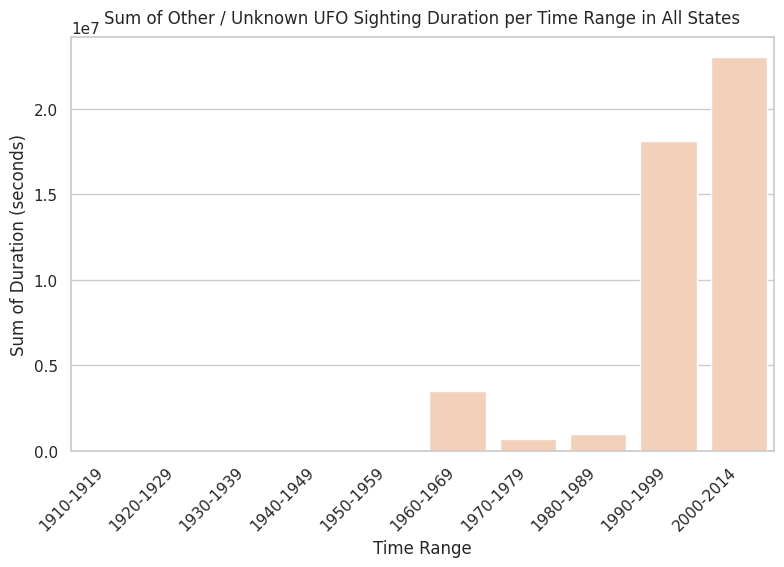

In [139]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = all_states_other_unknown_by_year_grouped

df = pd.DataFrame(data)
# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


# Plot the results using seaborn
plt.figure(figsize=(8, 6))
# Change the palette argument to use the color directly with 'color'
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#FBCEB1')
# Alternatively, if you want to use a palette, use a valid palette name like 'pastel'
# sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='pastel')

# Set the title and labels
plt.title('Sum of Other / Unknown UFO Sighting Duration per Time Range in All States', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

<ipython-input-140-150a943a16f0>:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()


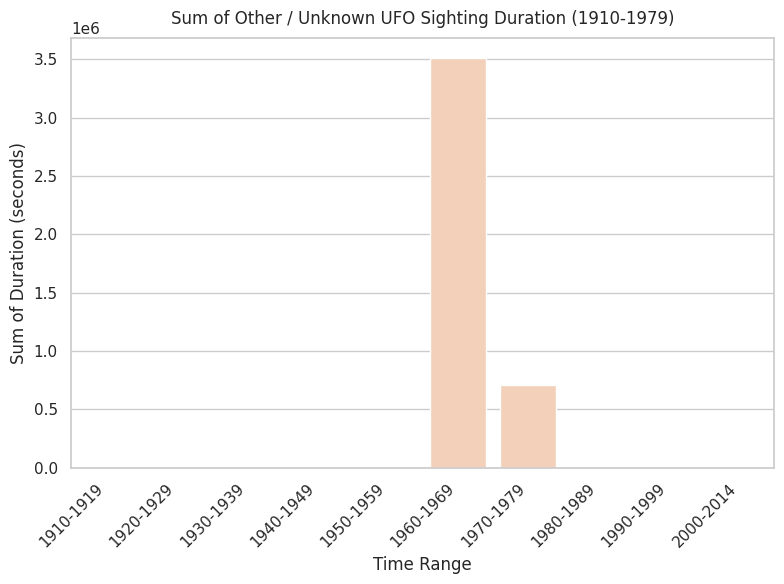

In [140]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create the data as a pandas DataFrame
df = pd.DataFrame(all_states_other_unknown_by_year_grouped)

# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Filter the DataFrame to only include years between 1910 and 1979
df_filtered = df[df['TimeRange'].isin(['1910-1919', '1920-1929', '1930-1939',
                                       '1940-1949', '1950-1959', '1960-1969', '1970-1979'])]

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()

# Plot the results using seaborn
plt.figure(figsize=(8, 6))
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#FBCEB1')

# Set the title and labels
plt.title('Sum of Other / Unknown UFO Sighting Duration (1910-1979)', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Adjust layout to ensure the plot is not clipped
plt.tight_layout()

# Display the plot
plt.show()


### Revised all States by circular Shape

In [141]:
all_states_circular_df = revised_cleaned_us_ufo_df.loc[revised_cleaned_us_ufo_df['shape'] == 'circular']
all_states_circular_df = all_states_circular_df.sort_values(by='datetime')

all_states_circular_df.head()


,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,51175566.48,2474.520888
2,1925-12-28 18:00:00,1925,il,60.0,circular,51175566.48,2474.520888
3,1929-07-05 14:00:00,1929,or,60.0,circular,51175566.48,2474.520888
4,1931-02-15 14:00:00,1931,co,60.0,circular,51175566.48,2474.520888
5,1931-06-01 13:00:00,1931,ks,1800.0,circular,51175566.48,2474.520888


In [142]:
all_states_circular_by_year = all_states_circular_df[['year', 'duration_seconds']]
all_states_circular_by_year.head()

,year,duration_seconds
0,1910,120.0
2,1925,60.0
3,1929,60.0
4,1931,60.0
5,1931,1800.0


In [143]:
# group top_us_circular_by_year by the 'year' column
all_states_circular_by_year_grouped = all_states_circular_by_year.groupby('year').sum()
all_states_circular_by_year_grouped.head()

,duration_seconds
year,
1910,120.0
1925,60.0
1929,60.0
1931,1860.0
1934,5.0


<ipython-input-144-32e5205f4279>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


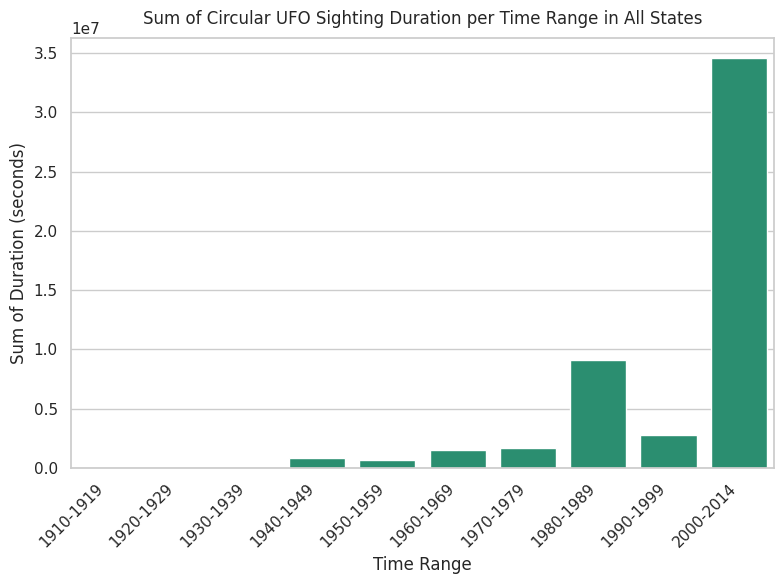

In [144]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = all_states_circular_by_year_grouped

df = pd.DataFrame(data)
# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


# Plot the results using seaborn
plt.figure(figsize=(8, 6))
# Change the palette argument to use the color directly with 'color'
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#1b9e77')
# Alternatively, if you want to use a palette, use a valid palette name like 'pastel'
# sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='pastel')

# Set the title and labels
plt.title('Sum of Circular UFO Sighting Duration per Time Range in All States', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

<ipython-input-145-7906c57772df>:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()


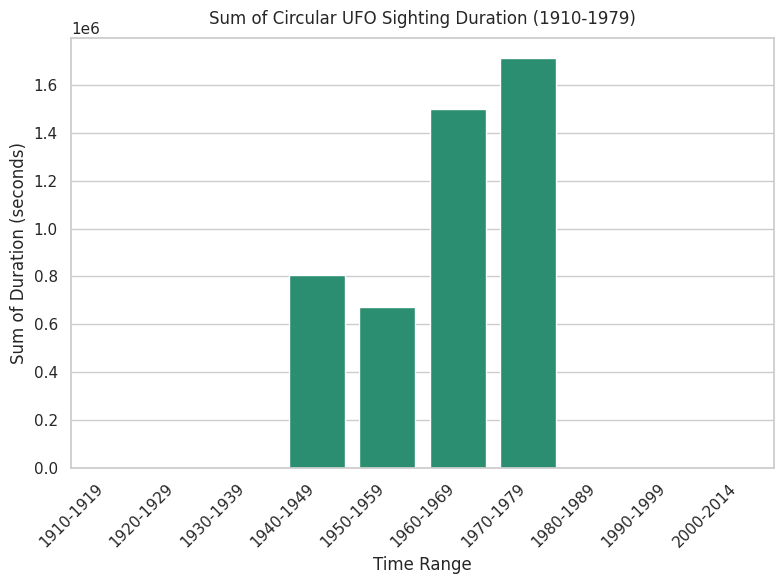

In [145]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create the data as a pandas DataFrame
df = pd.DataFrame(all_states_circular_by_year_grouped)

# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Filter the DataFrame to only include years between 1910 and 1979
df_filtered = df[df['TimeRange'].isin(['1910-1919', '1920-1929', '1930-1939',
                                       '1940-1949', '1950-1959', '1960-1969', '1970-1979'])]

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()

# Plot the results using seaborn
plt.figure(figsize=(8, 6))
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#1b9e77')

# Set the title and labels
plt.title('Sum of Circular UFO Sighting Duration (1910-1979)', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Adjust layout to ensure the plot is not clipped
plt.tight_layout()

# Display the plot
plt.show()


### Revised all States by triangle Shape

In [146]:
all_states_triangle_df = revised_cleaned_us_ufo_df.loc[revised_cleaned_us_ufo_df['shape'] == 'triangle']
all_states_triangle_df = all_states_triangle_df.sort_values(by='datetime')

all_states_triangle_df.head()


,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
57,1947-07-15 21:00:00,1947,ca,240.0,triangle,10193503.36,1345.499388
119,1952-04-15 16:00:00,1952,tx,120.0,triangle,10193503.36,1345.499388
123,1952-06-15 21:00:00,1952,fl,30.0,triangle,10193503.36,1345.499388
153,1953-04-01 15:00:00,1953,ma,2.0,triangle,10193503.36,1345.499388
167,1953-07-17 22:00:00,1953,in,1800.0,triangle,10193503.36,1345.499388


In [147]:
all_states_triangle_by_year = all_states_triangle_df[['year', 'duration_seconds']]
all_states_triangle_by_year.head()

,year,duration_seconds
57,1947,240.0
119,1952,120.0
123,1952,30.0
153,1953,2.0
167,1953,1800.0


In [148]:
# group top_us_circular_by_year by the 'year' column
all_states_triangle_by_year_grouped = all_states_triangle_by_year.groupby('year').sum()
all_states_triangle_by_year_grouped.head()

,duration_seconds
year,
1947,240.0
1952,150.0
1953,1802.0
1954,195.0
1957,3603.0


<ipython-input-149-8bfd68908333>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


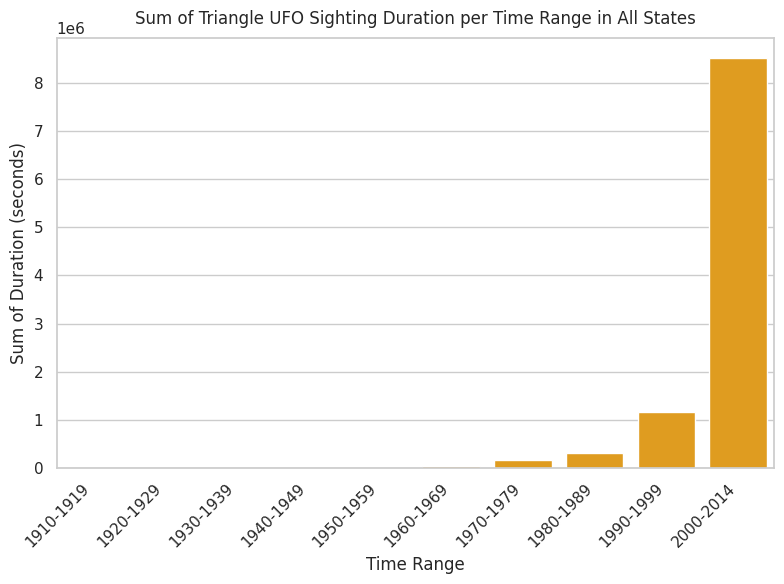

In [149]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = all_states_triangle_by_year_grouped

df = pd.DataFrame(data)
# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


# Plot the results using seaborn
plt.figure(figsize=(8, 6))
# Change the palette argument to use the color directly with 'color'
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#ffa500')
# Alternatively, if you want to use a palette, use a valid palette name like 'pastel'
# sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='pastel')

# Set the title and labels
plt.title('Sum of Triangle UFO Sighting Duration per Time Range in All States', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

<ipython-input-150-56e9531989d5>:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()


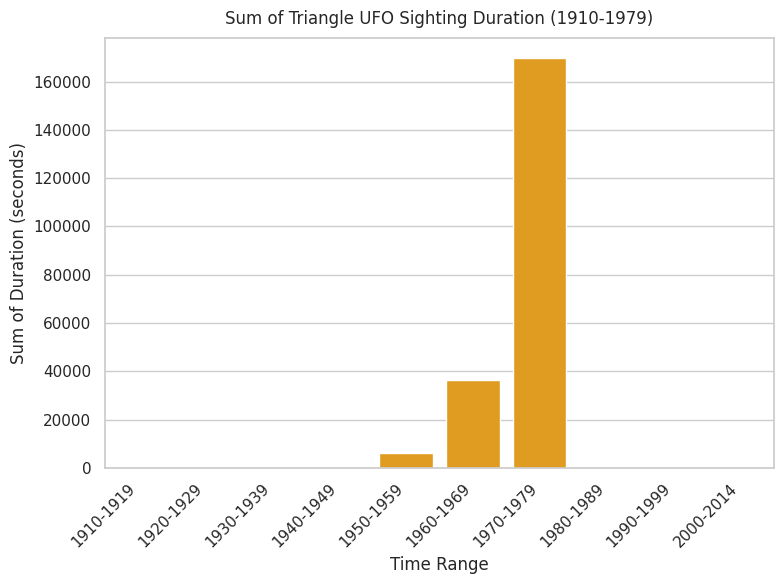

In [150]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create the data as a pandas DataFrame
df = pd.DataFrame(all_states_triangle_by_year_grouped)

# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Filter the DataFrame to only include years between 1910 and 1979
df_filtered = df[df['TimeRange'].isin(['1910-1919', '1920-1929', '1930-1939',
                                       '1940-1949', '1950-1959', '1960-1969', '1970-1979'])]

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()

# Plot the results using seaborn
plt.figure(figsize=(8, 6))
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#ffa500')

# Set the title and labels
plt.title('Sum of Triangle UFO Sighting Duration (1910-1979)', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Adjust layout to ensure the plot is not clipped
plt.tight_layout()

# Display the plot
plt.show()


### Revised all States by geometric Shape

In [151]:
all_states_geometric_df = revised_cleaned_us_ufo_df.loc[revised_cleaned_us_ufo_df['shape'] == 'geometric']
all_states_geometric_df = all_states_geometric_df.sort_values(by='datetime')

all_states_geometric_df.head()


,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
14,1942-07-15 01:00:00,1942,tn,120.0,geometric,2745568.5,995.131751
15,1943-10-15 11:00:00,1943,ky,1800.0,geometric,2745568.5,995.131751
179,1954-05-15 12:00:00,1954,or,120.0,geometric,2745568.5,995.131751
257,1956-06-30 13:00:00,1956,mo,300.0,geometric,2745568.5,995.131751
268,1956-10-01 19:00:00,1956,nh,300.0,geometric,2745568.5,995.131751


In [152]:
all_states_geometric_by_year = all_states_geometric_df[['year', 'duration_seconds']]
all_states_geometric_by_year.head()

,year,duration_seconds
14,1942,120.0
15,1943,1800.0
179,1954,120.0
257,1956,300.0
268,1956,300.0


In [153]:
# group top_us_circular_by_year by the 'year' column
all_states_geometric_by_year_grouped = all_states_geometric_by_year.groupby('year').sum()
all_states_geometric_by_year_grouped.head()

,duration_seconds
year,
1942,120.0
1943,1800.0
1954,120.0
1956,600.0
1957,1040.0


<ipython-input-154-1ac0ee6d85db>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


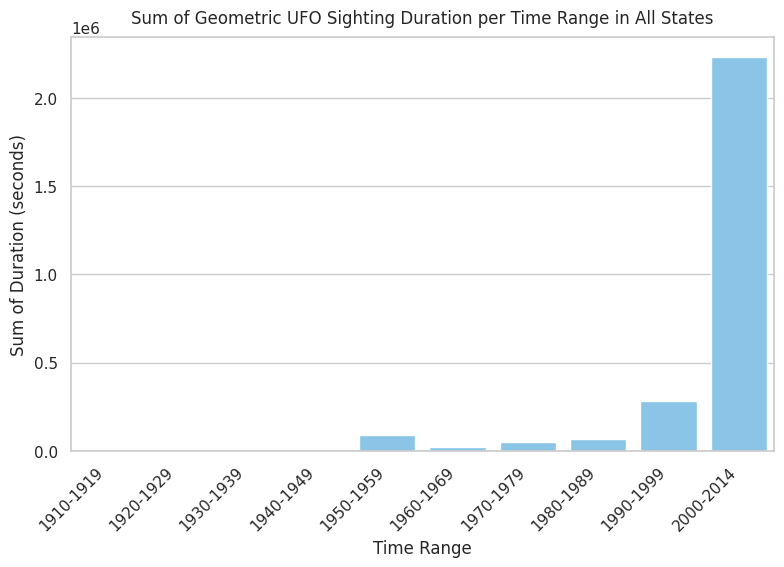

In [154]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = all_states_geometric_by_year_grouped

df = pd.DataFrame(data)
# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


# Plot the results using seaborn
plt.figure(figsize=(8, 6))
# Change the palette argument to use the color directly with 'color'
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#7BC8F6')
# Alternatively, if you want to use a palette, use a valid palette name like 'pastel'
# sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='pastel')

# Set the title and labels
plt.title('Sum of Geometric UFO Sighting Duration per Time Range in All States', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

<ipython-input-155-0a4daee95b02>:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()


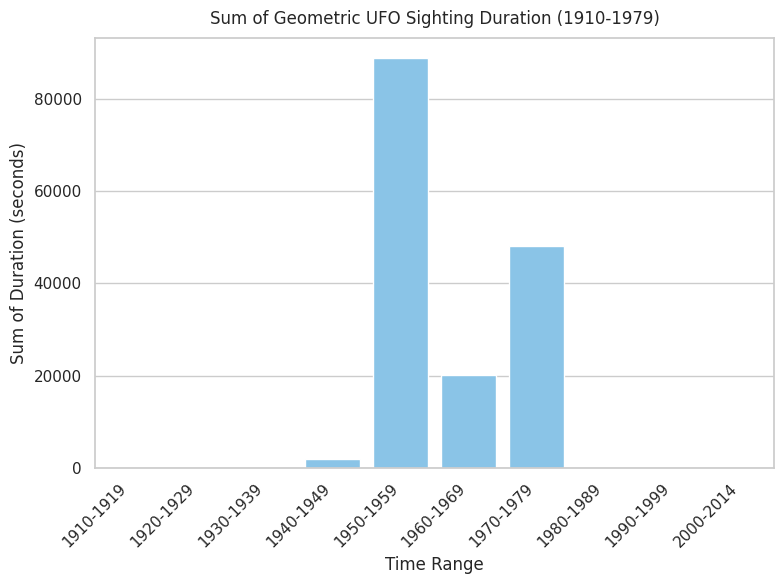

In [155]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create the data as a pandas DataFrame
df = pd.DataFrame(all_states_geometric_by_year_grouped)

# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Filter the DataFrame to only include years between 1910 and 1979
df_filtered = df[df['TimeRange'].isin(['1910-1919', '1920-1929', '1930-1939',
                                       '1940-1949', '1950-1959', '1960-1969', '1970-1979'])]

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()

# Plot the results using seaborn
plt.figure(figsize=(8, 6))
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#7BC8F6')

# Set the title and labels
plt.title('Sum of Geometric UFO Sighting Duration (1910-1979)', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Adjust layout to ensure the plot is not clipped
plt.tight_layout()

# Display the plot
plt.show()


### Revised all States by formation_changing	 Shape

In [156]:
all_states_formation_changing_df = revised_cleaned_us_ufo_df.loc[revised_cleaned_us_ufo_df['shape'] == 'formation_changing']
all_states_formation_changing_df = all_states_formation_changing_df.sort_values(by='datetime')

all_states_formation_changing_df.head()


,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5392209.78,1520.645736
45,1947-07-01 20:00:00,1947,wa,120.0,formation_changing,5392209.78,1520.645736
53,1947-07-15 12:00:00,1947,il,300.0,formation_changing,5392209.78,1520.645736
76,1949-07-01 16:00:00,1949,al,60.0,formation_changing,5392209.78,1520.645736
195,1954-07-07 22:00:00,1954,sc,600.0,formation_changing,5392209.78,1520.645736


In [157]:
all_states_formation_changing_by_year = all_states_formation_changing_df[['year', 'duration_seconds']]
all_states_formation_changing_by_year.head()

,year,duration_seconds
21,1945,180.0
45,1947,120.0
53,1947,300.0
76,1949,60.0
195,1954,600.0


In [158]:
# group top_us_circular_by_year by the 'year' column
all_states_formation_changing_by_year_grouped = all_states_formation_changing_by_year.groupby('year').sum()
all_states_formation_changing_by_year_grouped.head()

,duration_seconds
year,
1945,180.0
1947,420.0
1949,60.0
1954,600.0
1956,240.0


<ipython-input-159-62ee2ecbef51>:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


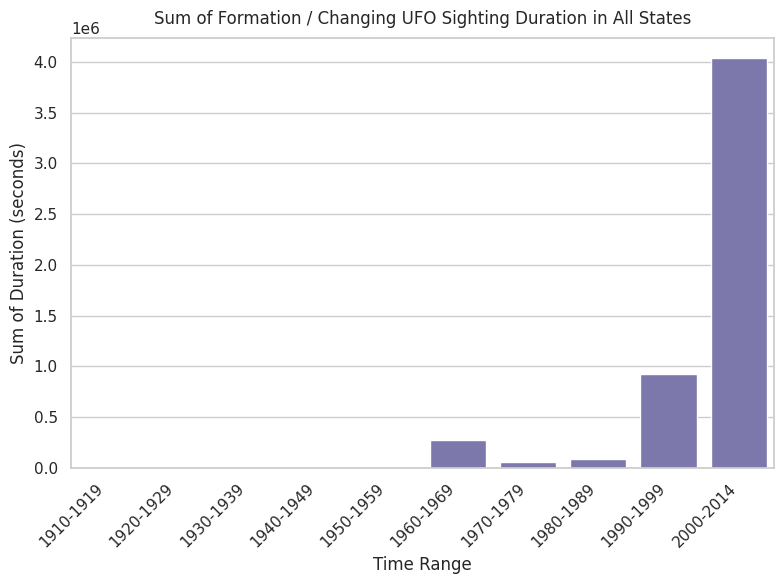

In [159]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = all_states_formation_changing_by_year_grouped

df = pd.DataFrame(data)
# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()


# Plot the results using seaborn
plt.figure(figsize=(8, 6))
# Change the palette argument to use the color directly with 'color'
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#7570b3')
# Alternatively, if you want to use a palette, use a valid palette name like 'pastel'
# sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='pastel')

# Set the title and labels
plt.title('Sum of Formation / Changing UFO Sighting Duration in All States', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()

<ipython-input-160-6cf4437f0161>:24: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()


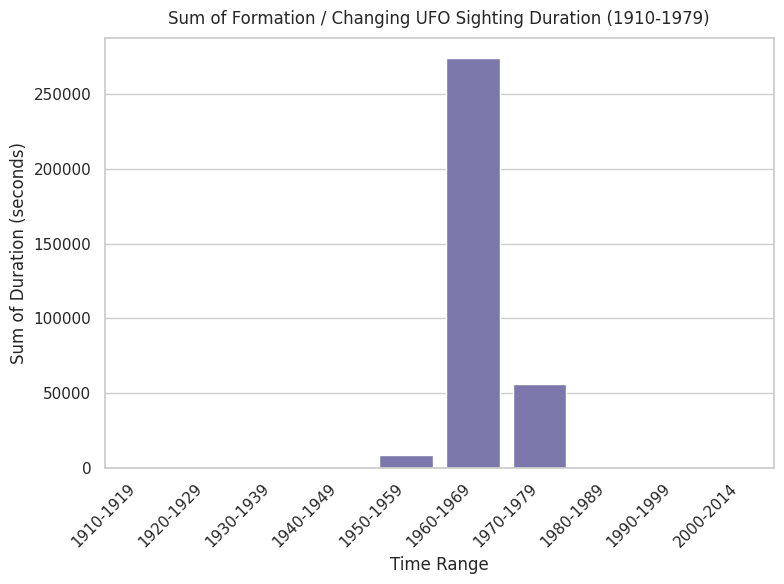

In [160]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Create the data as a pandas DataFrame
df = pd.DataFrame(all_states_formation_changing_by_year_grouped)

# Reset the index to make 'year' a column again
df = df.reset_index()

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Filter the DataFrame to only include years between 1910 and 1979
df_filtered = df[df['TimeRange'].isin(['1910-1919', '1920-1929', '1930-1939',
                                       '1940-1949', '1950-1959', '1960-1969', '1970-1979'])]

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df_filtered.groupby('TimeRange')['duration_seconds'].sum().reset_index()

# Plot the results using seaborn
plt.figure(figsize=(8, 6))
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, color='#7570b3')

# Set the title and labels
plt.title('Sum of Formation / Changing UFO Sighting Duration (1910-1979)', fontsize=12, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Adjust layout to ensure the plot is not clipped
plt.tight_layout()

# Display the plot
plt.show()


## 3.2 Top 10 States by Shape

In [161]:
# make a copy of revised_cleaned_us_ufo with only the rows that have the following valriables in the revised_cleaned_us_ufo[state] column: 'az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa'
top_us_shape_df = revised_cleaned_us_ufo_df[revised_cleaned_us_ufo_df['state'].isin(['az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa'])]
top_us_shape_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,5.117557e+07,2474.520888
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08,11585.283897
16,1944-01-01 12:00:00,1944,ca,180.0,circular,5.117557e+07,2474.520888
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08,11585.283897
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5.392210e+06,1520.645736


In [162]:
# make a copy of revised_cleaned_us_ufo with only the rows that have the following valriables in the revised_cleaned_us_ufo[state] column: 'az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa'
top_ten_us_shape_df = revised_cleaned_us_ufo_df[revised_cleaned_us_ufo_df['state'].isin(['az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa'])]
top_ten_us_shape_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,5.117557e+07,2474.520888
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08,11585.283897
16,1944-01-01 12:00:00,1944,ca,180.0,circular,5.117557e+07,2474.520888
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08,11585.283897
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5.392210e+06,1520.645736


In [163]:
# Get the value counts for the column 'shape' in top_us_shape_df
top_us_shape_df['shape'].value_counts()

,count
shape,
circular,8824
light,8417
other_unknown,3845
triangle,3149
formation_changing,1627
geometric,1179


In [166]:
top_ten_us_shape_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,5.117557e+07,2474.520888
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08,11585.283897
16,1944-01-01 12:00:00,1944,ca,180.0,circular,5.117557e+07,2474.520888
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08,11585.283897
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5.392210e+06,1520.645736


In [167]:
#print the unique values in top_ten_us_shape_df [shape] Column
print(top_ten_us_shape_df['shape'].unique())

['circular' 'light' 'formation_changing' 'other_unknown' 'triangle'
 'geometric']


In [168]:
updated_top_ten_us_shape_df = top_ten_us_shape_df.replace({'shape': {'light': 'Light', 'other_unknown': 'Other/Unknown', 'circular': 'Circular', 'geometric': 'Geometric', 'formation_changing': 'Formation/Changing', 'triangle': 'Triangle'}})
updated_top_ten_us_shape_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,Circular,5.117557e+07,2474.520888
8,1937-08-15 21:00:00,1937,ca,600.0,Light,2.269441e+08,11585.283897
16,1944-01-01 12:00:00,1944,ca,180.0,Circular,5.117557e+07,2474.520888
19,1945-06-01 13:30:00,1945,fl,300.0,Light,2.269441e+08,11585.283897
21,1945-07-10 01:30:00,1945,va,180.0,Formation/Changing,5.392210e+06,1520.645736


In [169]:
# Import necessary libraries
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors = {
    'Circular': '#69d6c4',
    'Light': '#f781bd',
    'Triangle': '#FFD580',
    'Formation/Changing': '#4548f7',
    'Geometric': '#e6de67',
    'Other/Unknown': '#CEA2FD'
}

# Desired order of shapes
# shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']
shape_order = ['Light', 'Other/Unknown', 'Circular', 'Geometric', 'Formation/Changing', 'Triangle']

# Create a chart to visualize the frequency of UFO shapes by state
chart = alt.Chart(updated_top_ten_us_shape_df).mark_bar().encode(
    x='state:N',  # State as a nominal value
    y='count()',  # Count of occurrences
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Frequency of UFO Shapes by Top Ten States'
)

# Display the chart
chart

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [170]:
# Import necessary libraries
import altair as alt
import pandas as pd

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order
shape_colors_duration = {
   'Circular': '#00bfa0',
   'Light': '#e7298a',
   'Triangle': '#ffa300',
   'Formation/Changing': '#0000D1',
   'Geometric': '#e6d800',
   'Other/Unknown': '#8968CD'
}

# Desired order of shapes
# shape_order = ['other_unknown', 'geometric', 'formation_changing', 'triangle', 'light', 'circular']
shape_order = ['Light', 'Other/Unknown', 'Circular', 'Geometric', 'Formation/Changing', 'Triangle']

# Create a chart to visualize the frequency of UFO shapes by state
chart = alt.Chart(updated_top_ten_us_shape_df).mark_bar().encode(
    x='state:N',  # State as a nominal value
    y='mean(duration_seconds)',  # mean of occurrences
    color=alt.Color(
        'shape:N',  # Shape as a nominal value
        scale=alt.Scale(domain=shape_order,  # Specify the order of shapes
                        range=[shape_colors_duration[shape] for shape in shape_order])  # Specify the colors
    )
).properties(
    title='Duration of UFO Shapes by Top Ten States'
)

# Display the chart
chart

/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.Chart(...)

In [171]:
# Plot 'Frequency of UFO Shapes by Top Ten States' and 'Duration of UFO Shapes by Top Ten States' to print out side by side

import altair as alt

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order for frequency plot
shape_colors_freq = {
   'Circular': '#69d6c4',
   'Light': '#f781bd',
   'Triangle': '#FFD580',
   'Formation/Changing': '#4548f7',
   'Geometric': '#e6de67',
   'Other/Unknown': '#CEA2FD'
}

# Define the specific colors for each shape in the desired order for duration plot
shape_colors_duration = {
  'Circular': '#00bfa0',
  'Light': '#e7298a',
  'Triangle': '#ffa300',
  'Formation/Changing': '#0000D1',
  'Geometric': '#e6d800',
  'Other/Unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['Light', 'Other/Unknown', 'Circular', 'Geometric', 'Formation/Changing', 'Triangle']

# Create a figure with 3 subplots (side by side)
# fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 5))

# Plot 1: Frequency of UFO Shapes by Top Ten States
chart1 = alt.Chart(updated_top_ten_us_shape_df).mark_bar().encode(
   x='state:N',
   y='count()',
   color=alt.Color('shape:N',
                   scale=alt.Scale(domain=shape_order,
                                   range=[shape_colors_freq[shape] for shape in shape_order])
                  )
).properties(
   title='Frequency of UFO Shapes by Top Ten States'
)

# Plot 2: Duration of UFO Shapes by Top Ten States
chart2 = alt.Chart(updated_top_ten_us_shape_df).mark_bar().encode(
   x='state:N',
   y='mean(duration_seconds)',
   color=alt.Color('shape:N',
                   scale=alt.Scale(domain=shape_order,
                                   range=[shape_colors_duration[shape] for shape in shape_order])
                  )
).properties(
   title='Duration of UFO Shapes by Top Ten States'
)

# Combine the two charts side by side
combined_chart = alt.hconcat(chart1, chart2).resolve_scale(color='independent')

# Display the combined chart
combined_chart




/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.HConcatChart(...)

In [172]:
import altair as alt

# Disable the MaxRows check in Altair
alt.data_transformers.disable_max_rows()

# Define the specific colors for each shape in the desired order for frequency plot
shape_colors_freq = {
   'Circular': '#69d6c4',
   'Light': '#f781bd',
   'Triangle': '#FFD580',
   'Formation/Changing': '#4548f7',
   'Geometric': '#e6de67',
   'Other/Unknown': '#CEA2FD'
}

# Define the specific colors for each shape in the desired order for duration plot
shape_colors_duration = {
  'Circular': '#00bfa0',
  'Light': '#e7298a',
  'Triangle': '#ffa300',
  'Formation/Changing': '#0000D1',
  'Geometric': '#e6d800',
  'Other/Unknown': '#8968CD'
}

# Desired order of shapes
shape_order = ['Light', 'Other/Unknown', 'Circular', 'Geometric', 'Formation/Changing', 'Triangle']

# Plot 1: Frequency of UFO Shapes by Top Ten States
chart1 = alt.Chart(updated_top_ten_us_shape_df).mark_bar().encode(
   x='state:N',
   y='count()',
   color=alt.Color('shape:N',
                   scale=alt.Scale(domain=shape_order,
                                   range=[shape_colors_freq[shape] for shape in shape_order])
                  )
).properties(
   title='Frequency of UFO Shapes by Top Ten States',
   width=400, height=200  # Adjusted dimensions for a smaller plot
)

# Plot 2: Duration of UFO Shapes by Top Ten States
chart2 = alt.Chart(updated_top_ten_us_shape_df).mark_bar().encode(
   x='state:N',
   y='mean(duration_seconds)',
   color=alt.Color('shape:N',
                   scale=alt.Scale(domain=shape_order,
                                   range=[shape_colors_duration[shape] for shape in shape_order])
                  )
).properties(
   title='Duration of UFO Shapes by Top Ten States',
   width=350, height=200  # Adjusted dimensions for a smaller plot
)

# Combine the two charts side by side
combined_chart = alt.hconcat(chart1, chart2).resolve_scale(color='independent')

# Display the combined chart
combined_chart


/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/usr/local/lib/python3.10/dist-packages/altair/utils/core.py:384: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


alt.HConcatChart(...)

In [175]:
top_us_shape_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,5.117557e+07,2474.520888
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08,11585.283897
16,1944-01-01 12:00:00,1944,ca,180.0,circular,5.117557e+07,2474.520888
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08,11585.283897
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5.392210e+06,1520.645736


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Define the specific colors for each shape
shape_colors = {
    'circular': '#69d6c4',
    'light': '#f781bd',
    'triangle': '#FFD580',
    'formation_changing': '#4548f7',
    'geometric': '#e6de67',
    'other_unknown': '#CEA2FD'
}

# Calculate the count of sightings for each shape
shape_counts = top_us_shape_df['shape'].value_counts()

# Set Seaborn theme for better aesthetics
sns.set_theme(style="whitegrid")

# Get colors in the same order as the sorted shape_counts
colors = [shape_colors[shape] for shape in shape_counts.index if shape in shape_colors] # check shape exists in the shape_colors to avoid KeyError

# Create a bar chart with custom colors and sorted values
plt.figure(figsize=(8, 4))
plt.bar(shape_counts.index, shape_counts.values, color=colors)

# Set labels and title
plt.xlabel('Shape', fontsize=9)
plt.ylabel('Number of Sightings', fontsize=9)  # Changed ylabel to reflect the count
plt.title('Top 10 States: Frequency of UFO Sightings by Shape', fontsize=12, pad=10)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Remove top and right spines for a cleaner look
sns.despine()

# Adjust layout to prevent labels from overlapping
plt.tight_layout()

# Show the plot
plt.show()

In [179]:
print(shape_counts)

shape
circular              8824
light                 8417
other_unknown         3845
triangle              3149
formation_changing    1627
geometric             1179
Name: count, dtype: int64


In [180]:
print(shape_counts / shape_counts.sum() * 100)

shape
circular              32.631929
light                 31.126807
other_unknown         14.219149
triangle              11.645279
formation_changing     6.016789
geometric              4.360046
Name: count, dtype: float64


In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Define the specific colors for each shape
# Define the specific colors for each shape
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Calculate average duration for each shape
average_durations = top_us_shape_df.groupby('shape')['duration_seconds'].mean()

# Sort shapes by average duration from highest to lowest
average_durations = average_durations.sort_values(ascending=False)

# Set Seaborn theme for better aesthetics
sns.set_theme(style="whitegrid")

# Get colors in the same order as the sorted average_durations
colors = [shape_colors[shape] for shape in average_durations.index]

# Create a bar chart with custom colors and sorted values
plt.figure(figsize=(8, 4))
plt.bar(average_durations.index, average_durations.values, color=colors)

# Set labels and title
plt.xlabel('Shape', fontsize=9)
plt.ylabel('Average Duration (seconds)', fontsize=9)
plt.title('Top 10 States: Average Duration of UFO Sightings by Shape', fontsize=12, pad=20)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Remove top and right spines for a cleaner look
sns.despine()

# Adjust layout to prevent labels from overlapping
plt.tight_layout()

# Show the plot
plt.show()


In [182]:
# Print average_durations totals
print(average_durations)

shape
light                 16637.524888
other_unknown          7698.347074
circular               2730.431278
formation_changing     1431.282194
triangle                846.895713
geometric               812.782443
Name: duration_seconds, dtype: float64


In [183]:
# Print average_durations percentages
print(average_durations / average_durations.sum() * 100)


shape
light                 55.169213
other_unknown         25.527340
circular               9.053976
formation_changing     4.746061
triangle               2.808264
geometric              2.695147
Name: duration_seconds, dtype: float64


In [184]:
# Print average_durations percentages
all_states_shape_duration = (average_durations / average_durations.sum() * 100)
print(all_states_shape_duration)

shape
light                 55.169213
other_unknown         25.527340
circular               9.053976
formation_changing     4.746061
triangle               2.808264
geometric              2.695147
Name: duration_seconds, dtype: float64


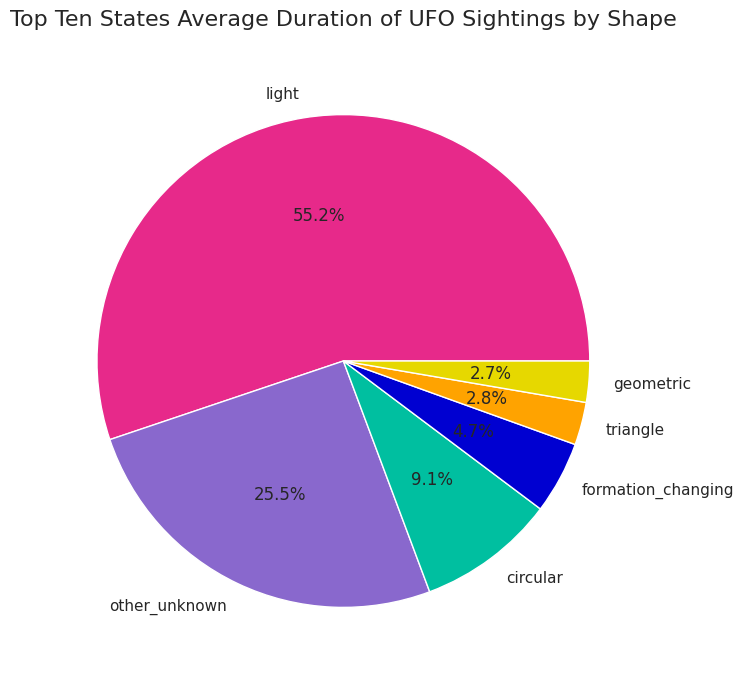

In [185]:
# Plot all_states_shape_duration in pie plot using shape_colors with percent values showing
all_states_shape_duration.plot(kind='pie', figsize=(8, 8), colors=[shape_colors[shape] for shape in all_states_shape_duration.index], autopct='%1.1f%%')
plt.title('Top Ten States Average Duration of UFO Sightings by Shape', fontsize=16, pad=20)
plt.ylabel('')
plt.show()

## Average All Shape Sightings by Top Ten States



In [186]:
top_us_shape_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,5.117557e+07,2474.520888
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08,11585.283897
16,1944-01-01 12:00:00,1944,ca,180.0,circular,5.117557e+07,2474.520888
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08,11585.283897
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5.392210e+06,1520.645736


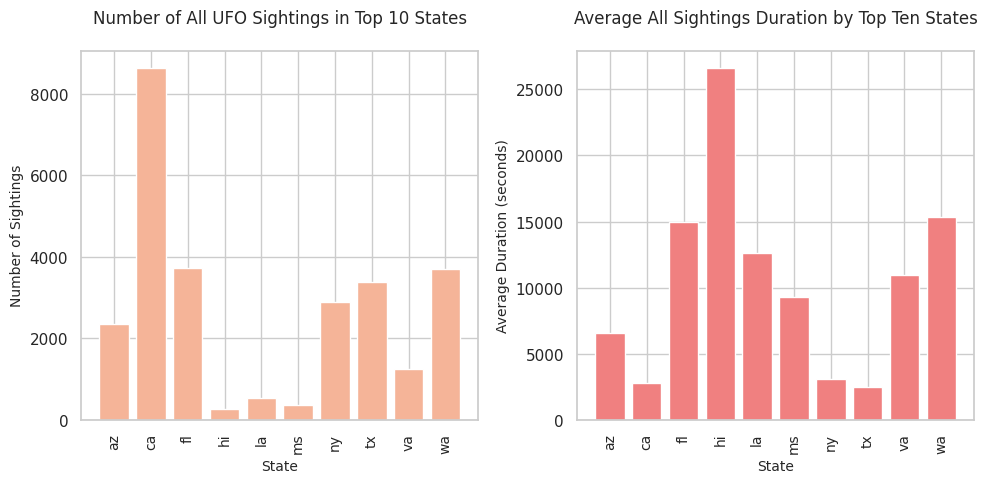

In [187]:
# Create subplots to show data by counts and seconds side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns, same figure size

# Define a common font size and other parameters for consistency
common_fontsize = 10
title_fontsize = 12

# Calculate the count of sightings for each state
state_counts = top_us_shape_df.groupby('state')['shape'].count()

# Plot the number of sightings on the first subplot
ax1.bar(state_counts.index, state_counts.values, color='#F5B498')
ax1.set_xlabel('State', fontsize=common_fontsize)
ax1.set_ylabel('Number of Sightings', fontsize=common_fontsize)
ax1.set_title('Number of All UFO Sightings in Top 10 States', fontsize=title_fontsize, pad=20)
ax1.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Calculate average duration for each state
average_durations = top_us_shape_df.groupby('state')['duration_seconds'].mean()

# Plot the average duration on the second subplot
ax2.bar(average_durations.index, average_durations.values, color='lightcoral')  # Use ax2 for the second plot
ax2.set_xlabel('State', fontsize=common_fontsize)
ax2.set_ylabel('Average Duration (seconds)', fontsize=common_fontsize)
ax2.set_title('Average All Sightings Duration by Top Ten States', fontsize=title_fontsize, pad=20)
ax2.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Adjust layout to ensure no labels or titles are clipped
plt.tight_layout()

# Show the plot
plt.show()


## Top 10 Circular

In [188]:
top_us_circular_df = top_us_shape_df.loc[top_us_shape_df['shape'] == 'circular']
top_us_circular_df = top_us_circular_df.sort_values(by='datetime')
top_us_circular_df.head(20)

# Remove 'average_duration' column from top_us_circular_df
# top_us_circular_df = top_us_circular_df.drop(columns=['average_duration'])
top_us_circular_df.head()


,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,51175566.48,2474.520888
16,1944-01-01 12:00:00,1944,ca,180.0,circular,51175566.48,2474.520888
22,1945-07-15 14:00:00,1945,tx,7200.0,circular,51175566.48,2474.520888
23,1945-08-08 12:00:00,1945,ca,300.0,circular,51175566.48,2474.520888
26,1946-01-08 02:00:00,1946,ny,300.0,circular,51175566.48,2474.520888


In [189]:
top_us_circular_by_year = top_us_circular_df[['year', 'duration_seconds']]
top_us_circular_by_year.head()

,year,duration_seconds
0,1910,120.0
16,1944,180.0
22,1945,7200.0
23,1945,300.0
26,1946,300.0


In [190]:
# group top_us_circular_by_year by the 'year' column
top_us_circular_by_year_grouped = top_us_circular_by_year.groupby('year').sum()
top_us_circular_by_year_grouped.head()

,duration_seconds
year,
1910,120.0
1944,180.0
1945,7500.0
1946,340.0
1947,5360.0


<ipython-input-191-4cec1a4f0e76>:30: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()
<ipython-input-191-4cec1a4f0e76>:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='Dark2')
/usr/local/lib/python3.10/dist-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/usr/local/lib/python3.10/dist-packages/sea

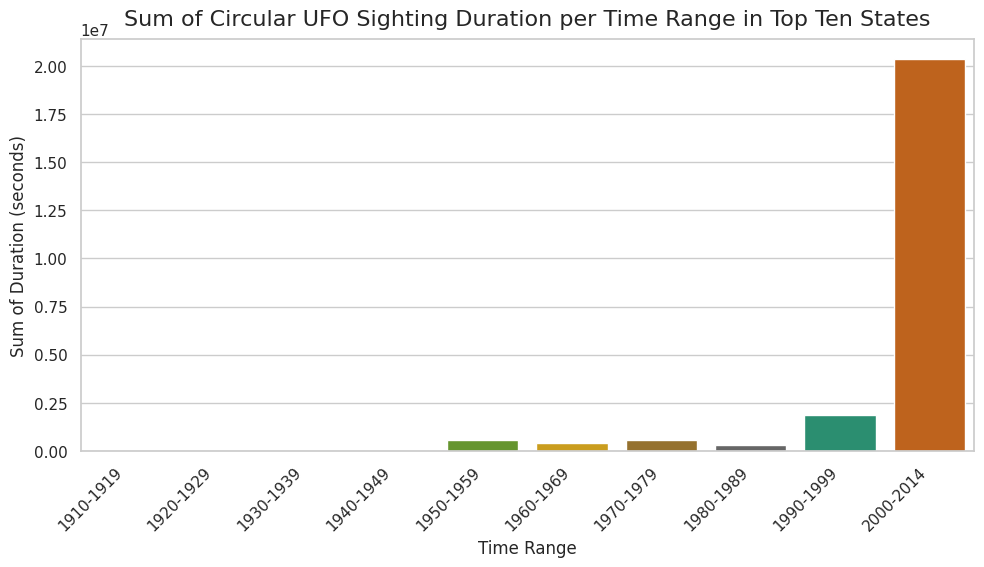

In [191]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Create the data as a pandas DataFrame
data = {
    'year': [1910, 1944, 1945, 1946, 1947, 1948, 1949, 1950, 1951, 1952, 1953, 1954, 1955, 1956, 1957, 1958, 1959,
             1960, 1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971, 1972, 1973, 1974, 1975, 1976,
             1977, 1978, 1979, 1980, 1981, 1982, 1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993,
             1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010,
             2011, 2012, 2013, 2014],
    'duration_seconds': [120, 180, 7500, 340, 5360, 610, 4210, 2114, 13928, 49055, 947, 5577, 3602, 3770, 4542, 467620,
                         8193, 5615, 187230, 4145, 22592, 12360, 35648, 46755, 46809, 34138, 14090, 108100, 33794, 16503,
                         136922, 26550, 45866, 96238, 35099, 63120, 28210, 36488, 59735, 7125, 21160, 26321, 33800, 35715,
                         29252, 24670, 11167, 10207, 557620, 22675, 19569, 28015, 380708, 54171, 92749, 495334.5, 185348,
                         455231, 655397.05, 6929009.3, 607681.9, 542147.45, 513239, 605187, 812789.3, 758508.2, 695748.2,
                         2985139.5, 642524.1, 981789.1, 3046012, 153641]
}
df = pd.DataFrame(data)

# Define the bins and corresponding labels
bins = [1910, 1920, 1930, 1940, 1950, 1960, 1970, 1980, 1990, 2000, 2015]
labels = ['1910-1919', '1920-1929', '1930-1939', '1940-1949', '1950-1959',
          '1960-1969', '1970-1979', '1980-1989', '1990-1999', '2000-2014']

# Bin the years into the specified ranges
df['TimeRange'] = pd.cut(df['year'], bins=bins, labels=labels, right=False)

# Group by the TimeRange and calculate the sum of duration_seconds per bin
grouped = df.groupby('TimeRange')['duration_seconds'].sum().reset_index()

# Plot the results using seaborn
plt.figure(figsize=(10, 6))
sns.barplot(x='TimeRange', y='duration_seconds', data=grouped, palette='Dark2')

# Set the title and labels
plt.title('Sum of Circular UFO Sighting Duration per Time Range in Top Ten States', fontsize=16, pad=10)
plt.xlabel('Time Range', fontsize=12)
plt.ylabel('Sum of Duration (seconds)', fontsize=12)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Display the plot
plt.tight_layout()
plt.show()


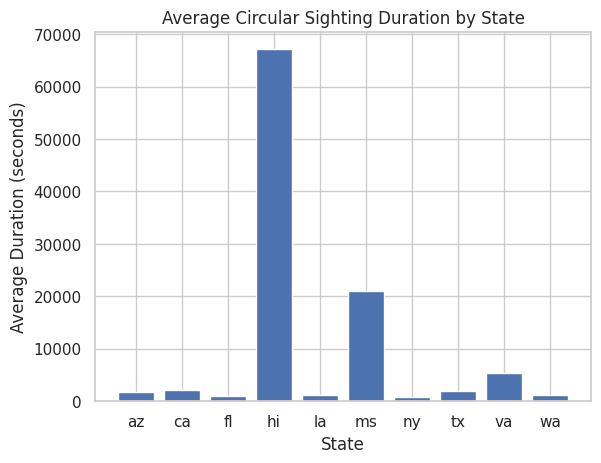

In [192]:
# @title Average Circular Sighting Duration by State

import matplotlib.pyplot as plt
import numpy as np

# Calculate average duration for each state
average_durations = top_us_circular_df.groupby('state')['duration_seconds'].mean()

# Create bar chart with salmon color
plt.bar(average_durations.index, average_durations.values)
plt.xlabel('State')
plt.ylabel('Average Duration (seconds)')
_ = plt.title('Average Circular Sighting Duration by State')

In [193]:
top_us_circular_df = top_us_shape_df.loc[top_us_shape_df['shape'] == 'circular']
top_us_circular_df = top_us_circular_df.sort_values(by='datetime')
top_us_circular_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
0,1910-06-01 15:00:00,1910,tx,120.0,circular,51175566.48,2474.520888
16,1944-01-01 12:00:00,1944,ca,180.0,circular,51175566.48,2474.520888
22,1945-07-15 14:00:00,1945,tx,7200.0,circular,51175566.48,2474.520888
23,1945-08-08 12:00:00,1945,ca,300.0,circular,51175566.48,2474.520888
26,1946-01-08 02:00:00,1946,ny,300.0,circular,51175566.48,2474.520888


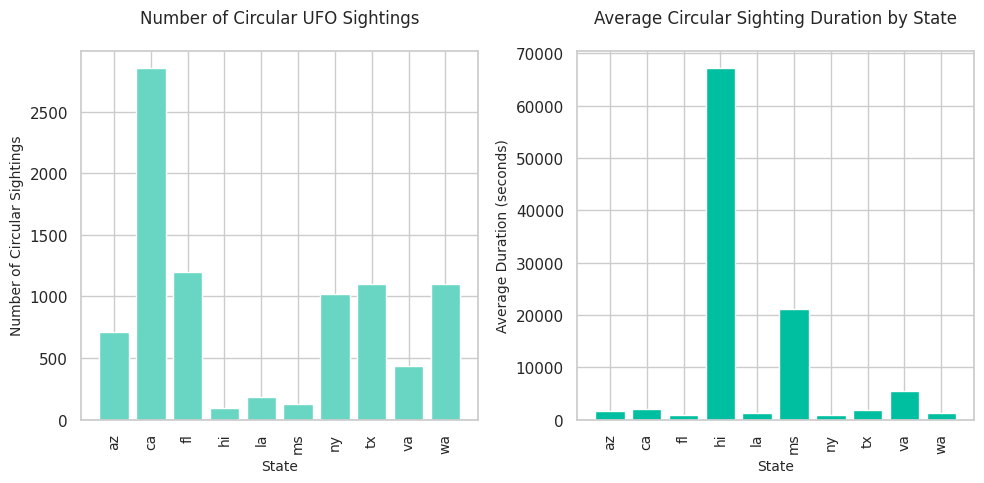

In [194]:
import matplotlib.pyplot as plt

# Create subplots to show data by counts and seconds side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns, same figure size

# Define a common font size and other parameters for consistency
common_fontsize = 10
title_fontsize = 12

# Calculate the count of sightings for each state
state_counts = top_us_circular_df.groupby('state')['shape'].count()

# Plot the number of sightings on the first subplot
ax1.bar(state_counts.index, state_counts.values, color='#69d6c4')
ax1.set_xlabel('State', fontsize=common_fontsize)
ax1.set_ylabel('Number of Circular Sightings', fontsize=common_fontsize)
ax1.set_title('Number of Circular UFO Sightings', fontsize=title_fontsize, pad=20)
ax1.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Calculate average duration for each state
average_durations = top_us_circular_df.groupby('state')['duration_seconds'].mean()

# Plot the average duration on the second subplot
ax2.bar(average_durations.index, average_durations.values, color='#00bfa0')  # Use ax2 for the second plot
ax2.set_xlabel('State', fontsize=common_fontsize)
ax2.set_ylabel('Average Duration (seconds)', fontsize=common_fontsize)
ax2.set_title('Average Circular Sighting Duration by State', fontsize=title_fontsize, pad=20)
ax2.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Adjust layout to ensure no labels or titles are clipped
plt.tight_layout()

# Show the plot
plt.show()


In [195]:
# #69d6c4
top_us_circular_state_counts = state_counts.copy()
print(top_us_circular_state_counts)

state
az     708
ca    2852
fl    1198
hi      95
la     184
ms     130
ny    1016
tx    1098
va     438
wa    1105
Name: shape, dtype: int64


In [196]:
##00bfa0
top_us_circular_average_durations = average_durations.copy()
print(top_us_circular_average_durations)

state
az     1681.120763
ca     2050.693058
fl      959.004758
hi    67115.768421
la     1273.032609
ms    21045.607692
ny      832.540354
tx     1864.637295
va     5374.952055
wa     1187.331267
Name: duration_seconds, dtype: float64


In [197]:
# #CEA2FD
top_us_other_unknown_state_counts = state_counts.copy()
print(top_us_other_unknown_state_counts)

state
az     708
ca    2852
fl    1198
hi      95
la     184
ms     130
ny    1016
tx    1098
va     438
wa    1105
Name: shape, dtype: int64


In [198]:
##8968CD
top_us_other_unknown_average_durations = average_durations.copy()
print(top_us_other_unknown_average_durations)

state
az     1681.120763
ca     2050.693058
fl      959.004758
hi    67115.768421
la     1273.032609
ms    21045.607692
ny      832.540354
tx     1864.637295
va     5374.952055
wa     1187.331267
Name: duration_seconds, dtype: float64


## Average Triangle Sightings by Top Ten States



In [199]:
top_us_triangle_df = top_us_shape_df.loc[top_us_shape_df['shape'] == 'triangle']
top_us_triangle_df = top_us_triangle_df.sort_values(by='datetime')
top_us_triangle_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
57,1947-07-15 21:00:00,1947,ca,240.0,triangle,10193503.36,1345.499388
119,1952-04-15 16:00:00,1952,tx,120.0,triangle,10193503.36,1345.499388
123,1952-06-15 21:00:00,1952,fl,30.0,triangle,10193503.36,1345.499388
310,1957-08-15 01:00:00,1957,wa,3.0,triangle,10193503.36,1345.499388
416,1960-03-12 23:00:00,1960,tx,10800.0,triangle,10193503.36,1345.499388


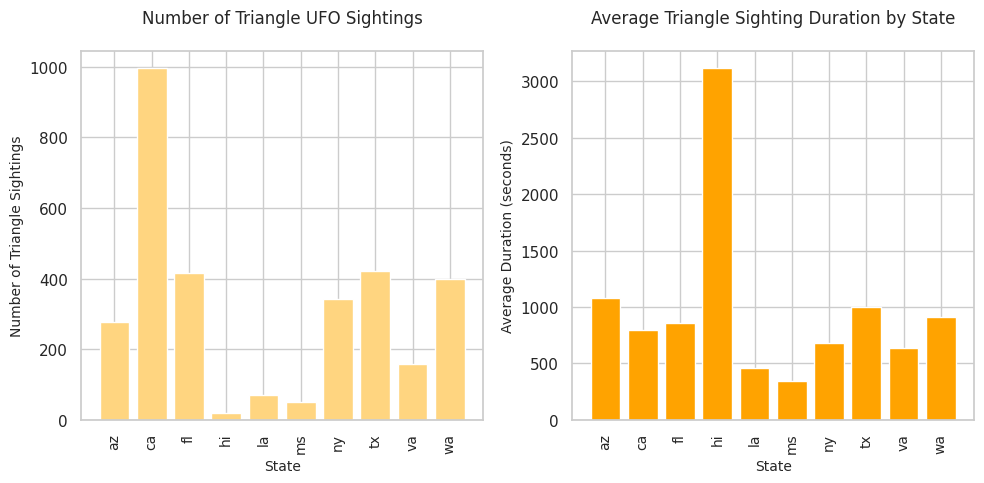

In [200]:
# Create subplots to show data by counts and seconds side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns, same figure size

# Define a common font size and other parameters for consistency
common_fontsize = 10
title_fontsize = 12

# Calculate the count of sightings for each state
state_counts = top_us_triangle_df.groupby('state')['shape'].count()

# Plot the number of sightings on the first subplot
ax1.bar(state_counts.index, state_counts.values, color='#FFD580')
ax1.set_xlabel('State', fontsize=common_fontsize)
ax1.set_ylabel('Number of Triangle Sightings', fontsize=common_fontsize)
ax1.set_title('Number of Triangle UFO Sightings', fontsize=title_fontsize, pad=20)
ax1.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Calculate average duration for each state
average_durations = top_us_triangle_df.groupby('state')['duration_seconds'].mean()

# Plot the average duration on the second subplot
ax2.bar(average_durations.index, average_durations.values, color='#ffa300')  # Use ax2 for the second plot
ax2.set_xlabel('State', fontsize=common_fontsize)
ax2.set_ylabel('Average Duration (seconds)', fontsize=common_fontsize)
ax2.set_title('Average Triangle Sighting Duration by State', fontsize=title_fontsize, pad=20)
ax2.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Adjust layout to ensure no labels or titles are clipped
plt.tight_layout()

# Show the plot
plt.show()


In [201]:
#FFD580
top_us_triangle_state_counts = state_counts.copy()
print(top_us_triangle_state_counts)

state
az    276
ca    996
fl    417
hi     18
la     71
ms     51
ny    343
tx    420
va    158
wa    399
Name: shape, dtype: int64


In [202]:
#ffa300
top_us_triangle_average_durations = average_durations.copy()
print(top_us_triangle_average_durations)

state
az    1077.150362
ca     790.923695
fl     853.275300
hi    3116.444444
la     461.338028
ms     340.117647
ny     678.589796
tx    1002.535714
va     639.778481
wa     914.541353
Name: duration_seconds, dtype: float64


## Average formation_changing Sightings by Top Ten States



In [203]:
top_us_formation_changing_df = top_us_shape_df.loc[top_us_shape_df['shape'] == 'formation_changing']
top_us_formation_changing_df = top_us_formation_changing_df.sort_values(by='datetime')
top_us_formation_changing_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
21,1945-07-10 01:30:00,1945,va,180.0,formation_changing,5392209.78,1520.645736
45,1947-07-01 20:00:00,1947,wa,120.0,formation_changing,5392209.78,1520.645736
274,1957-03-15 13:00:00,1957,ca,900.0,formation_changing,5392209.78,1520.645736
607,1963-08-01 22:00:00,1963,wa,5.0,formation_changing,5392209.78,1520.645736
738,1965-06-15 23:00:00,1965,ca,900.0,formation_changing,5392209.78,1520.645736


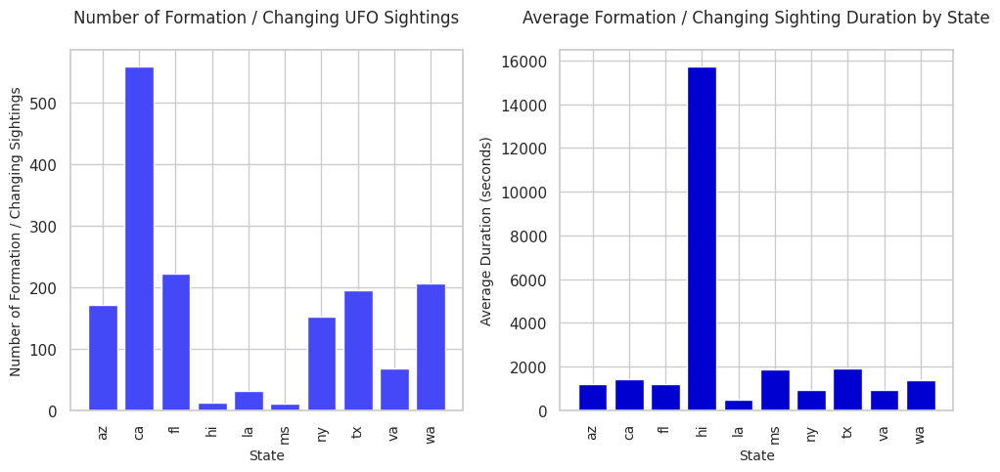

In [204]:
# Create subplots to show data by counts and seconds side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns, same figure size

# Define a common font size and other parameters for consistency
common_fontsize = 10
title_fontsize = 12

# Calculate the count of sightings for each state
state_counts = top_us_formation_changing_df.groupby('state')['shape'].count()

# Plot the number of sightings on the first subplot
ax1.bar(state_counts.index, state_counts.values, color='#4548f7')
ax1.set_xlabel('State', fontsize=common_fontsize)
ax1.set_ylabel('Number of Formation / Changing Sightings', fontsize=common_fontsize)
ax1.set_title('Number of Formation / Changing UFO Sightings', fontsize=title_fontsize, pad=20)
ax1.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Calculate average duration for each state
average_durations = top_us_formation_changing_df.groupby('state')['duration_seconds'].mean()

# Plot the average duration on the second subplot
ax2.bar(average_durations.index, average_durations.values, color='#0000D1')  # Use ax2 for the second plot
ax2.set_xlabel('State', fontsize=common_fontsize)
ax2.set_ylabel('Average Duration (seconds)', fontsize=common_fontsize)
ax2.set_title('Average Formation / Changing Sighting Duration by State', fontsize=title_fontsize, pad=20)
ax2.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Adjust layout to ensure no labels or titles are clipped
plt.tight_layout()

# Show the plot
plt.show()


In [205]:
top_us_formation_changing_state_counts = state_counts.copy()
#4548f7
print(top_us_formation_changing_state_counts)

state
az    171
ca    559
fl    222
hi     12
la     32
ms     10
ny    152
tx    195
va     68
wa    206
Name: shape, dtype: int64


In [206]:
top_us_formation_changing_average_durations = average_durations.copy()
#0000D1
print(top_us_formation_changing_average_durations)

state
az     1179.736842
ca     1413.189857
fl     1209.328829
hi    15715.166667
la      468.062500
ms     1878.200000
ny      905.565789
tx     1889.917949
va      902.044118
wa     1352.699029
Name: duration_seconds, dtype: float64


## Average Geometric Sightings by Top Ten States



In [207]:
top_us_geometric_df = top_us_shape_df.loc[top_us_shape_df['shape'] == 'geometric']
top_us_geometric_df = top_us_geometric_df.sort_values(by='datetime')
top_us_geometric_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
277,1957-05-25 13:00:00,1957,ny,20.0,geometric,2745568.5,995.131751
288,1957-06-30 12:00:00,1957,ny,600.0,geometric,2745568.5,995.131751
299,1957-07-15 13:00:00,1957,tx,120.0,geometric,2745568.5,995.131751
354,1958-07-10 09:00:00,1958,ny,20.0,geometric,2745568.5,995.131751
387,1959-06-28 13:00:00,1959,az,300.0,geometric,2745568.5,995.131751


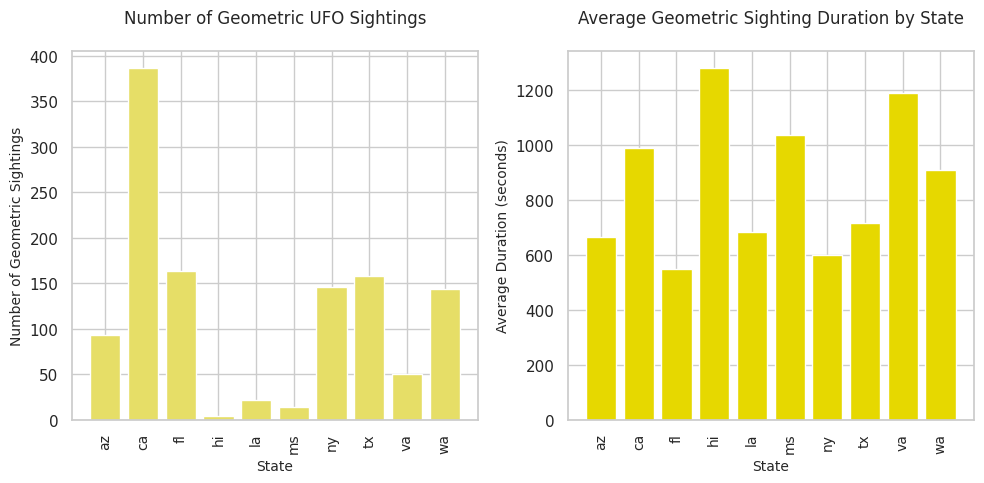

In [208]:
# Create subplots to show data by counts and seconds side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns, same figure size

# Define a common font size and other parameters for consistency
common_fontsize = 10
title_fontsize = 12

# Calculate the count of sightings for each state
state_counts = top_us_geometric_df.groupby('state')['shape'].count()

# Plot the number of sightings on the first subplot
ax1.bar(state_counts.index, state_counts.values, color='#e6de67')
ax1.set_xlabel('State', fontsize=common_fontsize)
ax1.set_ylabel('Number of Geometric Sightings', fontsize=common_fontsize)
ax1.set_title('Number of Geometric UFO Sightings', fontsize=title_fontsize, pad=20)
ax1.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Calculate average duration for each state
average_durations = top_us_geometric_df.groupby('state')['duration_seconds'].mean()

# Plot the average duration on the second subplot
ax2.bar(average_durations.index, average_durations.values, color='#e6d800')  # Use ax2 for the second plot
ax2.set_xlabel('State', fontsize=common_fontsize)
ax2.set_ylabel('Average Duration (seconds)', fontsize=common_fontsize)
ax2.set_title('Average Geometric Sighting Duration by State', fontsize=title_fontsize, pad=20)
ax2.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Adjust layout to ensure no labels or titles are clipped
plt.tight_layout()

# Show the plot
plt.show()


In [209]:
# #e6de67
top_us_geometric_state_counts = state_counts.copy()
print(top_us_geometric_state_counts)

state
az     93
ca    386
fl    163
hi      4
la     22
ms     14
ny    146
tx    158
va     50
wa    143
Name: shape, dtype: int64


In [210]:
##e6d800
top_us_geometric_average_durations = average_durations.copy()
print(top_us_geometric_average_durations)

state
az     666.580645
ca     989.980570
fl     548.349693
hi    1280.000000
la     685.227273
ms    1038.928571
ny     598.130137
tx     715.392405
va    1190.620000
wa     910.034965
Name: duration_seconds, dtype: float64


## Average Light Sightings by Top Ten States



In [211]:
top_us_light_df = top_us_shape_df.loc[top_us_shape_df['shape'] == 'light']
top_us_light_df = top_us_light_df.sort_values(by='datetime')
top_us_light_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
8,1937-08-15 21:00:00,1937,ca,600.0,light,2.269441e+08,11585.283897
19,1945-06-01 13:30:00,1945,fl,300.0,light,2.269441e+08,11585.283897
30,1946-06-30 21:00:00,1946,wa,30.0,light,2.269441e+08,11585.283897
32,1946-09-30 20:30:00,1946,az,40.0,light,2.269441e+08,11585.283897
66,1948-07-15 22:00:00,1948,ca,900.0,light,2.269441e+08,11585.283897


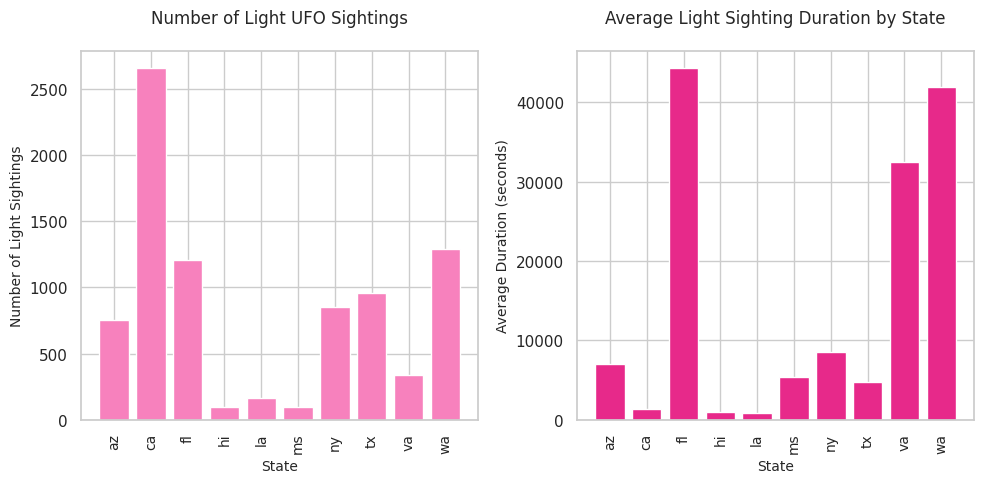

In [212]:
# Create subplots to show data by counts and seconds side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns, same figure size

# Define a common font size and other parameters for consistency
common_fontsize = 10
title_fontsize = 12

# Calculate the count of sightings for each state
state_counts = top_us_light_df.groupby('state')['shape'].count()

# Plot the number of sightings on the first subplot
ax1.bar(state_counts.index, state_counts.values, color='#f781bd')
ax1.set_xlabel('State', fontsize=common_fontsize)
ax1.set_ylabel('Number of Light Sightings', fontsize=common_fontsize)
ax1.set_title('Number of Light UFO Sightings', fontsize=title_fontsize, pad=20)
ax1.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Calculate average duration for each state
average_durations = top_us_light_df.groupby('state')['duration_seconds'].mean()

# Plot the average duration on the second subplot
ax2.bar(average_durations.index, average_durations.values, color='#e7298a')  # Use ax2 for the second plot
ax2.set_xlabel('State', fontsize=common_fontsize)
ax2.set_ylabel('Average Duration (seconds)', fontsize=common_fontsize)
ax2.set_title('Average Light Sighting Duration by State', fontsize=title_fontsize, pad=20)
ax2.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Adjust layout to ensure no labels or titles are clipped
plt.tight_layout()

# Show the plot
plt.show()


In [213]:
# #f781bd
top_us_light_state_counts = state_counts.copy()
print(top_us_light_state_counts)

state
az     755
ca    2657
fl    1209
hi      96
la     167
ms      98
ny     850
tx     960
va     335
wa    1290
Name: shape, dtype: int64


In [214]:
#e7298a
top_us_light_average_durations = average_durations.copy()
print(top_us_light_average_durations)

state
az     7065.589669
ca     1363.728845
fl    44288.607940
hi      922.135417
la      848.221557
ms     5411.867347
ny     8491.338471
tx     4785.434375
va    32421.486567
wa    41939.363209
Name: duration_seconds, dtype: float64


## Average other_unknown Sightings by Top Ten States



In [215]:
top_us_other_unknown_df = top_us_shape_df.loc[top_us_shape_df['shape'] == 'other_unknown']
top_us_other_unknown_df = top_us_other_unknown_df.sort_values(by='datetime')
top_us_other_unknown_df.head()

,datetime,year,state,duration_seconds,shape,sum_durations,avg_durations
33,1947-01-10 20:00:00,1947,tx,4.0,other_unknown,46425180.6,5188.33042
35,1947-04-15 14:00:00,1947,fl,420.0,other_unknown,46425180.6,5188.33042
77,1949-07-15 20:30:00,1949,ms,900.0,other_unknown,46425180.6,5188.33042
104,1950-12-12 22:00:00,1950,ca,600.0,other_unknown,46425180.6,5188.33042
140,1952-07-15 18:30:00,1952,wa,180.0,other_unknown,46425180.6,5188.33042


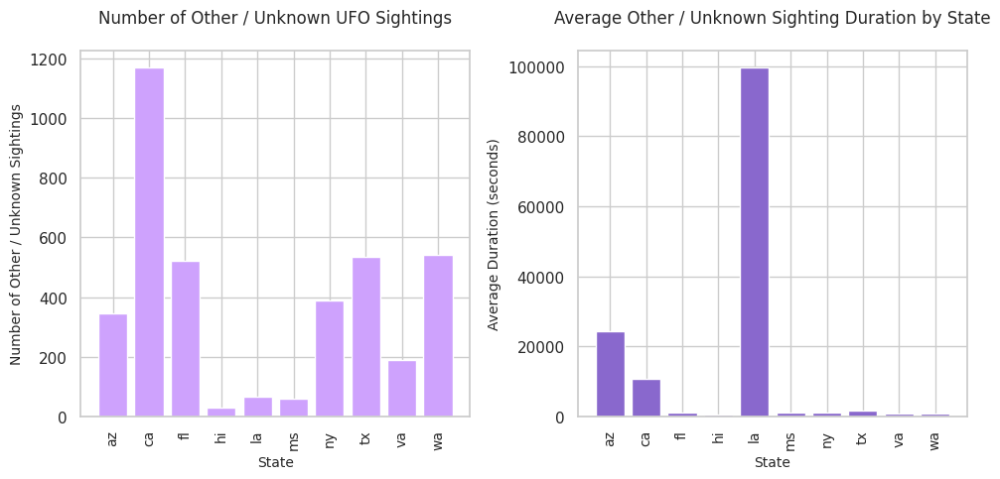

In [216]:
# Create subplots to show data by counts and seconds side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns, same figure size

# Define a common font size and other parameters for consistency
common_fontsize = 10
title_fontsize = 12

# Calculate the count of sightings for each state
state_counts = top_us_other_unknown_df.groupby('state')['shape'].count()

# Plot the number of sightings on the first subplot
ax1.bar(state_counts.index, state_counts.values, color='#CEA2FD')
ax1.set_xlabel('State', fontsize=common_fontsize)
ax1.set_ylabel('Number of Other / Unknown Sightings', fontsize=common_fontsize)
ax1.set_title('Number of Other / Unknown UFO Sightings', fontsize=title_fontsize, pad=20)
ax1.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Calculate average duration for each state
average_durations = top_us_other_unknown_df.groupby('state')['duration_seconds'].mean()

# Plot the average duration on the second subplot
ax2.bar(average_durations.index, average_durations.values, color='#8968CD')  # Use ax2 for the second plot
ax2.set_xlabel('State', fontsize=common_fontsize)
ax2.set_ylabel('Average Duration (seconds)', fontsize=common_fontsize)
ax2.set_title('Average Other / Unknown Sighting Duration by State', fontsize=title_fontsize, pad=20)
ax2.tick_params(axis='x', rotation=90, labelsize=10)  # Set tick label size

# Adjust layout to ensure no labels or titles are clipped
plt.tight_layout()

# Show the plot
plt.show()


In [217]:
# #CEA2FD
top_us_other_unknown_state_counts = state_counts.copy()
print(top_us_other_unknown_state_counts)

state
az     345
ca    1170
fl     523
hi      28
la      64
ms      60
ny     387
tx     536
va     189
wa     543
Name: shape, dtype: int64


In [218]:
##8968CD
top_us_other_unknown_average_durations = average_durations.copy()
print(top_us_other_unknown_average_durations)

state
az    24224.137391
ca    10689.282650
fl      898.689293
hi      521.214286
la    99590.531250
ms     1025.800000
ny      960.050517
tx     1622.144590
va      840.825397
wa      766.999724
Name: duration_seconds, dtype: float64


## Group Top Ten States Data

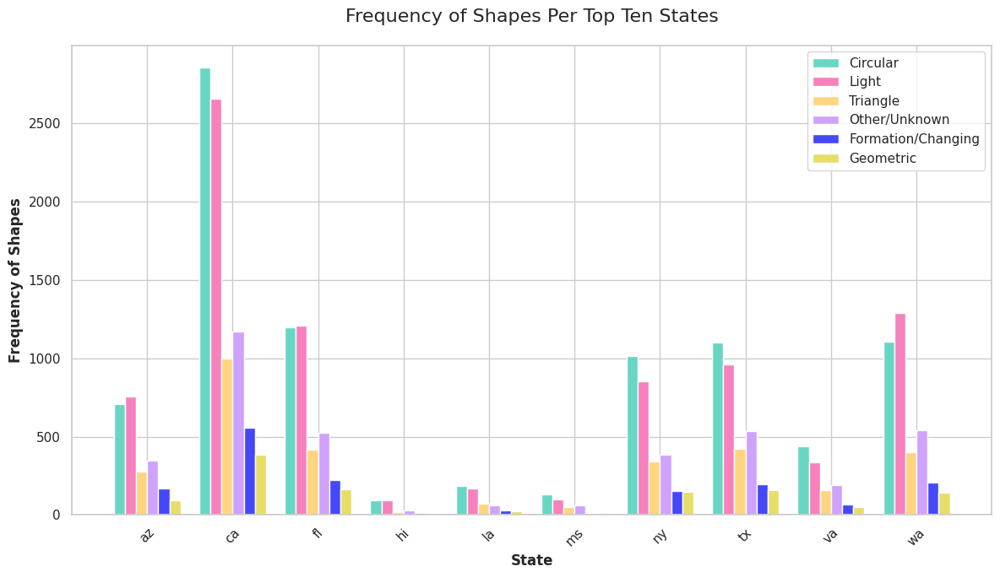

In [219]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Define the specific colors for each shape
shape_colors = {
    'circular': '#69d6c4',
    'light': '#f781bd',
    'triangle': '#FFD580',
    'formation_changing': '#4548f7',
    'geometric': '#e6de67',
    'other_unknown': '#CEA2FD'
}

# Data
data = {
    'state': ['az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa'],
    'circular': [708, 2852, 1198, 95, 184, 130, 1016, 1098, 438, 1105],
    'light': [755, 2657, 1209, 96, 167, 98, 850, 960, 335, 1290],
    'triangle': [276, 996, 417, 18, 71, 51, 343, 420, 158, 399],
    'other_unknown': [345, 1170, 523, 28, 64, 60, 387, 536, 189, 543],
    'formation_changing': [171, 559, 222, 12, 32, 10, 152, 195, 68, 206],
    'geometric': [93, 386, 163, 4, 22, 14, 146, 158, 50, 143]
}

# Convert data to a DataFrame
df = pd.DataFrame(data)

# Set up the figure size
fig, ax = plt.subplots(figsize=(12, 7))

# Bar width
bar_width = 0.13

# Position of the bars on the x-axis
r1 = np.arange(len(df['state']))  # first set of bars
r2 = [x + bar_width for x in r1]  # second set of bars
r3 = [x + bar_width for x in r2]  # third set of bars
r4 = [x + bar_width for x in r3]  # fourth set of bars
r5 = [x + bar_width for x in r4]  # fifth set of bars
r6 = [x + bar_width for x in r5]  # sixth set of bars

# Plot each shape
ax.bar(r1, df['circular'], color=shape_colors['circular'], width=bar_width, edgecolor='white', label='Circular')
ax.bar(r2, df['light'], color=shape_colors['light'], width=bar_width, edgecolor='white', label='Light')
ax.bar(r3, df['triangle'], color=shape_colors['triangle'], width=bar_width, edgecolor='white', label='Triangle')
ax.bar(r4, df['other_unknown'], color=shape_colors['other_unknown'], width=bar_width, edgecolor='white', label='Other/Unknown')
ax.bar(r5, df['formation_changing'], color=shape_colors['formation_changing'], width=bar_width, edgecolor='white', label='Formation/Changing')
ax.bar(r6, df['geometric'], color=shape_colors['geometric'], width=bar_width, edgecolor='white', label='Geometric')

# Add x-axis labels
ax.set_xlabel('State', fontweight='bold', fontsize=12)
ax.set_ylabel('Frequency of Shapes', fontweight='bold', fontsize=12)
ax.set_title('Frequency of Shapes Per Top Ten States', fontsize=16, pad=20)

# Add ticks on the x-axis
ax.set_xticks([r + bar_width * 2.5 for r in range(len(df['state']))])
ax.set_xticklabels(df['state'])

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Add a legend
plt.legend()

# Ensure layout is not clipped
plt.tight_layout()

# Show the plot
plt.show()


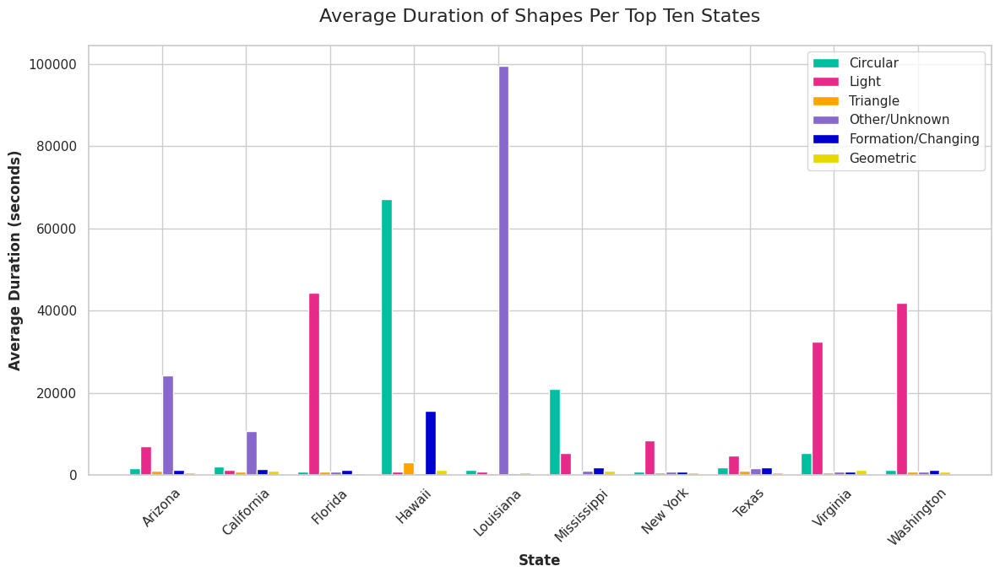

In [220]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Define the specific colors for each shape
shape_colors = {
    'circular': '#00bfa0',
    'light': '#e7298a',
    'triangle': '#ffa300',
    'formation_changing': '#0000D1',
    'geometric': '#e6d800',
    'other_unknown': '#8968CD'
}

# Data
data = {
    'state': ['Arizona', 'California', 'Florida', 'Hawaii', 'Louisiana', 'Mississippi',
              'New York', 'Texas', 'Virginia', 'Washington'],
    'light': [7066, 1364, 44289, 922, 848, 5412, 8491, 4785, 32421, 41939],
    'other_unknown': [24224, 10689, 899, 521, 99591, 1026, 960, 1622, 841, 767],
    'circular': [1681, 2051, 959, 67116, 1273, 21046, 833, 1865, 5375, 1187],
    'formation_changing': [1180, 1413, 1209, 15715, 468, 1878, 906, 1890, 902, 1353],
    'triangle': [1077, 791, 853, 3116, 461, 340, 679, 1003, 640, 915],
    'geometric': [667, 990, 548, 1280, 685, 1039, 598, 715, 1191, 910]
}

# Convert data to a DataFrame
df = pd.DataFrame(data)

# Set up the figure size
fig, ax = plt.subplots(figsize=(12, 7))

# Bar width
bar_width = 0.13

# Position of the bars on the x-axis
r1 = np.arange(len(df['state']))  # first set of bars
r2 = [x + bar_width for x in r1]  # second set of bars
r3 = [x + bar_width for x in r2]  # third set of bars
r4 = [x + bar_width for x in r3]  # fourth set of bars
r5 = [x + bar_width for x in r4]  # fifth set of bars
r6 = [x + bar_width for x in r5]  # sixth set of bars

# Plot each shape
ax.bar(r1, df['circular'], color=shape_colors['circular'], width=bar_width, edgecolor='white', label='Circular')
ax.bar(r2, df['light'], color=shape_colors['light'], width=bar_width, edgecolor='white', label='Light')
ax.bar(r3, df['triangle'], color=shape_colors['triangle'], width=bar_width, edgecolor='white', label='Triangle')
ax.bar(r4, df['other_unknown'], color=shape_colors['other_unknown'], width=bar_width, edgecolor='white', label='Other/Unknown')
ax.bar(r5, df['formation_changing'], color=shape_colors['formation_changing'], width=bar_width, edgecolor='white', label='Formation/Changing')
ax.bar(r6, df['geometric'], color=shape_colors['geometric'], width=bar_width, edgecolor='white', label='Geometric')

# Add x-axis labels
ax.set_xlabel('State', fontweight='bold', fontsize=12)
ax.set_ylabel('Average Duration (seconds)', fontweight='bold', fontsize=12)
ax.set_title('Average Duration of Shapes Per Top Ten States', fontsize=16, pad=20)

# Add ticks on the x-axis
ax.set_xticks([r + bar_width * 2.5 for r in range(len(df['state']))])
ax.set_xticklabels(df['state'])

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Add a legend
plt.legend()

# Ensure layout is not clipped
plt.tight_layout()

# Show the plot
plt.show()


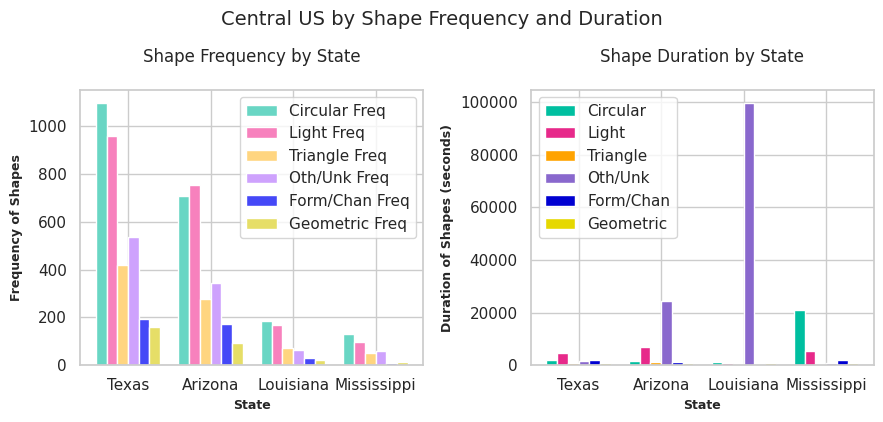

In [227]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Define the specific colors for shape frequencies
freq_colors = {
   'Circular Freq': '#69d6c4',
   'Light Freq': '#f781bd',
   'Triangle Freq': '#FFD580',
   'Form/Chan Freq': '#4548f7',
   'Geometric Freq': '#e6de67',
   'Oth/Unk Freq': '#CEA2FD'
}

# Define the specific colors for shape durations
duration_colors = {
   'Circular': '#00bfa0',
   'Light': '#e7298a',
   'Triangle': '#ffa300',
   'Form/Chan': '#0000D1',
   'Geometric': '#e6d800',
   'Oth/Unk': '#8968CD'
}

# Frequency Data
freq_data = {
    'state': ['Texas', 'Arizona', 'Louisiana', 'Mississippi'],
    'Circular Freq': [1098, 708, 184, 130],
    'Light Freq': [960, 755, 167, 98],
    'Triangle Freq': [420, 276, 71, 51],
    'Oth/Unk Freq': [536, 345, 64, 60],
    'Form/Chan Freq': [195, 171, 32, 10],
    'Geometric Freq': [158, 93, 22, 14]
}

# Duration Data
duration_data = {
    'state': ['Texas', 'Arizona', 'Louisiana', 'Mississippi'],
    'Light': [4785, 7066, 848, 5412],
    'Oth/Unk': [1622, 24224, 99591, 1026],
    'Circular': [1865, 1681, 1273, 21046],
    'Form/Chan': [1890, 1180, 468, 1878],
    'Triangle': [1003, 1077, 461, 340],
    'Geometric': [715, 667, 685, 1039]
}

# Convert both datasets to DataFrames
freq_df = pd.DataFrame(freq_data)
duration_df = pd.DataFrame(duration_data)

# Set up the figure size
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

# Bar width
bar_width = 0.13

# Positions for Frequency Data bars
r1 = np.arange(len(freq_df['state']))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]
r4 = [x + bar_width for x in r3]
r5 = [x + bar_width for x in r4]
r6 = [x + bar_width for x in r5]

# Plot Frequency Data
ax1.bar(r1, freq_df['Circular Freq'], color=freq_colors['Circular Freq'], width=bar_width, edgecolor='white', label='Circular Freq')
ax1.bar(r2, freq_df['Light Freq'], color=freq_colors['Light Freq'], width=bar_width, edgecolor='white', label='Light Freq')
ax1.bar(r3, freq_df['Triangle Freq'], color=freq_colors['Triangle Freq'], width=bar_width, edgecolor='white', label='Triangle Freq')
ax1.bar(r4, freq_df['Oth/Unk Freq'], color=freq_colors['Oth/Unk Freq'], width=bar_width, edgecolor='white', label='Oth/Unk Freq')
ax1.bar(r5, freq_df['Form/Chan Freq'], color=freq_colors['Form/Chan Freq'], width=bar_width, edgecolor='white', label='Form/Chan Freq')
ax1.bar(r6, freq_df['Geometric Freq'], color=freq_colors['Geometric Freq'], width=bar_width, edgecolor='white', label='Geometric Freq')

# Add labels, title, and ticks to the first subplot (Frequency Data)
ax1.set_xlabel('State', fontweight='bold', fontsize=9)
ax1.set_ylabel('Frequency of Shapes', fontweight='bold', fontsize=9)
ax1.set_title('Shape Frequency by State', fontsize=12, pad=20)
ax1.set_xticks([r + bar_width * 2.5 for r in range(len(freq_df['state']))])
ax1.set_xticklabels(freq_df['state'])
ax1.legend()

# Positions for Duration Data bars
r1_d = np.arange(len(duration_df['state']))
r2_d = [x + bar_width for x in r1_d]
r3_d = [x + bar_width for x in r2_d]
r4_d = [x + bar_width for x in r3_d]
r5_d = [x + bar_width for x in r4_d]
r6_d = [x + bar_width for x in r5_d]

# Plot Duration Data
ax2.bar(r1_d, duration_df['Circular'], color=duration_colors['Circular'], width=bar_width, edgecolor='white', label='Circular')
ax2.bar(r2_d, duration_df['Light'], color=duration_colors['Light'], width=bar_width, edgecolor='white', label='Light')
ax2.bar(r3_d, duration_df['Triangle'], color=duration_colors['Triangle'], width=bar_width, edgecolor='white', label='Triangle')
ax2.bar(r4_d, duration_df['Oth/Unk'], color=duration_colors['Oth/Unk'], width=bar_width, edgecolor='white', label='Oth/Unk')
ax2.bar(r5_d, duration_df['Form/Chan'], color=duration_colors['Form/Chan'], width=bar_width, edgecolor='white', label='Form/Chan')
ax2.bar(r6_d, duration_df['Geometric'], color=duration_colors['Geometric'], width=bar_width, edgecolor='white', label='Geometric')

# Add labels, title, and ticks to the second subplot (Duration Data)
ax2.set_xlabel('State', fontweight='bold', fontsize=9)
ax2.set_ylabel('Duration of Shapes (seconds)', fontweight='bold', fontsize=9)
ax2.set_title('Shape Duration by State', fontsize=12, pad=20)
ax2.set_xticks([r + bar_width * 2.5 for r in range(len(duration_df['state']))])
ax2.set_xticklabels(duration_df['state'])
ax2.legend()

# Ensure layout is not clipped and the subplots are properly spaced
plt.tight_layout()

# Set the main title for both subplots
plt.suptitle('Central US by Shape Frequency and Duration', fontsize=14, y=1.05)

# Show the plot
plt.show()


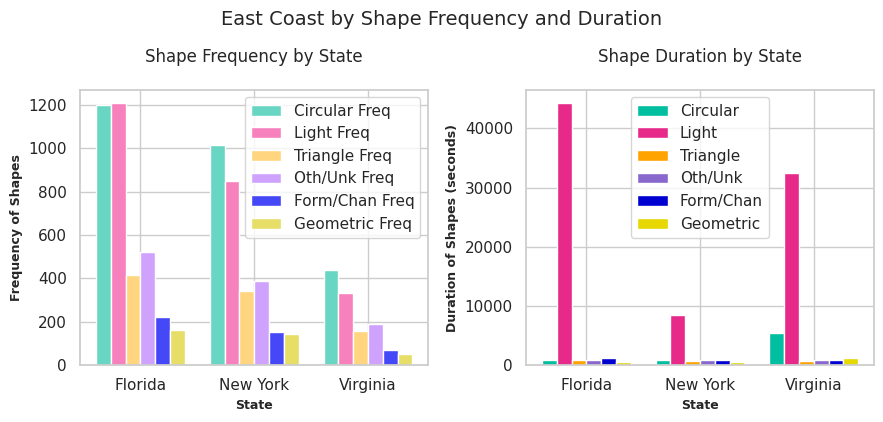

In [228]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Define the specific colors for shape frequencies
freq_colors = {
   'Circular Freq': '#69d6c4',
   'Light Freq': '#f781bd',
   'Triangle Freq': '#FFD580',
   'Form/Chan Freq': '#4548f7',
   'Geometric Freq': '#e6de67',
   'Oth/Unk Freq': '#CEA2FD'
}

# Define the specific colors for shape durations
duration_colors = {
   'Circular': '#00bfa0',
   'Light': '#e7298a',
   'Triangle': '#ffa300',
   'Form/Chan': '#0000D1',
   'Geometric': '#e6d800',
   'Oth/Unk': '#8968CD'
}

# Frequency Data
freq_data = {
    'state': ['Florida', 'New York', 'Virginia'],
    'Circular Freq': [1198, 1016, 438],
    'Light Freq': [1209, 850, 335],
    'Triangle Freq': [417, 343, 158],
    'Oth/Unk Freq': [523, 387, 189],
    'Form/Chan Freq': [222, 152, 68],
    'Geometric Freq': [163, 146, 50]
}

# Duration Data
duration_data = {
    'state': ['Florida', 'New York', 'Virginia'],
    'Light': [44289, 8491, 32421],
    'Oth/Unk': [899, 960, 841],
    'Circular': [959, 833, 5375],
    'Form/Chan': [1209, 906, 902],
    'Triangle': [853, 679, 640],
    'Geometric': [548, 598, 1191]
}



# Convert both datasets to DataFrames
freq_df = pd.DataFrame(freq_data)
duration_df = pd.DataFrame(duration_data)

# Set up the figure size
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

# Bar width
bar_width = 0.13

# Positions for Frequency Data bars
r1 = np.arange(len(freq_df['state']))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]
r4 = [x + bar_width for x in r3]
r5 = [x + bar_width for x in r4]
r6 = [x + bar_width for x in r5]

# Plot Frequency Data
ax1.bar(r1, freq_df['Circular Freq'], color=freq_colors['Circular Freq'], width=bar_width, edgecolor='white', label='Circular Freq')
ax1.bar(r2, freq_df['Light Freq'], color=freq_colors['Light Freq'], width=bar_width, edgecolor='white', label='Light Freq')
ax1.bar(r3, freq_df['Triangle Freq'], color=freq_colors['Triangle Freq'], width=bar_width, edgecolor='white', label='Triangle Freq')
ax1.bar(r4, freq_df['Oth/Unk Freq'], color=freq_colors['Oth/Unk Freq'], width=bar_width, edgecolor='white', label='Oth/Unk Freq')
ax1.bar(r5, freq_df['Form/Chan Freq'], color=freq_colors['Form/Chan Freq'], width=bar_width, edgecolor='white', label='Form/Chan Freq')
ax1.bar(r6, freq_df['Geometric Freq'], color=freq_colors['Geometric Freq'], width=bar_width, edgecolor='white', label='Geometric Freq')

# Add labels, title, and ticks to the first subplot (Frequency Data)
ax1.set_xlabel('State', fontweight='bold', fontsize=9)
ax1.set_ylabel('Frequency of Shapes', fontweight='bold', fontsize=9)
ax1.set_title('Shape Frequency by State', fontsize=12, pad=20)
ax1.set_xticks([r + bar_width * 2.5 for r in range(len(freq_df['state']))])
ax1.set_xticklabels(freq_df['state'])
ax1.legend()

# Positions for Duration Data bars
r1_d = np.arange(len(duration_df['state']))
r2_d = [x + bar_width for x in r1_d]
r3_d = [x + bar_width for x in r2_d]
r4_d = [x + bar_width for x in r3_d]
r5_d = [x + bar_width for x in r4_d]
r6_d = [x + bar_width for x in r5_d]

# Plot Duration Data
ax2.bar(r1_d, duration_df['Circular'], color=duration_colors['Circular'], width=bar_width, edgecolor='white', label='Circular')
ax2.bar(r2_d, duration_df['Light'], color=duration_colors['Light'], width=bar_width, edgecolor='white', label='Light')
ax2.bar(r3_d, duration_df['Triangle'], color=duration_colors['Triangle'], width=bar_width, edgecolor='white', label='Triangle')
ax2.bar(r4_d, duration_df['Oth/Unk'], color=duration_colors['Oth/Unk'], width=bar_width, edgecolor='white', label='Oth/Unk')
ax2.bar(r5_d, duration_df['Form/Chan'], color=duration_colors['Form/Chan'], width=bar_width, edgecolor='white', label='Form/Chan')
ax2.bar(r6_d, duration_df['Geometric'], color=duration_colors['Geometric'], width=bar_width, edgecolor='white', label='Geometric')

# Add labels, title, and ticks to the second subplot (Duration Data)
ax2.set_xlabel('State', fontweight='bold', fontsize=9)
ax2.set_ylabel('Duration of Shapes (seconds)', fontweight='bold', fontsize=9)
ax2.set_title('Shape Duration by State', fontsize=12, pad=20)
ax2.set_xticks([r + bar_width * 2.5 for r in range(len(duration_df['state']))])
ax2.set_xticklabels(duration_df['state'])
ax2.legend()

# Ensure layout is not clipped and the subplots are properly spaced
plt.tight_layout()

# Set the main title for both subplots
plt.suptitle('East Coast by Shape Frequency and Duration', fontsize=14, y=1.05)

# Show the plot
plt.show()


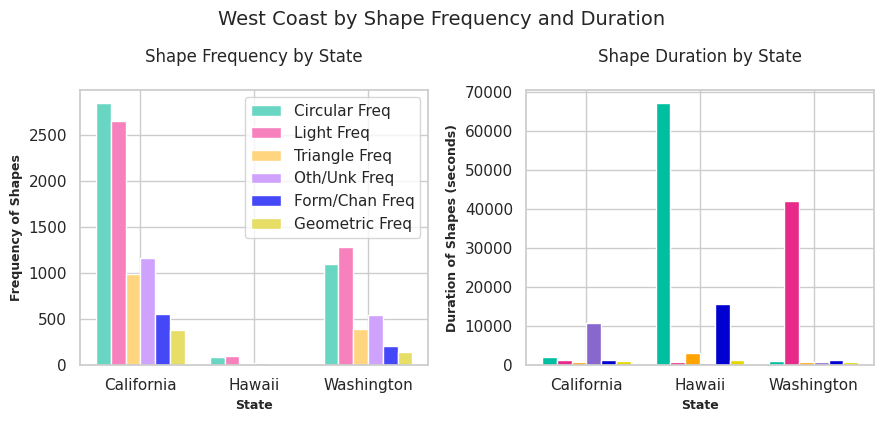

In [231]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Define the specific colors for shape frequencies
freq_colors = {
   'Circular Freq': '#69d6c4',
   'Light Freq': '#f781bd',
   'Triangle Freq': '#FFD580',
   'Form/Chan Freq': '#4548f7',
   'Geometric Freq': '#e6de67',
   'Oth/Unk Freq': '#CEA2FD'
}

# Define the specific colors for shape durations
duration_colors = {
   'Circular': '#00bfa0',
   'Light': '#e7298a',
   'Triangle': '#ffa300',
   'Form/Chan': '#0000D1',
   'Geometric': '#e6d800',
   'Oth/Unk': '#8968CD'
}

# Frequency Data
freq_data = {
    'state': ['California', 'Hawaii', 'Washington'],
    'Circular Freq': [2852, 95, 1105],
    'Light Freq': [2657, 96, 1290],
    'Triangle Freq': [996, 18, 399],
    'Oth/Unk Freq': [1170, 28, 543],
    'Form/Chan Freq': [559, 12, 206],
    'Geometric Freq': [386, 4, 143]
}

# Duration Data
duration_data = {
    'state': ['California', 'Hawaii', 'Washington'],
    'Light': [1364, 922, 41939],
    'Oth/Unk': [10689, 521, 767],
    'Circular': [2051, 67116, 1187],
    'Form/Chan': [1413, 15715, 1353],
    'Triangle': [791, 3116, 915],
    'Geometric': [990, 1280, 910]
}




# Convert both datasets to DataFrames
freq_df = pd.DataFrame(freq_data)
duration_df = pd.DataFrame(duration_data)

# Set up the figure size
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(9, 4))

# Bar width
bar_width = 0.13

# Positions for Frequency Data bars
r1 = np.arange(len(freq_df['state']))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]
r4 = [x + bar_width for x in r3]
r5 = [x + bar_width for x in r4]
r6 = [x + bar_width for x in r5]

# Plot Frequency Data
ax1.bar(r1, freq_df['Circular Freq'], color=freq_colors['Circular Freq'], width=bar_width, edgecolor='white', label='Circular Freq')
ax1.bar(r2, freq_df['Light Freq'], color=freq_colors['Light Freq'], width=bar_width, edgecolor='white', label='Light Freq')
ax1.bar(r3, freq_df['Triangle Freq'], color=freq_colors['Triangle Freq'], width=bar_width, edgecolor='white', label='Triangle Freq')
ax1.bar(r4, freq_df['Oth/Unk Freq'], color=freq_colors['Oth/Unk Freq'], width=bar_width, edgecolor='white', label='Oth/Unk Freq')
ax1.bar(r5, freq_df['Form/Chan Freq'], color=freq_colors['Form/Chan Freq'], width=bar_width, edgecolor='white', label='Form/Chan Freq')
ax1.bar(r6, freq_df['Geometric Freq'], color=freq_colors['Geometric Freq'], width=bar_width, edgecolor='white', label='Geometric Freq')

# Add labels, title, and ticks to the first subplot (Frequency Data)
ax1.set_xlabel('State', fontweight='bold', fontsize=9)
ax1.set_ylabel('Frequency of Shapes', fontweight='bold', fontsize=9)
ax1.set_title('Shape Frequency by State', fontsize=12, pad=20)
ax1.set_xticks([r + bar_width * 2.5 for r in range(len(freq_df['state']))])
ax1.set_xticklabels(freq_df['state'])
ax1.legend()

# Positions for Duration Data bars
r1_d = np.arange(len(duration_df['state']))
r2_d = [x + bar_width for x in r1_d]
r3_d = [x + bar_width for x in r2_d]
r4_d = [x + bar_width for x in r3_d]
r5_d = [x + bar_width for x in r4_d]
r6_d = [x + bar_width for x in r5_d]

# Plot Duration Data
ax2.bar(r1_d, duration_df['Circular'], color=duration_colors['Circular'], width=bar_width, edgecolor='white', label='Circular')
ax2.bar(r2_d, duration_df['Light'], color=duration_colors['Light'], width=bar_width, edgecolor='white', label='Light')
ax2.bar(r3_d, duration_df['Triangle'], color=duration_colors['Triangle'], width=bar_width, edgecolor='white', label='Triangle')
ax2.bar(r4_d, duration_df['Oth/Unk'], color=duration_colors['Oth/Unk'], width=bar_width, edgecolor='white', label='Oth/Unk')
ax2.bar(r5_d, duration_df['Form/Chan'], color=duration_colors['Form/Chan'], width=bar_width, edgecolor='white', label='Form/Chan')
ax2.bar(r6_d, duration_df['Geometric'], color=duration_colors['Geometric'], width=bar_width, edgecolor='white', label='Geometric')

# Add labels, title, and ticks to the second subplot (Duration Data)
ax2.set_xlabel('State', fontweight='bold', fontsize=9)
ax2.set_ylabel('Duration of Shapes (seconds)', fontweight='bold', fontsize=9)
ax2.set_title('Shape Duration by State', fontsize=12, pad=20)
ax2.set_xticks([r + bar_width * 2.5 for r in range(len(duration_df['state']))])
ax2.set_xticklabels(duration_df['state'])
#ax2.legend()

# Ensure layout is not clipped and the subplots are properly spaced
plt.tight_layout()

# Set the main title for both subplots
plt.suptitle('West Coast by Shape Frequency and Duration', fontsize=14, y=1.05)

# Show the plot
plt.show()


# Phase 4: Predictions

## 4.1 Predictions of State Data

In [282]:
florida_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'fl']
florida_seconds_sum_df = pd.pivot_table(florida_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
florida_seconds_sum_df = florida_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
florida_seconds_sum_df.reset_index(inplace=True)
florida_seconds_sum_df.head()

,datetime,total_seconds
0,1994-01-12 18:00:00,300.0
1,1994-04-04 17:00:00,7200.0
2,1994-04-15 22:00:00,1200.0
3,1994-06-12 21:30:00,720.0
4,1994-06-15 14:00:00,28800.0


In [283]:
washington_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'wa']
washington_seconds_sum_df = pd.pivot_table(washington_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
washington_seconds_sum_df = washington_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
washington_seconds_sum_df.reset_index(inplace=True)
washington_seconds_sum_df.head()

,datetime,total_seconds
0,1994-03-08 19:15:00,5.0
1,1994-03-10 21:00:00,10.0
2,1994-06-01 18:00:00,1800.0
3,1994-06-15 23:00:00,20.0
4,1994-06-20 21:00:00,180.0


In [284]:
california_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'ca']
california_seconds_sum_df = pd.pivot_table(california_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
california_seconds_sum_df = california_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
california_seconds_sum_df.reset_index(inplace=True)
california_seconds_sum_df.head()

,datetime,total_seconds
0,1994-01-01 00:00:00,1800.0
1,1994-01-14 18:00:00,300.0
2,1994-01-15 23:00:00,1800.0
3,1994-01-17 05:00:00,2.0
4,1994-01-24 22:00:00,300.0


In [285]:
hawaii_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'hi']
hawaii_seconds_sum_df = pd.pivot_table(hawaii_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
hawaii_seconds_sum_df = hawaii_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
hawaii_seconds_sum_df.reset_index(inplace=True)
hawaii_seconds_sum_df.head()

,datetime,total_seconds
0,1994-06-01 02:30:00,6.0
1,1994-09-04 17:00:00,10.0
2,1995-06-01 23:45:00,600.0
3,1995-06-15 20:00:00,20.0
4,1997-01-05 01:10:00,7200.0


In [286]:
arizona_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'az']
arizona_seconds_sum_df = pd.pivot_table(arizona_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
arizona_seconds_sum_df = arizona_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
arizona_seconds_sum_df.reset_index(inplace=True)
arizona_seconds_sum_df.head()

,datetime,total_seconds
0,1994-03-10 22:30:00,90.0
1,1994-04-15 23:00:00,180.0
2,1994-05-15 21:15:00,1200.0
3,1994-07-15 03:00:00,1200.0
4,1994-08-04 23:00:00,300.0


In [287]:
louisiana_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'la']
louisiana_seconds_sum_df = pd.pivot_table(louisiana_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
louisiana_seconds_sum_df = louisiana_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
louisiana_seconds_sum_df.reset_index(inplace=True)
louisiana_seconds_sum_df.head()

,datetime,total_seconds
0,1994-04-11 21:00:00,30.0
1,1995-06-15 02:00:00,60.0
2,1995-09-23 23:00:00,60.0
3,1995-10-05 21:30:00,600.0
4,1996-02-01 15:00:00,180.0


In [288]:
mississippi_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'ms']
mississippi_seconds_sum_df = pd.pivot_table(mississippi_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
mississippi_seconds_sum_df = mississippi_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
mississippi_seconds_sum_df.reset_index(inplace=True)
mississippi_seconds_sum_df.head()

,datetime,total_seconds
0,1994-03-24 23:30:00,240.0
1,1994-04-25 21:00:00,2.0
2,1994-07-15 22:00:00,4.0
3,1994-11-15 04:00:00,240.0
4,1995-02-15 07:30:00,300.0


In [289]:
newyork_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'ny']
newyork_seconds_sum_df = pd.pivot_table(newyork_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
newyork_seconds_sum_df = newyork_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
newyork_seconds_sum_df.reset_index(inplace=True)
newyork_seconds_sum_df.head()

,datetime,total_seconds
0,1994-02-27 00:15:00,300.0
1,1994-03-03 00:00:00,21600.0
2,1994-04-25 22:00:00,60.0
3,1994-05-05 02:00:00,300.0
4,1994-05-11 22:00:00,15.0


In [290]:
texas_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'tx']
texas_seconds_sum_df = pd.pivot_table(texas_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
texas_seconds_sum_df = texas_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
texas_seconds_sum_df.reset_index(inplace=True)
texas_seconds_sum_df.head()

,datetime,total_seconds
0,1994-04-01 15:00:00,600.0
1,1994-06-01 02:00:00,14400.0
2,1994-06-04 10:00:00,2.0
3,1994-07-15 12:00:00,120.0
4,1994-08-15 19:30:00,120.0


In [291]:
virginia_df = cleaned_us_ufo_df_new.loc[cleaned_us_ufo_df_new['state'] == 'va']
virginia_seconds_sum_df = pd.pivot_table(virginia_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
virginia_seconds_sum_df = virginia_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
virginia_seconds_sum_df.reset_index(inplace=True)
virginia_seconds_sum_df.head()

,datetime,total_seconds
0,1994-04-19 22:00:00,240.0
1,1994-06-18 23:00:00,180.0
2,1994-11-15 21:45:00,10.0
3,1995-03-15 05:25:00,600.0
4,1995-04-04 04:00:00,1500.0


In [292]:
national_seconds_sum_df = pd.pivot_table(cleaned_us_ufo_df_new,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
national_seconds_sum_df = national_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
national_seconds_sum_df.reset_index(inplace=True)
national_seconds_sum_df.head()

,datetime,total_seconds
0,1994-01-01 00:00:00,1800.0
1,1994-01-01 18:00:00,240.0
2,1994-01-03 23:30:00,240.0
3,1994-01-04 23:00:00,300.0
4,1994-01-12 18:00:00,300.0


In [293]:
florida_seconds_sum_df.columns = ["ds", "y"]
washington_seconds_sum_df.columns = ["ds", "y"]
california_seconds_sum_df.columns = ["ds", "y"]
hawaii_seconds_sum_df.columns = ["ds", "y"]
arizona_seconds_sum_df.columns = ["ds", "y"]
louisiana_seconds_sum_df.columns = ["ds", "y"]
mississippi_seconds_sum_df.columns = ["ds", "y"]
newyork_seconds_sum_df.columns = ["ds", "y"]
texas_seconds_sum_df.columns = ["ds", "y"]
virginia_seconds_sum_df.columns = ["ds", "y"]
national_seconds_sum_df.columns = ["ds", "y"]

In [294]:
# Step 2: Import the Prophet class
from prophet import Prophet

In [295]:
#creating variables for forecasting period and frequency
forecasting_period = 10
forecasting_frequency = 'Y' #for year

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/fjb1g5vm.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/d7f31ymm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=93410', 'data', 'file=/tmp/tmpbq1r_08b/fjb1g5vm.json', 'init=/tmp/tmpbq1r_08b/d7f31ymm.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modellr5gh8lt/prophet_model-20241008201812.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:12 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:12 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


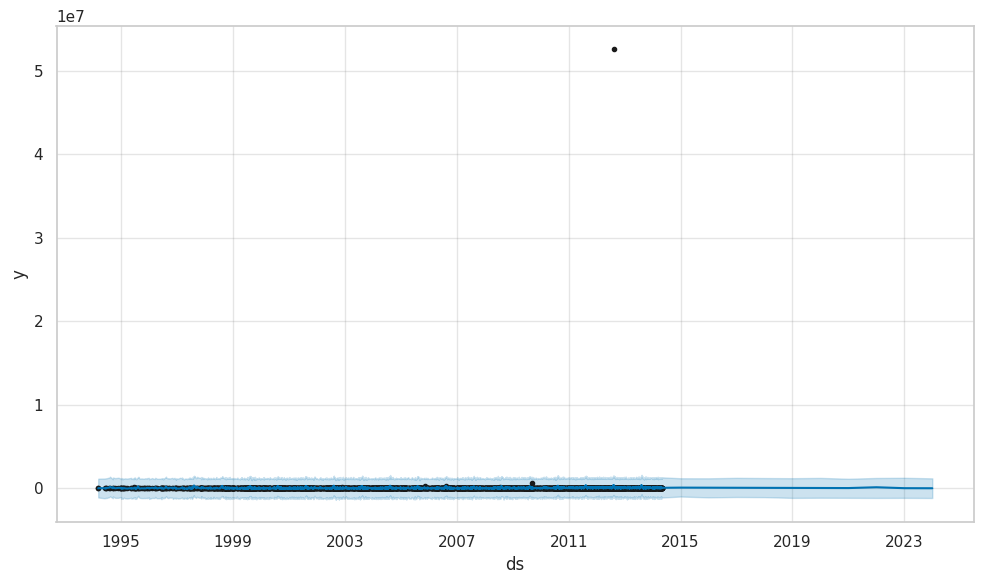

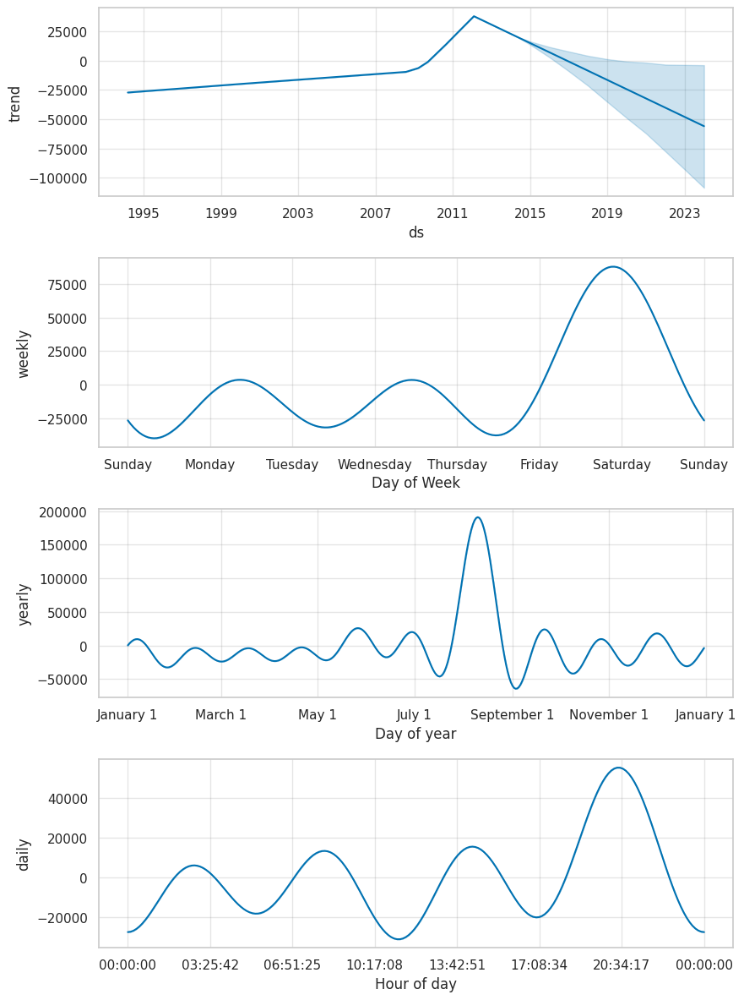

In [296]:
model = Prophet()
model.fit(washington_seconds_sum_df)
future_trends_wa = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_wa = model.predict(future_trends_wa)
model.plot(forecast_trends_wa);
figures = model.plot_components(forecast_trends_wa)
plt.savefig('forecast_washington_components.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/vvw3sqfx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/b_nwxudc.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35646', 'data', 'file=/tmp/tmpbq1r_08b/vvw3sqfx.json', 'init=/tmp/tmpbq1r_08b/b_nwxudc.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelc_tlvvzs/prophet_model-20241008201817.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:17 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


Displaying forecasting model graph and components graph for Florida to show possibilities of UFO showings over next 10 years


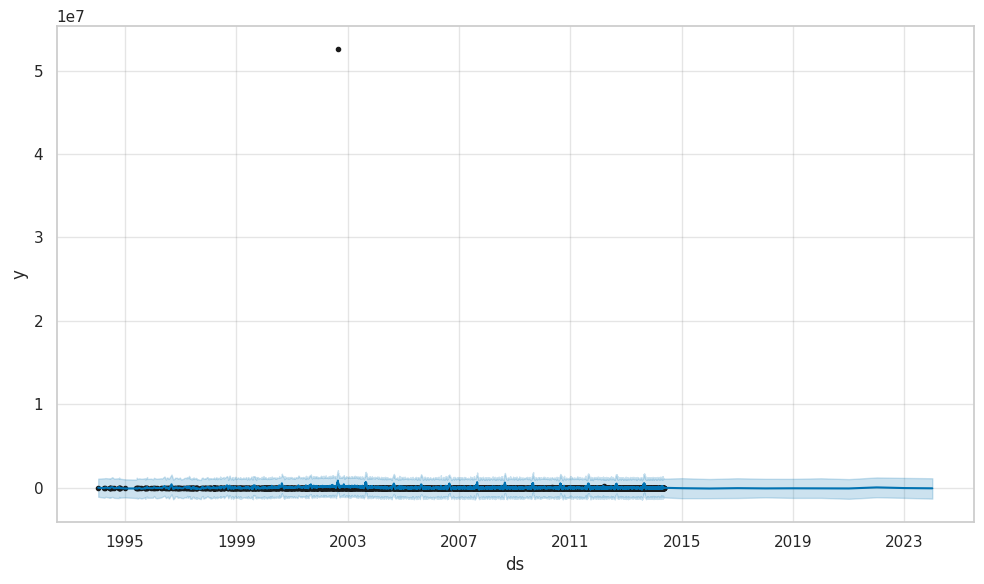

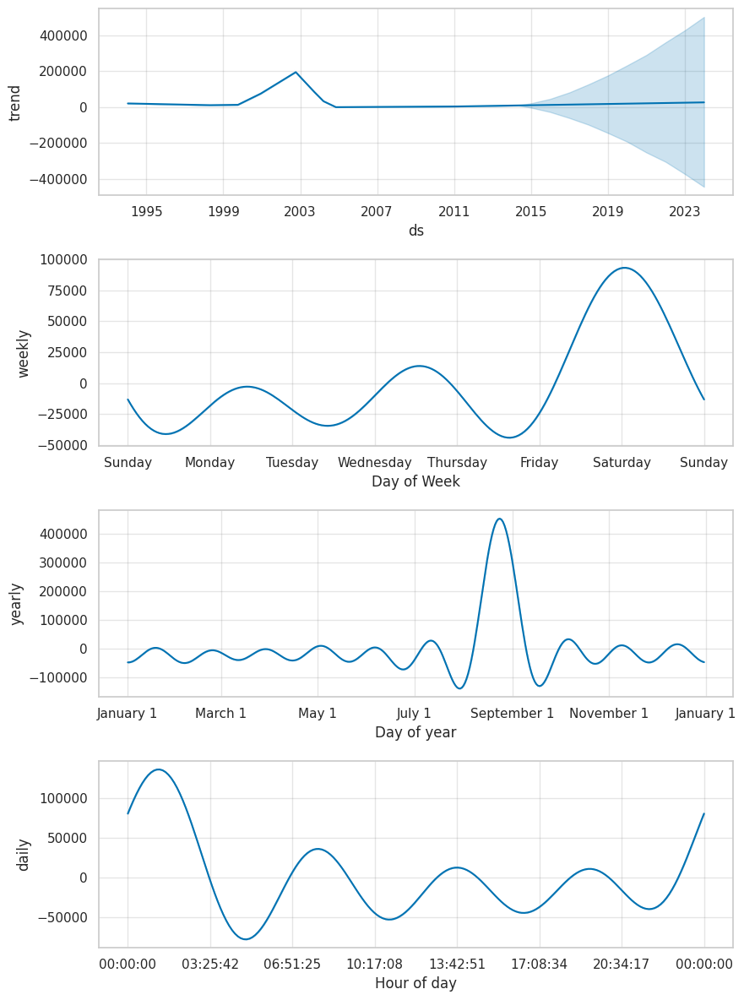

In [297]:
model = Prophet()
model.fit(florida_seconds_sum_df)
florida_future = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
fl_forecast = model.predict(florida_future)
print('Displaying forecasting model graph and components graph for Florida to show possibilities of UFO showings over next 10 years')
model.plot(fl_forecast);
figures = model.plot_components(fl_forecast)
plt.savefig('forecast_florida_components.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/ctts8mv6.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/muhkxwbj.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=74644', 'data', 'file=/tmp/tmpbq1r_08b/ctts8mv6.json', 'init=/tmp/tmpbq1r_08b/muhkxwbj.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelhxzqwr0a/prophet_model-20241008201823.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:23 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:25 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


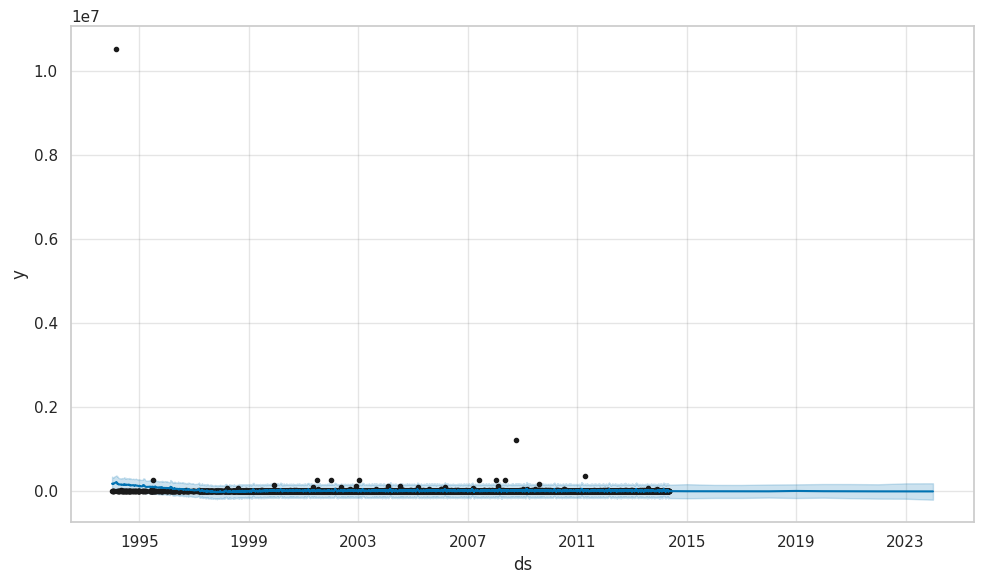

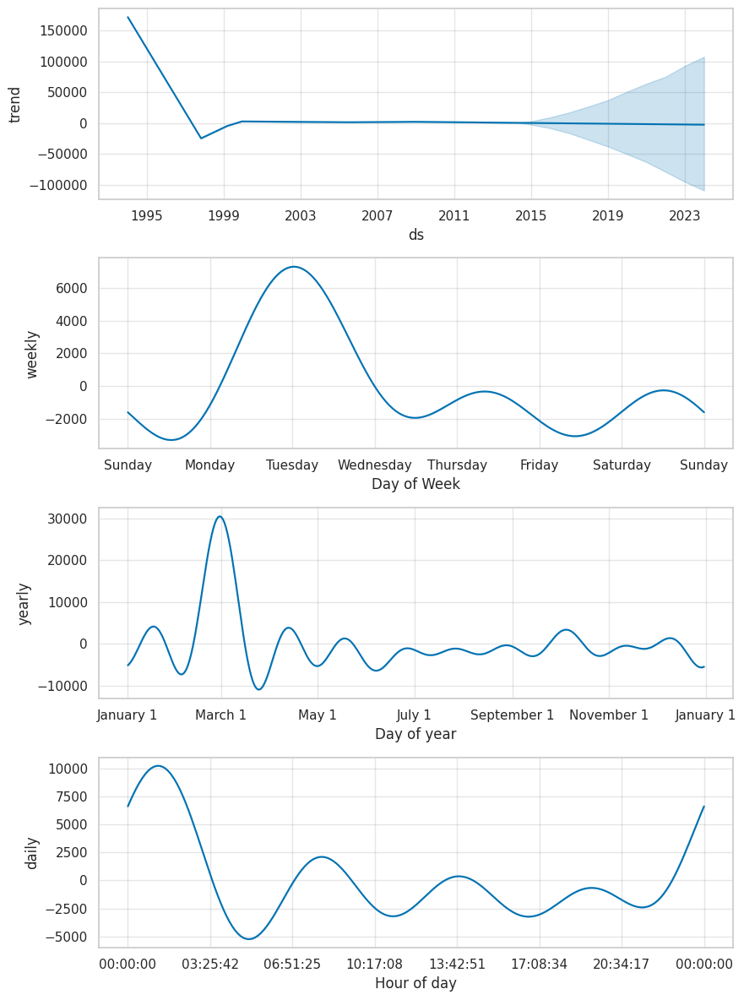

In [298]:
model = Prophet()
model.fit(california_seconds_sum_df)
california_future = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
ca_forecast = model.predict(california_future)
model.plot(ca_forecast);
figures = model.plot_components(ca_forecast)
plt.savefig('forecast_california_components.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/7d_jvgzl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/ycuvfvwa.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=31936', 'data', 'file=/tmp/tmpbq1r_08b/7d_jvgzl.json', 'init=/tmp/tmpbq1r_08b/ycuvfvwa.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modeleu8efejc/prophet_model-20241008201830.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:30 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


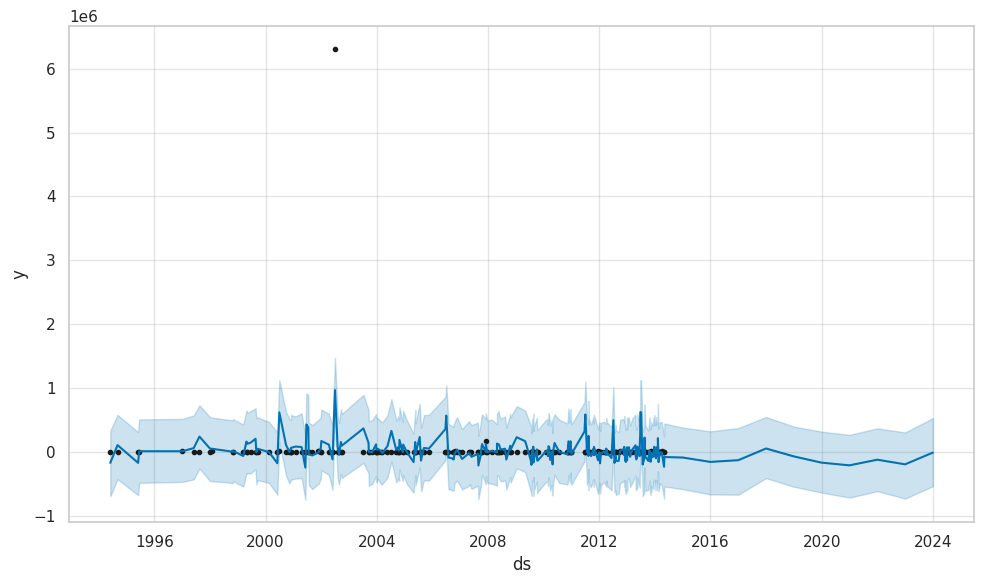

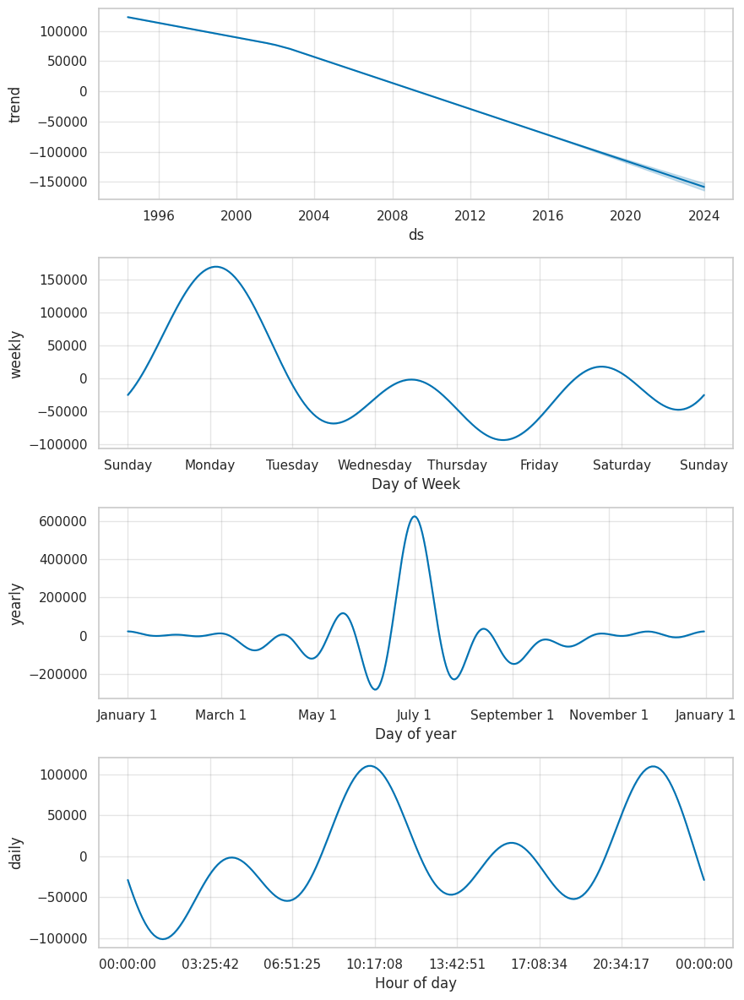

In [299]:
model = Prophet()
model.fit(hawaii_seconds_sum_df)
future_trends_hi = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_hi = model.predict(future_trends_hi)
model.plot(forecast_trends_hi);
figures = model.plot_components(forecast_trends_hi)
plt.savefig('forecast_hawaii_components.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/vwgrjq_o.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/ybt6nut7.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=53337', 'data', 'file=/tmp/tmpbq1r_08b/vwgrjq_o.json', 'init=/tmp/tmpbq1r_08b/ybt6nut7.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelnspa5pal/prophet_model-20241008201835.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


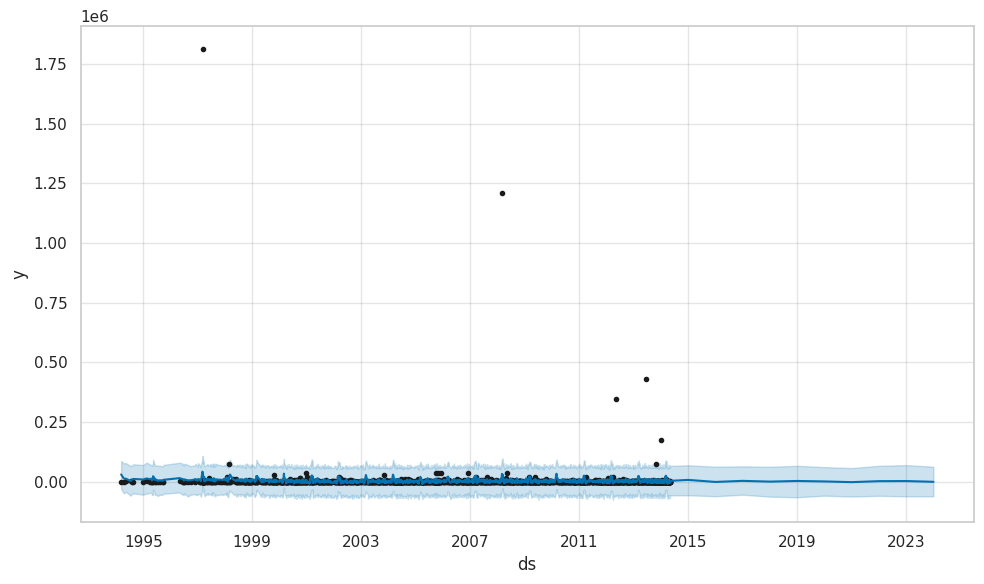

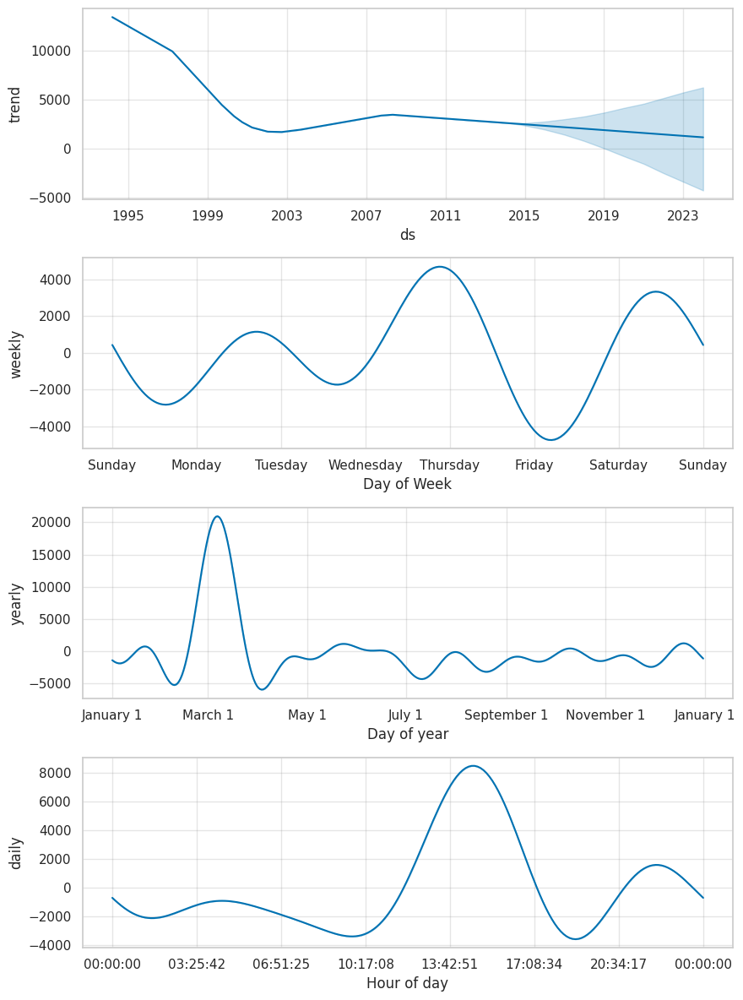

In [300]:
model = Prophet()
model.fit(arizona_seconds_sum_df)
future_trends_az = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_az = model.predict(future_trends_az)
model.plot(forecast_trends_az);
figures = model.plot_components(forecast_trends_az)
plt.savefig('forecast_arizona_components.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/43l95dla.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/feqc97gt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=19448', 'data', 'file=/tmp/tmpbq1r_08b/43l95dla.json', 'init=/tmp/tmpbq1r_08b/feqc97gt.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modeltfr6k8a3/prophet_model-20241008201839.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:39 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:39 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


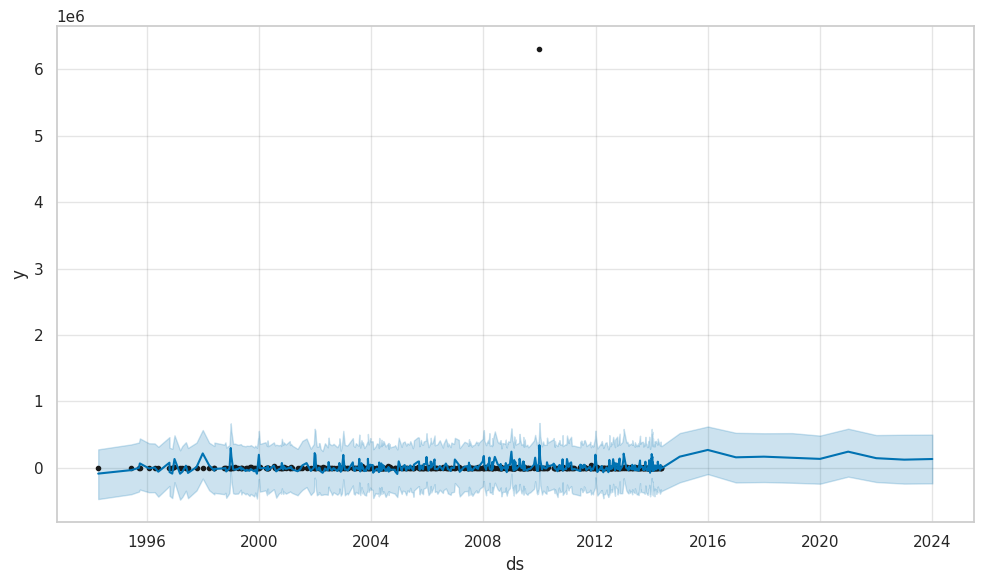

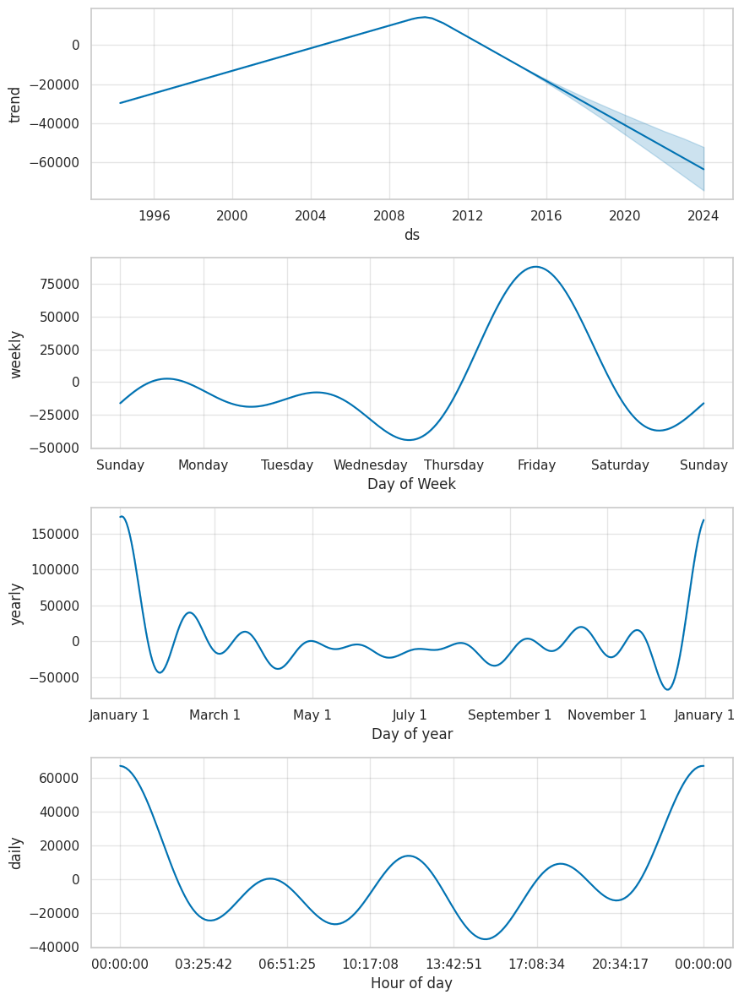

In [301]:
model = Prophet()
model.fit(louisiana_seconds_sum_df)
future_trends_la = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_la = model.predict(future_trends_la)
model.plot(forecast_trends_la);
figures = model.plot_components(forecast_trends_la)
plt.savefig('forecast_louisiana_components.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/79dckk2r.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/9tf5uznz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84089', 'data', 'file=/tmp/tmpbq1r_08b/79dckk2r.json', 'init=/tmp/tmpbq1r_08b/9tf5uznz.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_model4_8az2xg/prophet_model-20241008201843.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


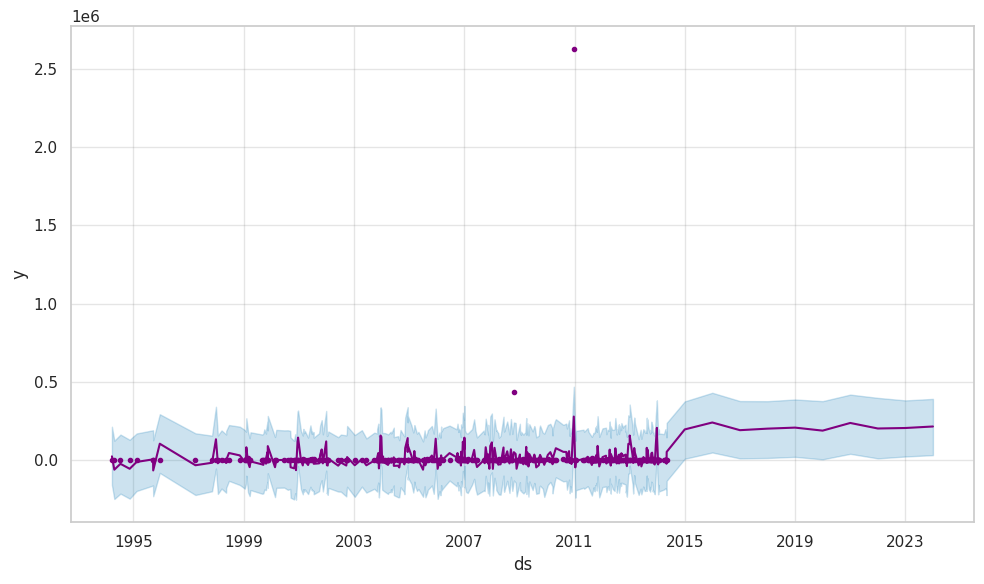

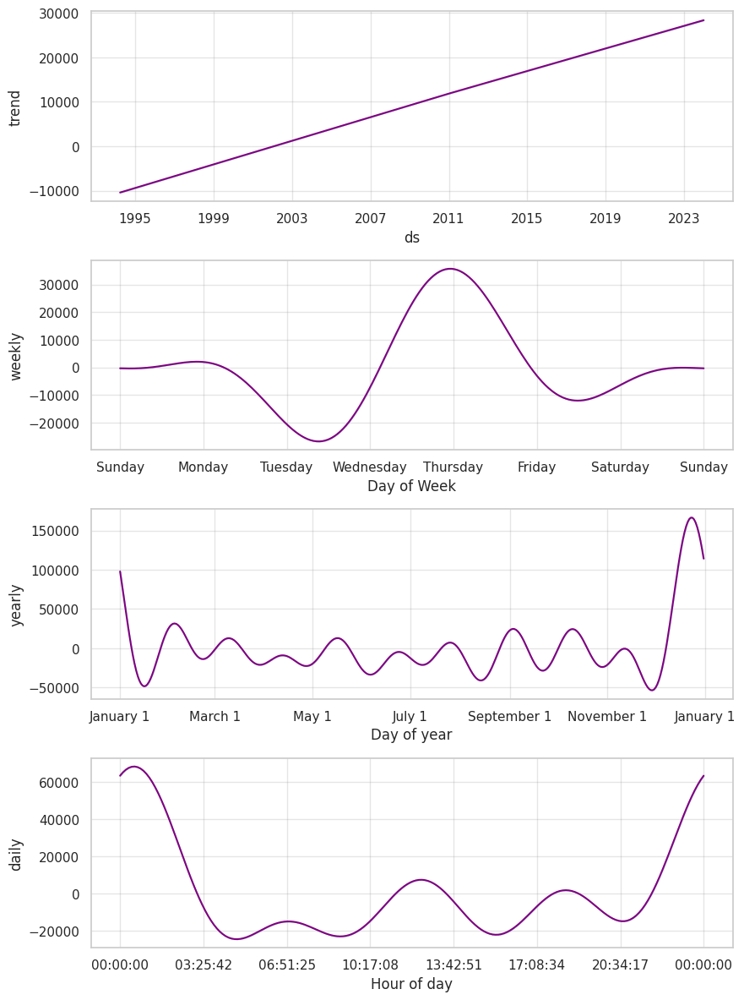

In [302]:
import matplotlib.pyplot as plt


# Fit the Prophet model
model = Prophet()
model.fit(mississippi_seconds_sum_df)

# Create future dataframe for forecasting
future_trends_mississippi = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_mississippi = model.predict(future_trends_mississippi)

# Generate the forecast plot
fig = model.plot(forecast_trends_mississippi)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('purple')

# Plot the forecast components
figures = model.plot_components(forecast_trends_mississippi)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('purple')

# Save the figures
plt.savefig('forecast_mississippi_components_purple.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/40lurg5w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/i7pz47e8.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7595', 'data', 'file=/tmp/tmpbq1r_08b/40lurg5w.json', 'init=/tmp/tmpbq1r_08b/i7pz47e8.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modeluq8_gdyu/prophet_model-20241008201848.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


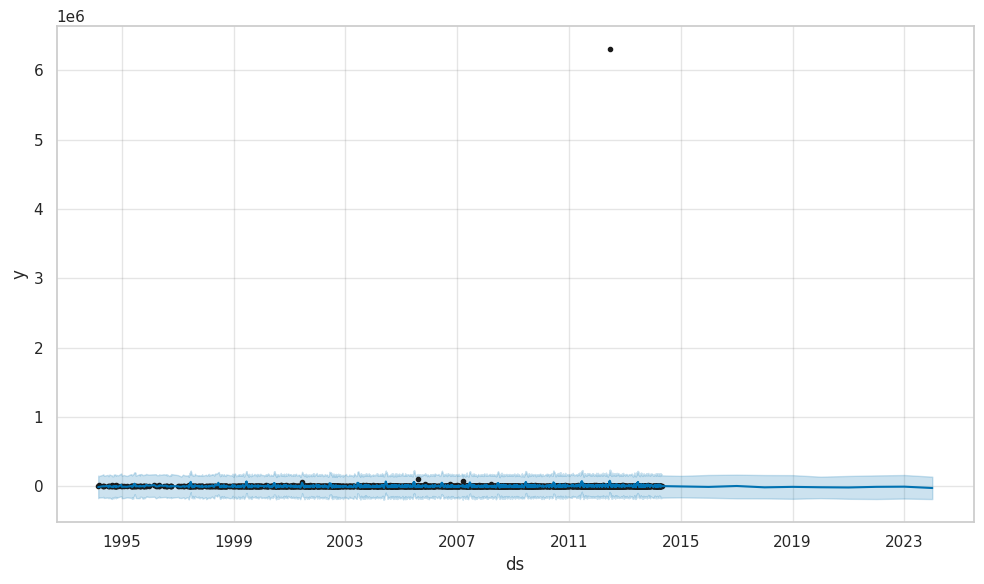

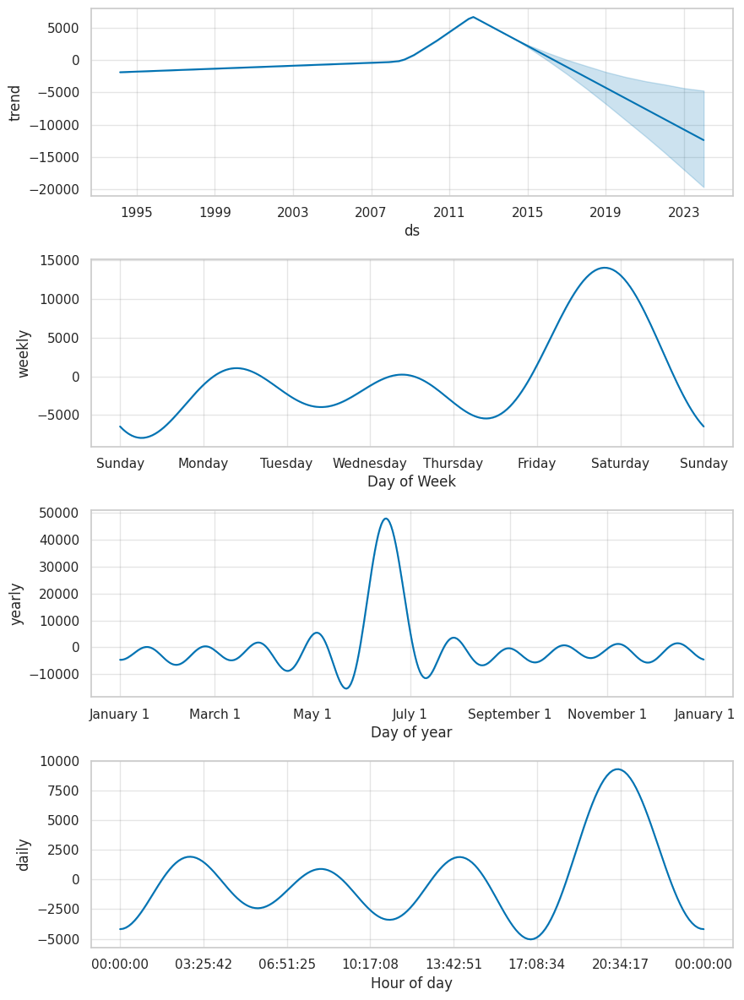

In [303]:
model = Prophet()
model.fit(newyork_seconds_sum_df)
future_trends_newyork = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_newyork = model.predict(future_trends_newyork)
model.plot(forecast_trends_newyork);
figures = model.plot_components(forecast_trends_newyork)
plt.savefig('forecast_newyork_components.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/l5xzyms2.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/aae2_ywf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=65792', 'data', 'file=/tmp/tmpbq1r_08b/l5xzyms2.json', 'init=/tmp/tmpbq1r_08b/aae2_ywf.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_models1euek7f/prophet_model-20241008201852.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:53 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


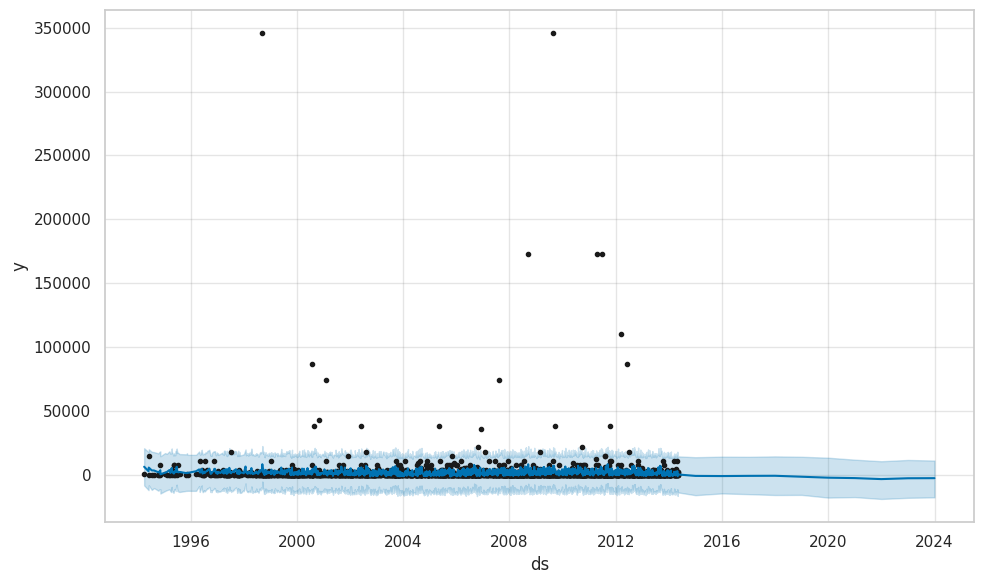

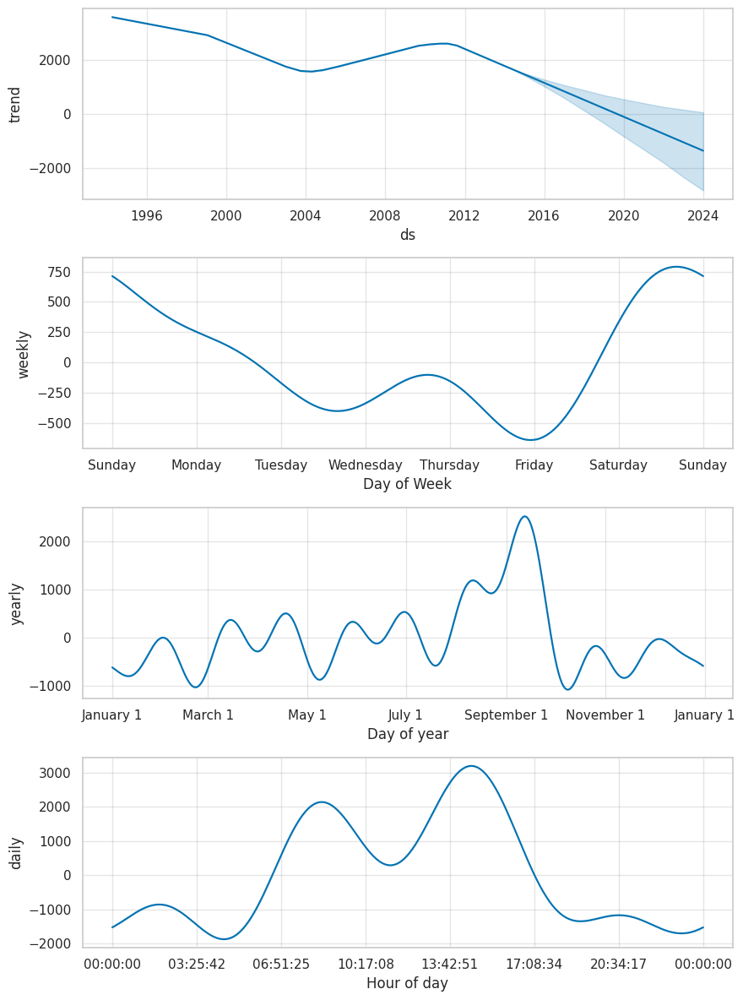

In [304]:
model = Prophet()
model.fit(texas_seconds_sum_df)
future_trends_texas = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_texas = model.predict(future_trends_texas)
model.plot(forecast_trends_texas);
figures = model.plot_components(forecast_trends_texas)
plt.savefig('forecast_texas_components.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/nzeg_e_i.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/8nteldkr.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=1651', 'data', 'file=/tmp/tmpbq1r_08b/nzeg_e_i.json', 'init=/tmp/tmpbq1r_08b/8nteldkr.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelnzz7tnzm/prophet_model-20241008201857.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:18:57 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:18:57 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


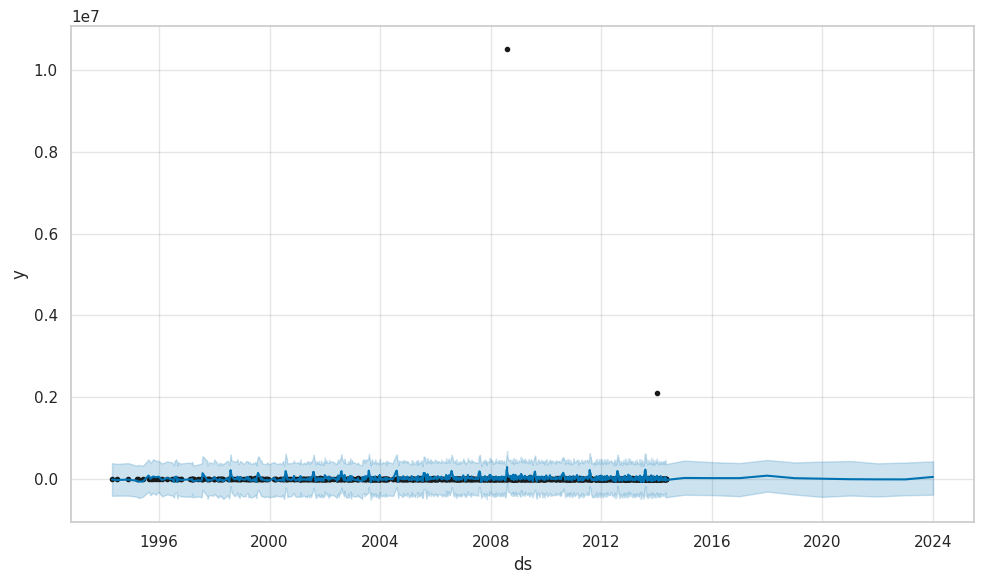

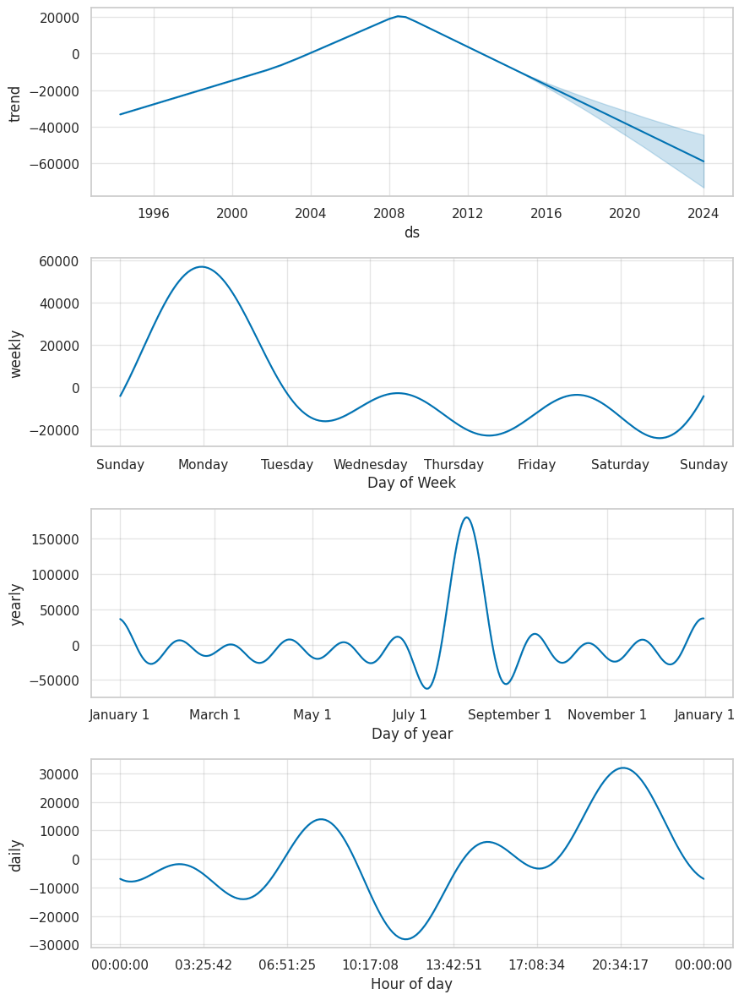

In [305]:
model = Prophet()
model.fit(virginia_seconds_sum_df)
future_trends_virginia = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_virginia = model.predict(future_trends_virginia)
model.plot(forecast_trends_virginia);
figures = model.plot_components(forecast_trends_virginia)
plt.savefig('forecast_virginia_components.png')

In [306]:
!pip install seaborn

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/moj5gqcq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/2874er57.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25146', 'data', 'file=/tmp/tmpbq1r_08b/moj5gqcq.json', 'init=/tmp/tmpbq1r_08b/2874er57.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_model7om84oz0/prophet_model-20241008201918.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:19:18 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:19:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


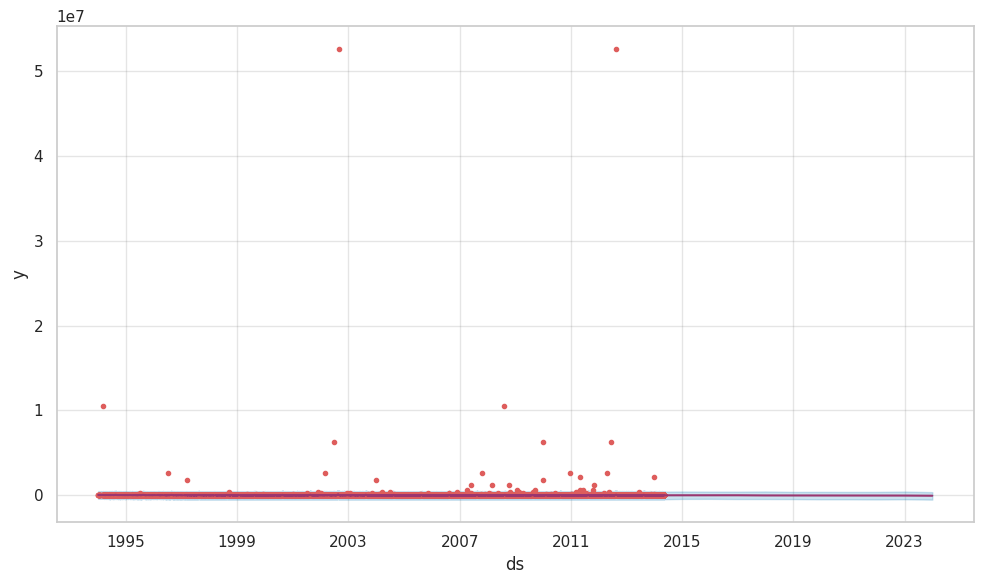

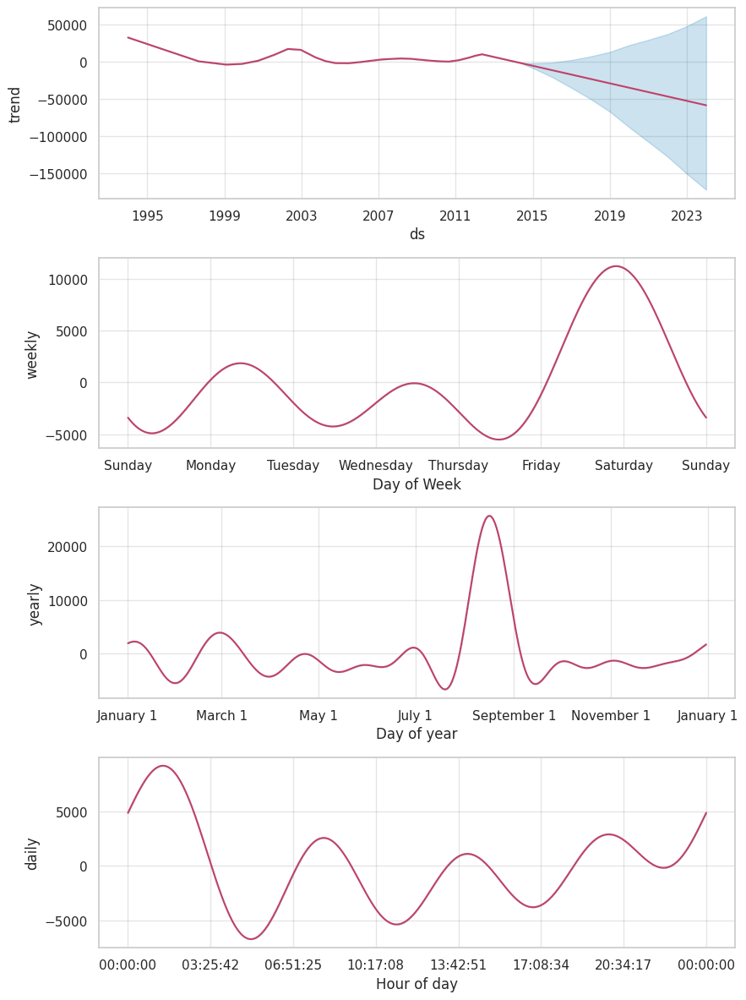

In [307]:
import matplotlib.pyplot as plt
import seaborn as sns

# Fit the Prophet model
model = Prophet()
model.fit(national_seconds_sum_df)

# Create future dataframe for forecasting
future_trends_national = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_national = model.predict(future_trends_national)

# Generate the forecast plot
fig = model.plot(forecast_trends_national)

# Customize the colors for the forecast plot using flare palette
ax = fig.gca()
lines = ax.get_lines()
colors = sns.color_palette("flare", len(lines)) # Get colors from flare palette
for line, color in zip(lines, colors):
    line.set_color(color)

# Plot the forecast components
figures = model.plot_components(forecast_trends_national)

# Change colors for components plot using flare palette
for ax in figures.get_axes():
    lines = ax.get_lines()
    colors = sns.color_palette("flare", len(lines))
    for line, color in zip(lines, colors):
        line.set_color(color)

# Make the layout tighter to remove extra whitespace
plt.tight_layout()

# Save the figures
plt.savefig('forecast_national_components_flare.png')

## 4.2 Predictions of Shape Data
Made a copy of Prophet Form Df 1994 and on, added form column to group shapes into smaller subsets

In [308]:
form_cleaned_us_ufo_df_new = cleaned_us_ufo_df_new.copy()
form_cleaned_us_ufo_df_new.head()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year
10885,1994-01-01 00:00:00,el segundo,ca,us,other,1800.0,33.9191667,-118.415556,1994
10887,1994-01-01 18:00:00,ringwood,nj,us,unknown,240.0,41.1133333,-74.245833,1994
24283,1994-01-03 23:30:00,albuquerque (30-60 miles west of city),nm,us,triangle,240.0,35.0844444,-106.650556,1994
24471,1994-01-04 23:00:00,susquehanna,pa,us,triangle,300.0,41.9433333,-75.600000,1994
11891,1994-01-12 18:00:00,cedar key,fl,us,chevron,300.0,29.1383333,-83.035278,1994


In [309]:
# add a new empty column to ufo_shape_data labeled 'form'
form_cleaned_us_ufo_df_new['form'] = ''
form_cleaned_us_ufo_df_new.head()
# if value in ufo_shape_data_df['shape'] column equals cigar, circle, round, sphere, oval, egg, cylinder or disk, then value in ufo_shape_data_df['form'] column equals circular
form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['shape'].isin(['cigar', 'circle', 'round', 'sphere', 'oval', 'egg', 'cylinder', 'disk']), 'form'] = 'circular'
# if value in ufo_shape_data_df['shape'] column equals fireball, flare, flash or light, then value in ufo_shape_data_df['form'] column equals light
form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['shape'].isin(['fireball', 'flare', 'flash', 'light']), 'form'] = 'light'
# if value in ufo_shape_data_df['shape'] column equals chevron, delta, triangle, pyramid or cone, then value in ufo_shape_data_df['form'] column equals triangle
form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['shape'].isin(['chevron', 'delta', 'triangle', 'pyramid', 'cone']), 'form'] = 'triangle'
# if value in ufo_shape_data_df['shape'] column equals formation, changed or changing, then value in ufo_shape_data_df['form'] column equals formation_changing
form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['shape'].isin(['formation', 'changed', 'changing']), 'form'] = 'formation_changing'
# if value in ufo_shape_data_df['shape'] column equals diamond, hexagon, crescent, cross, rectangle or teardrop, then value in ufo_shape_data_df['form'] column equals geometric
form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['shape'].isin(['diamond', 'hexagon', 'crescent', 'cross', 'rectangle', 'teardrop']), 'form'] = 'geometric'
# if value in ufo_shape_data_df['shape'] column equals other or unknown, then value in ufo_shape_data_df['form'] column equals other_unknown
form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['shape'].isin(['other', 'unknown']), 'form'] = 'other_unknown'
form_cleaned_us_ufo_df_new.head()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form
10885,1994-01-01 00:00:00,el segundo,ca,us,other,1800.0,33.9191667,-118.415556,1994,other_unknown
10887,1994-01-01 18:00:00,ringwood,nj,us,unknown,240.0,41.1133333,-74.245833,1994,other_unknown
24283,1994-01-03 23:30:00,albuquerque (30-60 miles west of city),nm,us,triangle,240.0,35.0844444,-106.650556,1994,triangle
24471,1994-01-04 23:00:00,susquehanna,pa,us,triangle,300.0,41.9433333,-75.600000,1994,triangle
11891,1994-01-12 18:00:00,cedar key,fl,us,chevron,300.0,29.1383333,-83.035278,1994,triangle


In [310]:
form_cleaned_us_ufo_df_new.head()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form
10885,1994-01-01 00:00:00,el segundo,ca,us,other,1800.0,33.9191667,-118.415556,1994,other_unknown
10887,1994-01-01 18:00:00,ringwood,nj,us,unknown,240.0,41.1133333,-74.245833,1994,other_unknown
24283,1994-01-03 23:30:00,albuquerque (30-60 miles west of city),nm,us,triangle,240.0,35.0844444,-106.650556,1994,triangle
24471,1994-01-04 23:00:00,susquehanna,pa,us,triangle,300.0,41.9433333,-75.600000,1994,triangle
11891,1994-01-12 18:00:00,cedar key,fl,us,chevron,300.0,29.1383333,-83.035278,1994,triangle


### Light

In [311]:
light_1994_df = form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['form'] == 'light']
light_1994_seconds_sum_df = pd.pivot_table(light_1994_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
light_1994_seconds_sum_df = light_1994_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
light_1994_seconds_sum_df.reset_index(inplace=True)
light_1994_seconds_sum_df.head()

,datetime,total_seconds
0,1994-01-17 05:00:00,2.0
1,1994-01-18 19:00:00,3600.0
2,1994-03-08 19:15:00,5.0
3,1994-03-15 00:30:00,300.0
4,1994-03-28 17:00:00,2400.0


In [ ]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
light_1994_seconds_sum_df = light_1994_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(light_1994_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_light_1994 = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_light_1994 = model.predict(future_trends_light_1994)

# Generate the forecast plot
fig = model.plot(forecast_trends_light_1994)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('#e7298a')

# Plot the forecast components
figures = model.plot_components(forecast_trends_light_1994)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('#e7298a')

# Save the figures
# plt.savefig('forecast_light_1994_components_purple.png')

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/rpzvy0pu.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/sjojgdgh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=89072', 'data', 'file=/tmp/tmpbq1r_08b/rpzvy0pu.json', 'init=/tmp/tmpbq1r_08b/sjojgdgh.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_model3nyv9q4q/prophet_model-20241008201956.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:19:56 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:20:03 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


### Circular

In [ ]:
circular_1994_df = form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['form'] == 'circular']
circular_1994_seconds_sum_df = pd.pivot_table(circular_1994_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
circular_1994_seconds_sum_df = circular_1994_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
circular_1994_seconds_sum_df.reset_index(inplace=True)
circular_1994_seconds_sum_df.head()

In [ ]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
circular_1994_seconds_sum_df = circular_1994_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(circular_1994_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_circular_1994 = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_circular_1994 = model.predict(future_trends_circular_1994)

# Generate the forecast plot
fig = model.plot(forecast_trends_circular_1994)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('#1b9e77')

# Plot the forecast components
figures = model.plot_components(forecast_trends_circular_1994)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('#1b9e77')



### Triangle

In [ ]:
triangle_1994_df = form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['form'] == 'triangle']
triangle_1994_seconds_sum_df = pd.pivot_table(triangle_1994_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
triangle_1994_seconds_sum_df = triangle_1994_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
triangle_1994_seconds_sum_df.reset_index(inplace=True)
triangle_1994_seconds_sum_df.head()

In [ ]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
triangle_1994_seconds_sum_df = triangle_1994_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(triangle_1994_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_triangle_1994 = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_triangle_1994 = model.predict(future_trends_triangle_1994)

# Generate the forecast plot
fig = model.plot(forecast_trends_triangle_1994)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('#ffa300')

# Plot the forecast components
figures = model.plot_components(forecast_trends_triangle_1994)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('#ffa300')



### other_unknown

In [ ]:
other_unknown_1994_df = form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['form'] == 'other_unknown']
other_unknown_1994_seconds_sum_df = pd.pivot_table(other_unknown_1994_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
other_unknown_1994_seconds_sum_df = other_unknown_1994_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
other_unknown_1994_seconds_sum_df.reset_index(inplace=True)
other_unknown_1994_seconds_sum_df.head()

In [ ]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
other_unknown_1994_seconds_sum_df = other_unknown_1994_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(other_unknown_1994_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_other_unknown_1994 = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_other_unknown_1994 = model.predict(future_trends_triangle_1994)

# Generate the forecast plot
fig = model.plot(forecast_trends_other_unknown_1994)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('mediumpurple')

# Plot the forecast components
figures = model.plot_components(forecast_trends_other_unknown_1994)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('mediumpurple')

#8968CD

### geometric

In [ ]:
geometric_1994_df = form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['form'] == 'geometric']
geometric_1994_seconds_sum_df = pd.pivot_table(geometric_1994_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
geometric_1994_seconds_sum_df = geometric_1994_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
geometric_1994_seconds_sum_df.reset_index(inplace=True)
geometric_1994_seconds_sum_df.head()

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/62wdt13b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/18n6jl2d.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10330', 'data', 'file=/tmp/tmpbq1r_08b/62wdt13b.json', 'init=/tmp/tmpbq1r_08b/18n6jl2d.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelm3v1_kyx/prophet_model-20241008202042.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:20:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:20:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


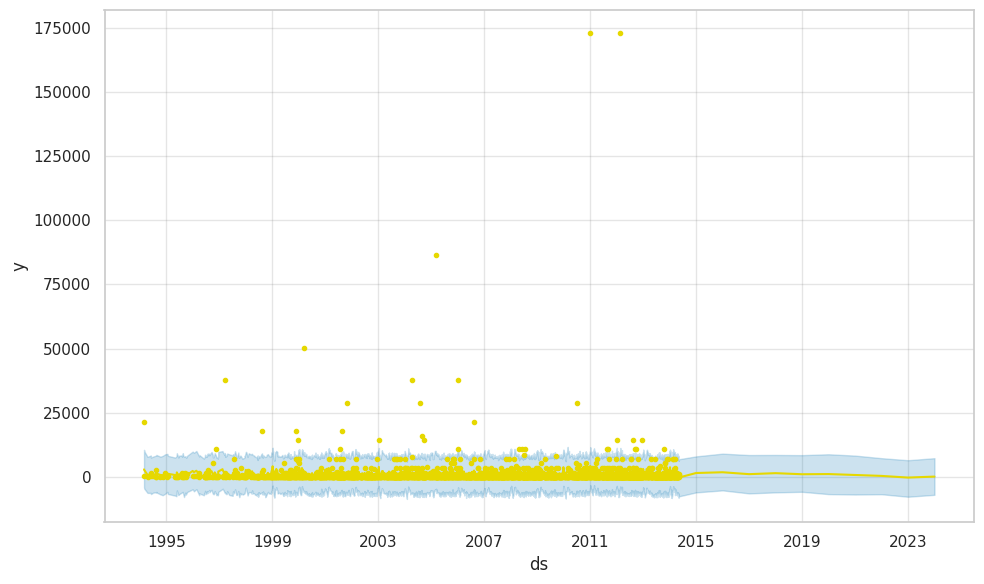

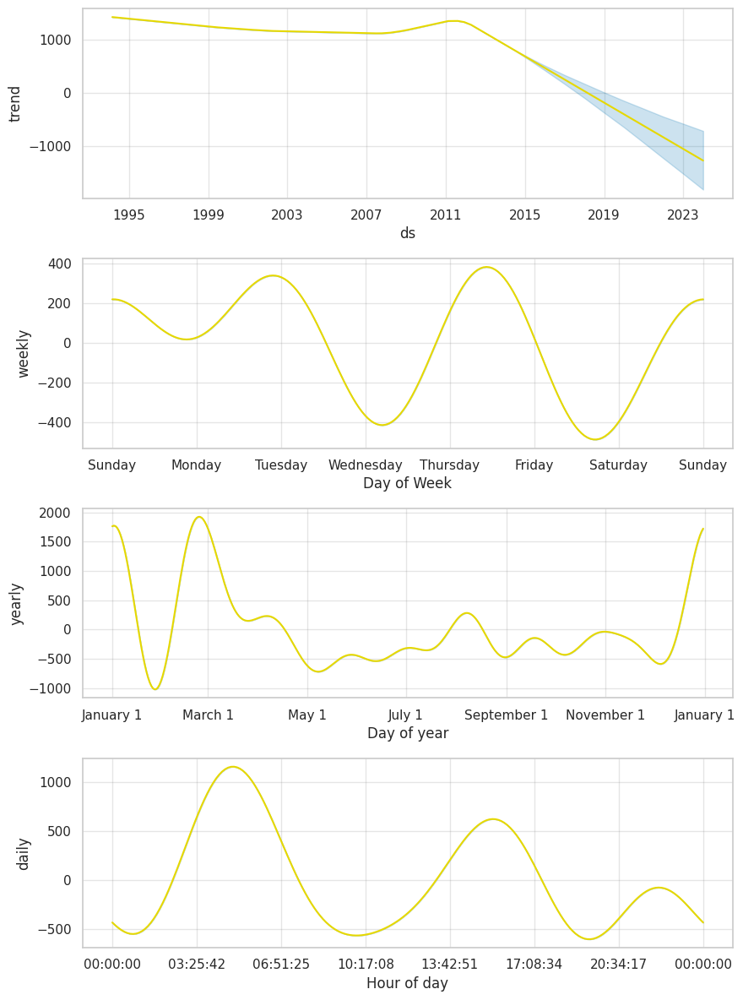

In [320]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
geometric_1994_seconds_sum_df = geometric_1994_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(geometric_1994_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_geometric_1994 = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_geometric_1994 = model.predict(future_trends_geometric_1994)

# Generate the forecast plot
fig = model.plot(forecast_trends_geometric_1994)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('#e6d800')

# Plot the forecast components
figures = model.plot_components(forecast_trends_geometric_1994)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('#e6d800')



### formation_changing

In [321]:
formation_changing_1994_df = form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['form'] == 'formation_changing']
formation_changing_1994_seconds_sum_df = pd.pivot_table(formation_changing_1994_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
formation_changing_1994_seconds_sum_df = formation_changing_1994_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
formation_changing_1994_seconds_sum_df.reset_index(inplace=True)
formation_changing_1994_seconds_sum_df.head()

,datetime,total_seconds
0,1994-06-01 08:00:00,900.0
1,1994-06-01 17:00:00,300.0
2,1994-06-08 22:30:00,600.0
3,1994-07-12 21:40:00,420.0
4,1994-08-07 22:30:00,2700.0


DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/2mue66dh.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/xn6yyajx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=7792', 'data', 'file=/tmp/tmpbq1r_08b/2mue66dh.json', 'init=/tmp/tmpbq1r_08b/xn6yyajx.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelq3t_8f7r/prophet_model-20241008202046.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:20:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:20:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing
/usr/local/lib/python3.10/dist-packages/prophet/forecaster.py:1854: FutureWarning: 'Y' is deprecated and will be removed in a future version, please use 'YE' instead.
  dates = pd.date_range(


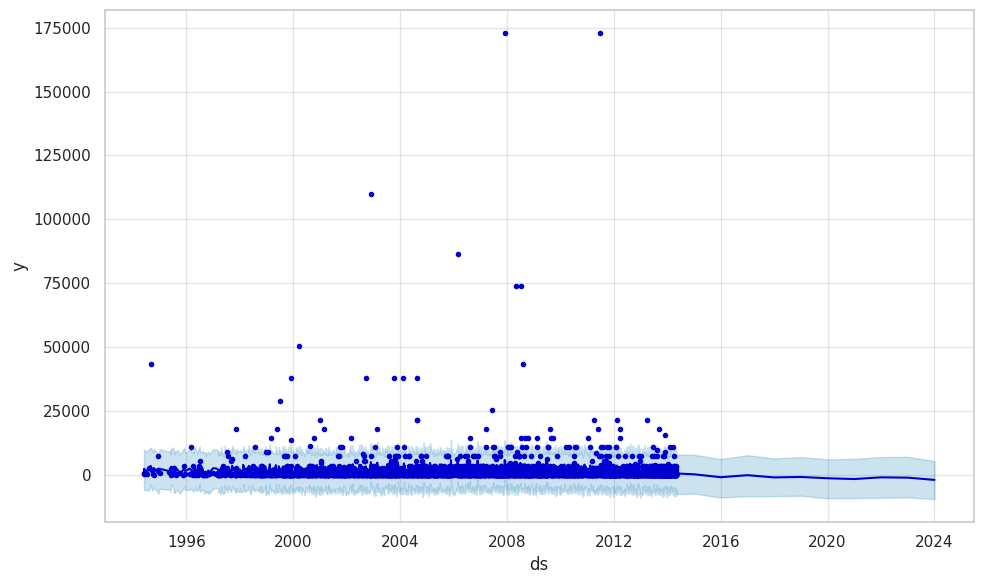

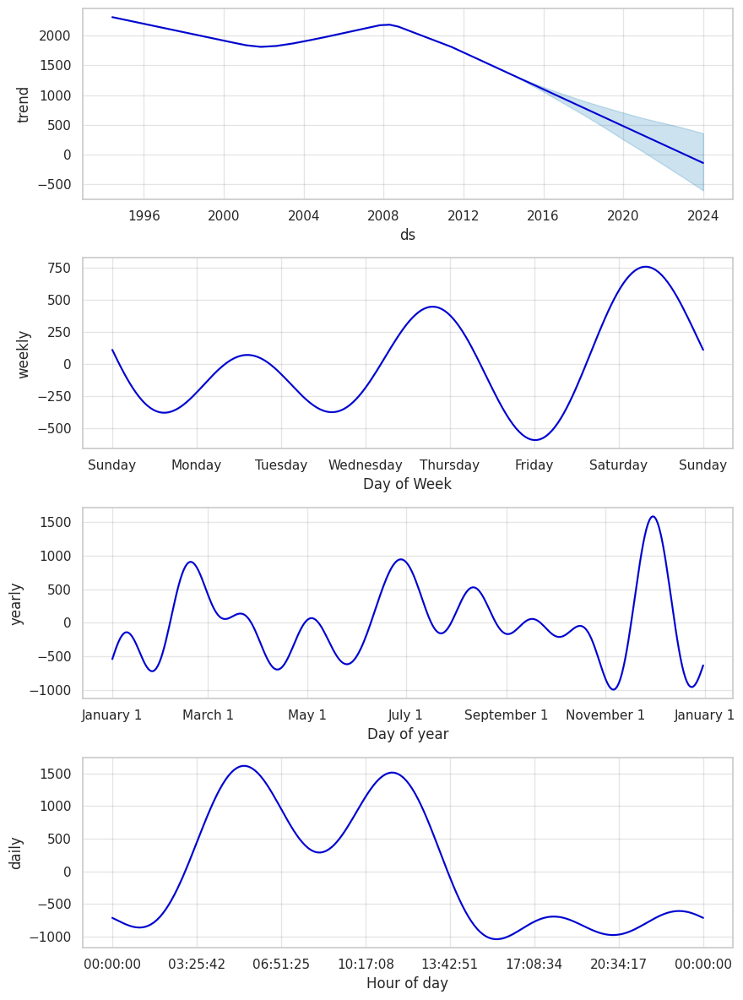

In [322]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
formation_changing_1994_seconds_sum_df = formation_changing_1994_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(formation_changing_1994_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_formation_changing_1994 = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_formation_changing_1994 = model.predict(future_trends_formation_changing_1994)

# Generate the forecast plot
fig = model.plot(forecast_trends_formation_changing_1994)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('#0000D1')

# Plot the forecast components
figures = model.plot_components(forecast_trends_formation_changing_1994)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('#0000D1')



DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/l6w48ju_.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/xvx_fctp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84959', 'data', 'file=/tmp/tmpbq1r_08b/l6w48ju_.json', 'init=/tmp/tmpbq1r_08b/xvx_fctp.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modeluq5g0tn7/prophet_model-20241008202052.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:20:52 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:20:58 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


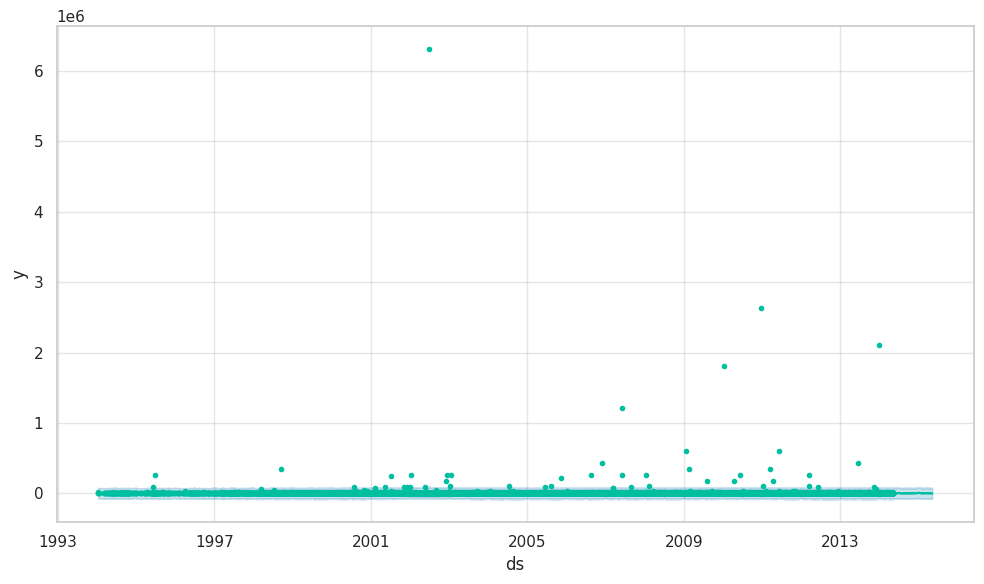

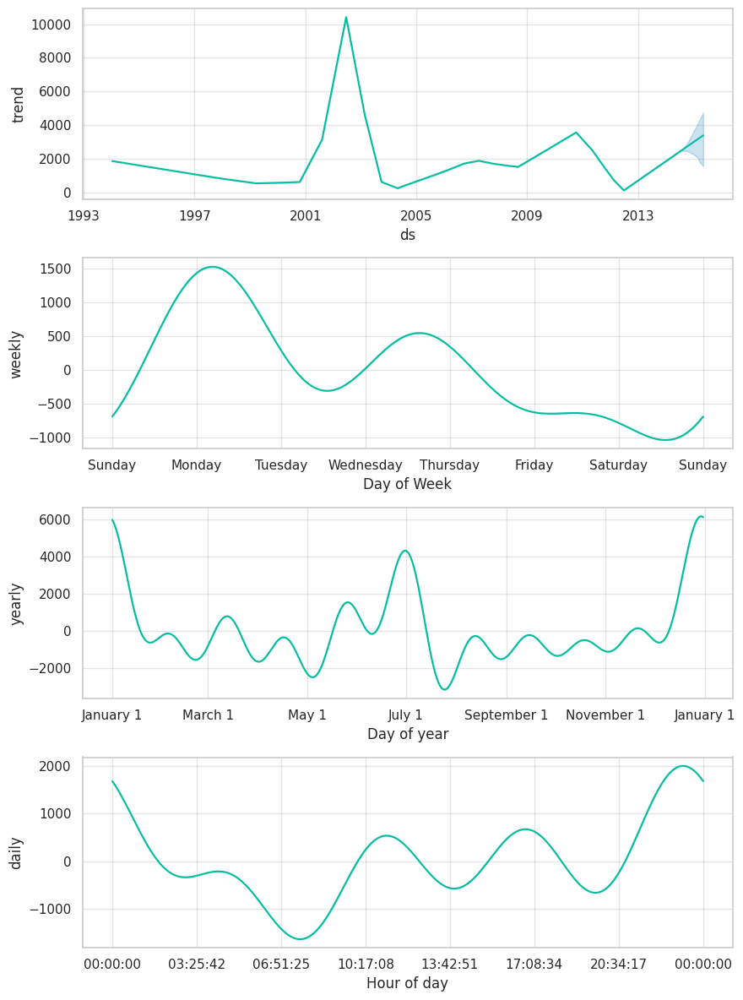

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/ah9u234c.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/l1fi7_lt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73233', 'data', 'file=/tmp/tmpbq1r_08b/ah9u234c.json', 'init=/tmp/tmpbq1r_08b/l1fi7_lt.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelciqov17q/prophet_model-20241008202106.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:21:06 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:21:11 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


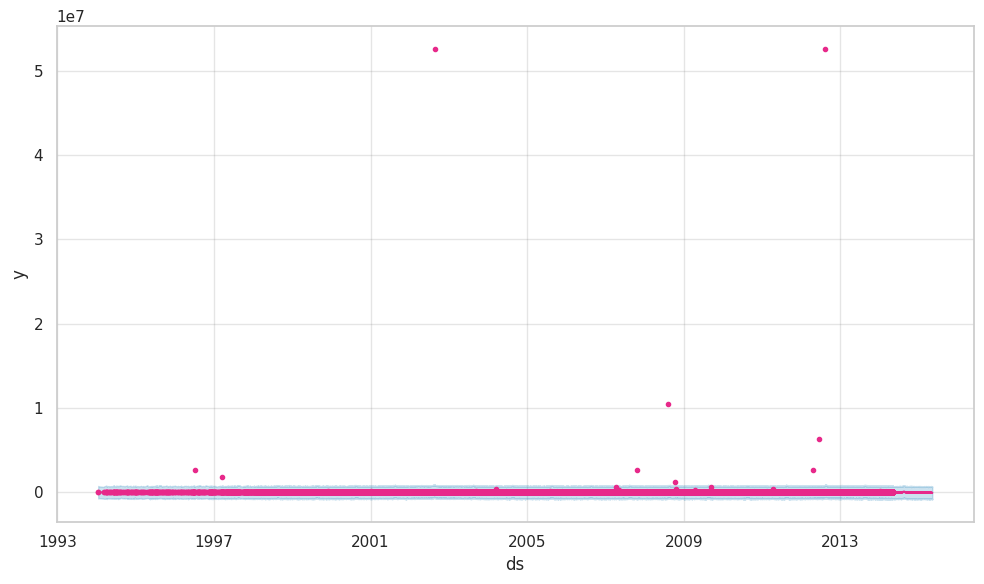

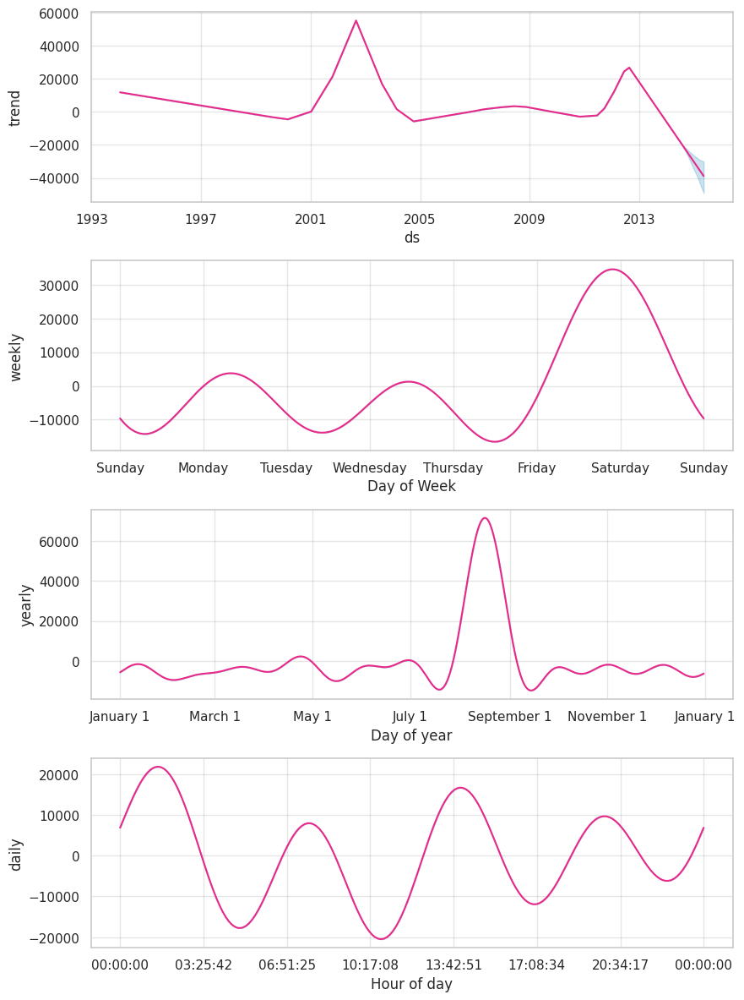

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/sq21bht0.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/w05nkksh.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=48685', 'data', 'file=/tmp/tmpbq1r_08b/sq21bht0.json', 'init=/tmp/tmpbq1r_08b/w05nkksh.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelsf989j0q/prophet_model-20241008202117.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:21:17 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:21:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


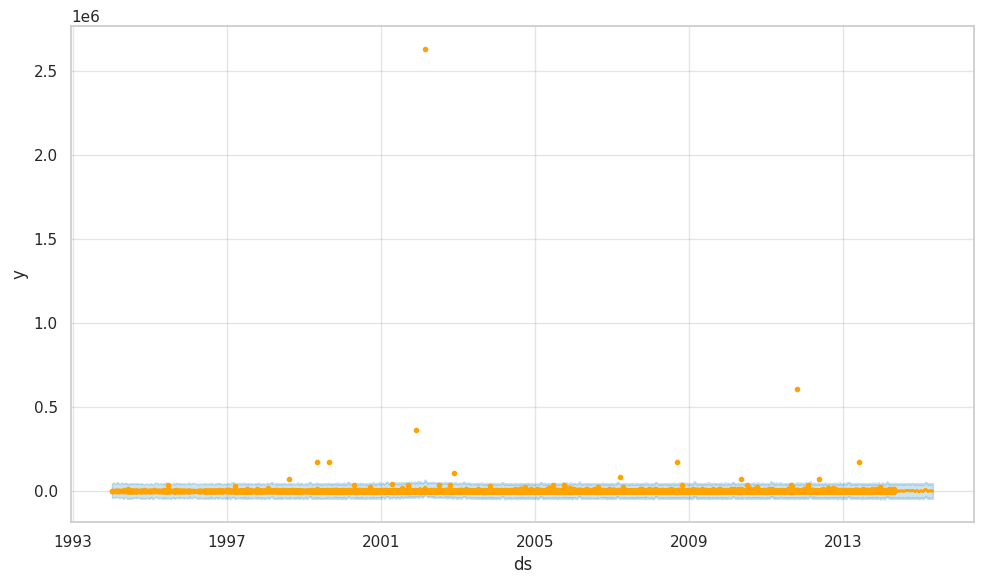

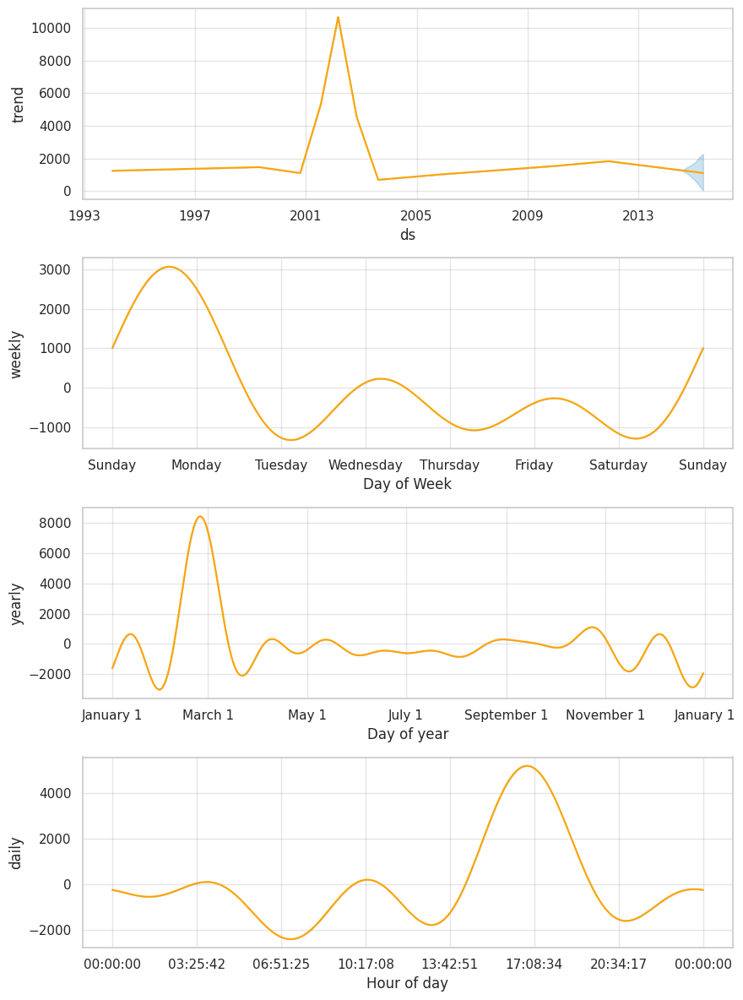

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/ci3fz2d5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/hqeqz1vf.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5148', 'data', 'file=/tmp/tmpbq1r_08b/ci3fz2d5.json', 'init=/tmp/tmpbq1r_08b/hqeqz1vf.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_model9h9dyrmi/prophet_model-20241008202124.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:21:24 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:21:26 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


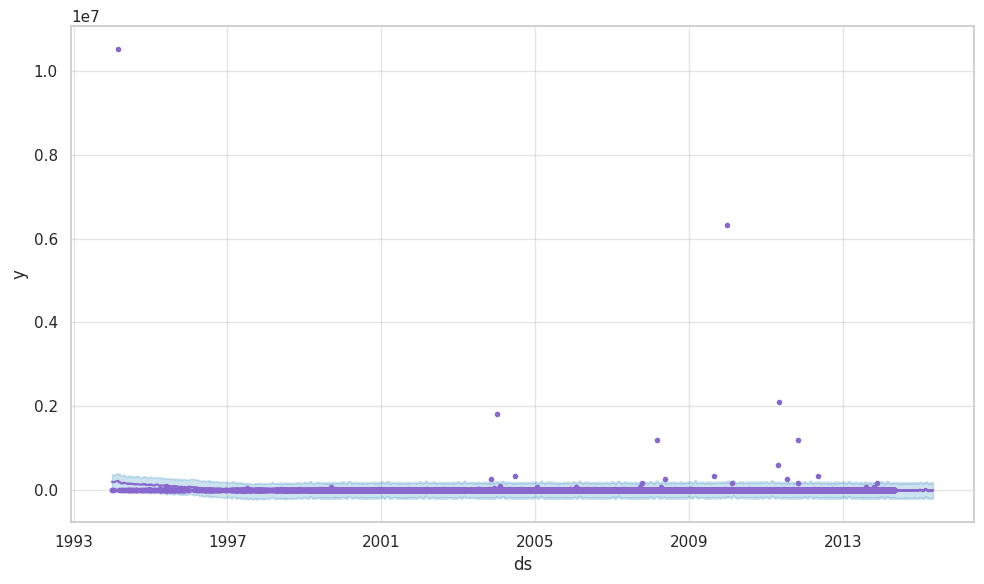

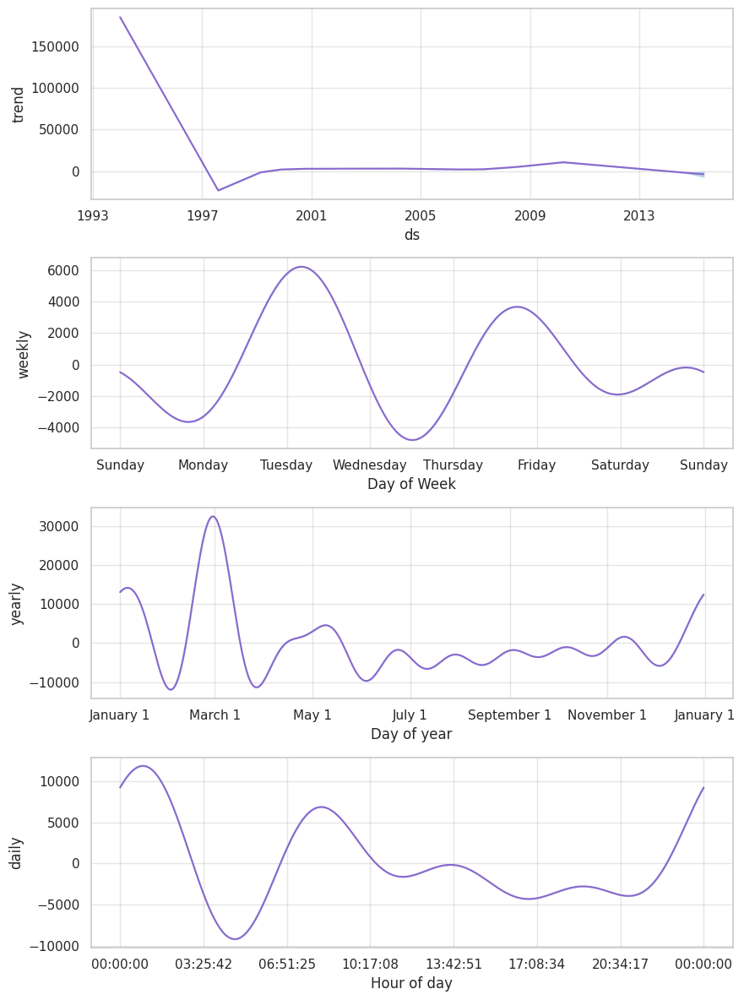

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/ie_8rm8p.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/3oz60d__.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=73688', 'data', 'file=/tmp/tmpbq1r_08b/ie_8rm8p.json', 'init=/tmp/tmpbq1r_08b/3oz60d__.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modelilqv1jjn/prophet_model-20241008202130.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:21:30 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:21:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


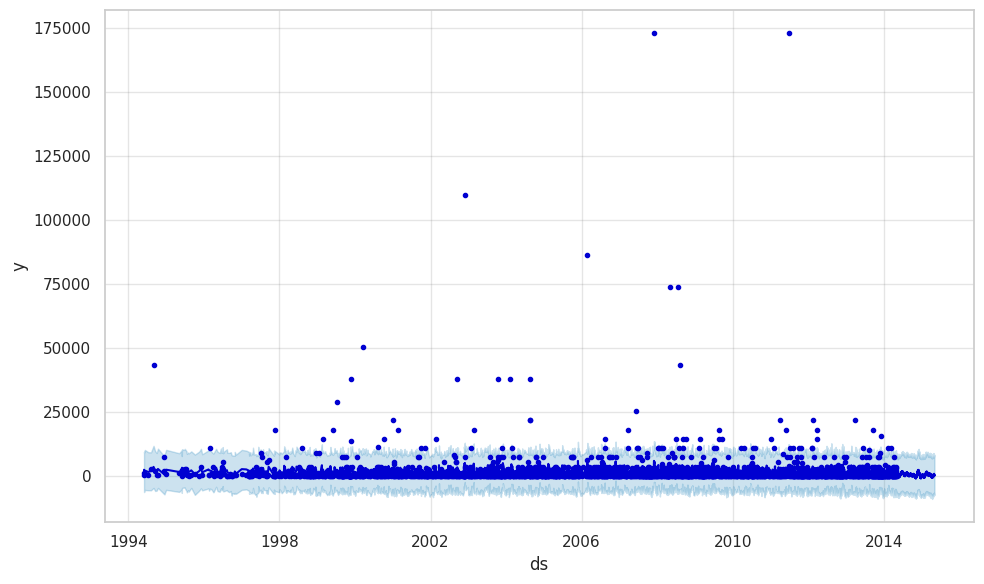

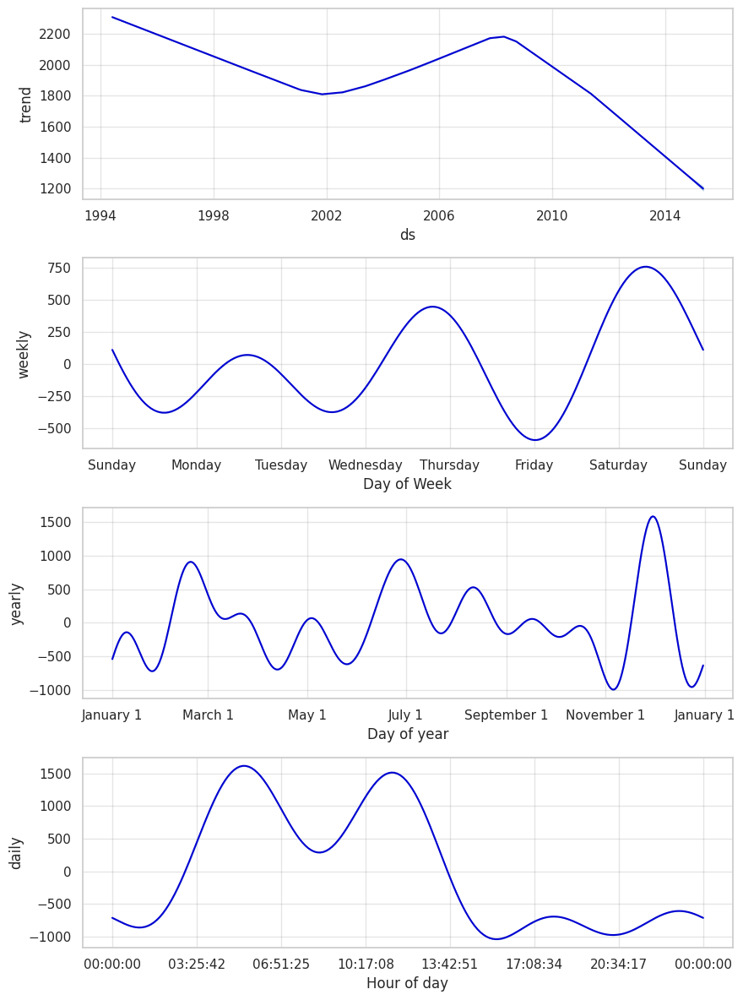

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/3hrv2hsq.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/s53ld2us.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=22124', 'data', 'file=/tmp/tmpbq1r_08b/3hrv2hsq.json', 'init=/tmp/tmpbq1r_08b/s53ld2us.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_model79125lg4/prophet_model-20241008202135.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:21:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:21:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


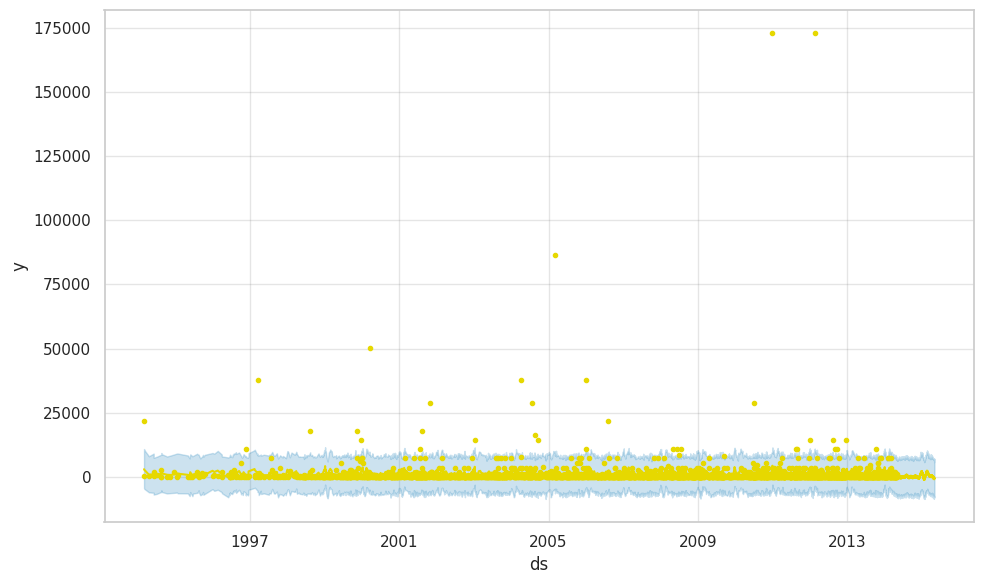

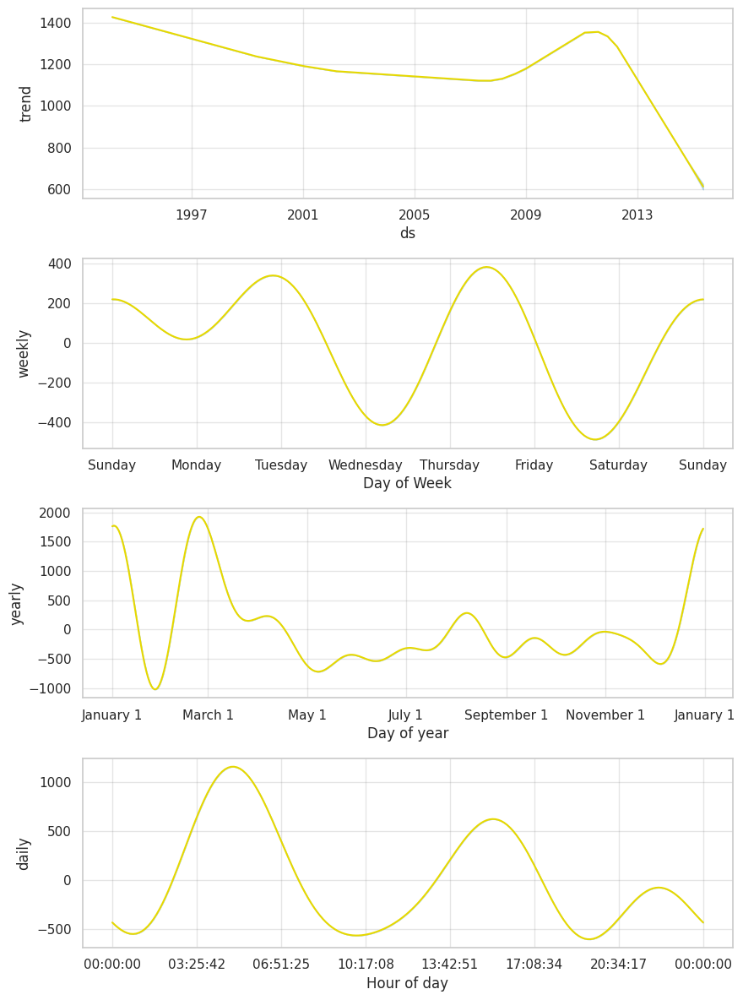

In [323]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt

# Define form colors
form_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'other_unknown': '#8968CD',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800'
}

# Forecasting parameters
forecasting_period = 365  # Define the period for forecasting
forecasting_frequency = 'D'  # Daily frequency

# Iterate over each form in form_colors and fit the Prophet model for each
for form, color in form_colors.items():
    # Filter the dataframe for the specific form
    form_df = form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['form'] == form]

    # Create pivot table for total seconds
    form_seconds_sum_df = pd.pivot_table(form_df,
                                         index='datetime',
                                         values='duration (seconds)',
                                         aggfunc='sum').round(1)

    # Rename columns and reset index
    form_seconds_sum_df = form_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
    form_seconds_sum_df.reset_index(inplace=True)

    # Rename columns to 'ds' and 'y' for Prophet
    form_seconds_sum_df = form_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

    # Fit the Prophet model
    model = Prophet()
    model.fit(form_seconds_sum_df)

    # Create future dataframe for forecasting
    future_trends_form = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
    forecast_trends_form = model.predict(future_trends_form)

    # Plot the forecast for the current form
    fig = model.plot(forecast_trends_form)
    ax = fig.gca()

    # Set the color for the lines
    lines = ax.get_lines()
    for line in lines:
        line.set_color(color)  # Use the corresponding color for the form

    # Plot the forecast components
    figures = model.plot_components(forecast_trends_form)

    # Set the color for the components plot
    for ax in figures.get_axes():
        lines = ax.get_lines()
        for line in lines:
            line.set_color(color)  # Use the corresponding color for the form

    # Display the plots for each form
    plt.show()


In [ ]:
import pandas as pd
from prophet import Prophet
import matplotlib.pyplot as plt

# Define form colors
form_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'other_unknown': '#8968CD',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800'
}

# Forecasting parameters
forecasting_period = 365  # Define the period for forecasting
forecasting_frequency = 'D'  # Daily frequency

# Create a figure for plotting all forms on the same plot
plt.figure(figsize=(12, 6))

# Iterate over each form in form_colors and fit the Prophet model for each
for form, color in form_colors.items():
    # Filter the dataframe for the specific form
    form_df = form_cleaned_us_ufo_df_new.loc[form_cleaned_us_ufo_df_new['form'] == form]

    # Create pivot table for total seconds
    form_seconds_sum_df = pd.pivot_table(form_df,
                                         index='datetime',
                                         values='duration (seconds)',
                                         aggfunc='sum').round(1)

    # Rename columns and reset index
    form_seconds_sum_df = form_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
    form_seconds_sum_df.reset_index(inplace=True)

    # Rename columns to 'ds' and 'y' for Prophet
    form_seconds_sum_df = form_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

    # Fit the Prophet model
    model = Prophet()
    model.fit(form_seconds_sum_df)

    # Create future dataframe for forecasting
    future_trends_form = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
    forecast_trends_form = model.predict(future_trends_form)

    # Plot the forecast for the current form on the same plot
    plt.plot(forecast_trends_form['ds'], forecast_trends_form['yhat'], label=form, color=color)

# Set plot labels and title
plt.xlabel('Date', fontsize=12)
plt.ylabel('Forecasted Duration (seconds)', fontsize=12)
plt.title('Forecast of UFO Sightings Duration by Form', fontsize=16)

# Add a legend to differentiate between the forms
plt.legend(title='Form', fontsize=10)

# Display the combined plot
plt.tight_layout()
plt.show()


## 4.3 Predictions by State and Shape

#### Circle in hawaii

In [ ]:
hawaii_circle_df = circular_1994_df.loc[circular_1994_df['state'] == 'hi']

hawaii_circle_seconds_sum_df = pd.pivot_table(hawaii_circle_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
hawaii_circle_seconds_sum_df = hawaii_circle_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
hawaii_circle_seconds_sum_df.reset_index(inplace=True)
hawaii_circle_seconds_sum_df.head()

In [ ]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
hawaii_circle_seconds_sum_df = hawaii_circle_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(hawaii_circle_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_hawaii_circle = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_hawaii_circle = model.predict(future_trends_hawaii_circle)

# Generate the forecast plot
fig = model.plot(forecast_trends_hawaii_circle)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('#1b9e77')

# Plot the forecast components
figures = model.plot_components(forecast_trends_hawaii_circle)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('#00bfa0')



#### other unknown in cali

In [ ]:
cali_other_unknown_df = other_unknown_1994_df.loc[other_unknown_1994_df['state'] == 'ca']

cali_other_unknown_seconds_sum_df = pd.pivot_table(cali_other_unknown_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
cali_other_unknown_seconds_sum_df = cali_other_unknown_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
cali_other_unknown_seconds_sum_df.reset_index(inplace=True)
cali_other_unknown_seconds_sum_df.head()

DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/wm9u2u3w.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/zn3qhkfw.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=78548', 'data', 'file=/tmp/tmpbq1r_08b/wm9u2u3w.json', 'init=/tmp/tmpbq1r_08b/zn3qhkfw.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_model4einv8rz/prophet_model-20241008202215.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
20:22:15 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:22:15 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


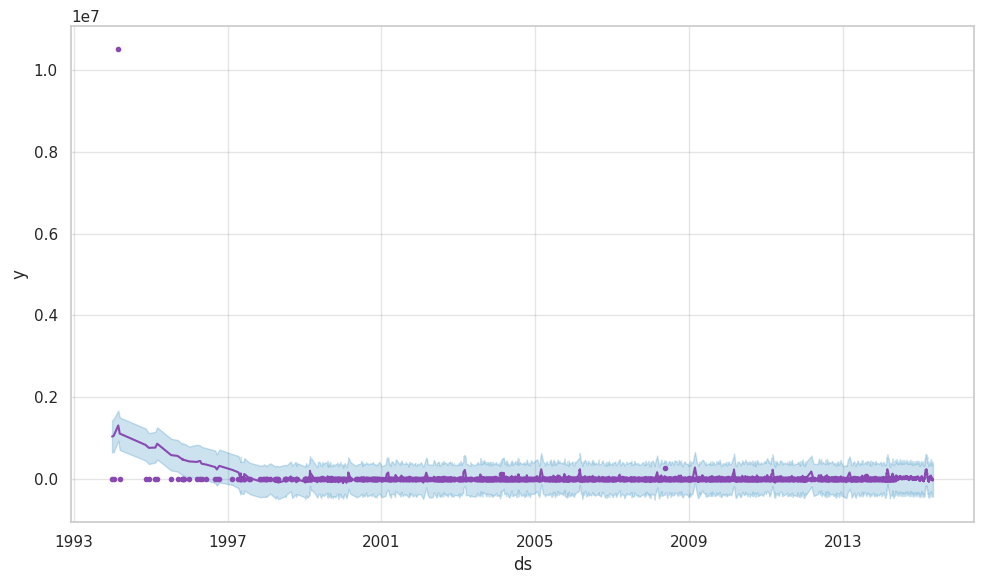

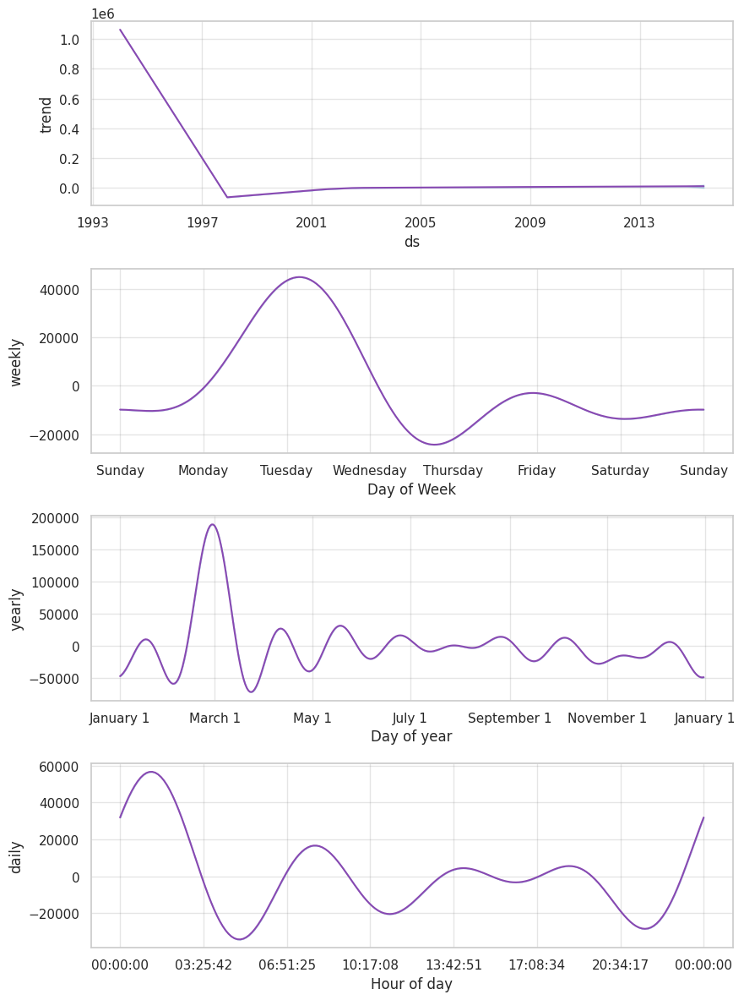

In [328]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
cali_other_unknown_seconds_sum_df = cali_other_unknown_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(cali_other_unknown_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_cali_other_unknown = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_cali_other_unknown = model.predict(future_trends_cali_other_unknown)

# Generate the forecast plot
fig = model.plot(forecast_trends_cali_other_unknown)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('#8849b2')

# Plot the forecast components
figures = model.plot_components(forecast_trends_cali_other_unknown)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('#8849b2')



In [329]:
cali_other_unknown_df.head()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form
10885,1994-01-01 00:00:00,el segundo,ca,us,other,1800.0,33.9191667,-118.415556,1994,other_unknown
14699,1994-01-15 23:00:00,acton,ca,us,unknown,1800.0,34.47,-118.195833,1994,other_unknown
30596,1994-03-01 01:00:00,menifee,ca,us,unknown,10526400.0,33.7283333,-117.145556,1994,other_unknown
31515,1994-03-15 01:00:00,avenal,ca,us,unknown,3000.0,36.0041667,-120.128056,1994,other_unknown
9054,1994-11-14 20:00:00,san diego,ca,us,other,420.0,32.7152778,-117.156389,1994,other_unknown


In [330]:
sacramento_other_unknown_df = cali_other_unknown_df.loc[cali_other_unknown_df['city'] == 'sacramento']
sacramento_other_unknown_df.head()

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form
26609,1995-02-15 20:00:00,sacramento,ca,us,unknown,45.0,38.5816667,-121.493333,1995,other_unknown
39622,1996-04-29 21:30:00,sacramento,ca,us,other,1800.0,38.5816667,-121.493333,1996,other_unknown
53838,1999-06-06 19:00:00,sacramento,ca,us,unknown,1200.0,38.5816667,-121.493333,1999,other_unknown
61696,1999-07-04 15:30:00,sacramento,ca,us,other,480.0,38.5816667,-121.493333,1999,other_unknown
30421,2002-03-11 12:00:00,sacramento,ca,us,other,2.0,38.5816667,-121.493333,2002,other_unknown


In [331]:
sacramento_other_unknown_seconds_sum_df = pd.pivot_table(sacramento_other_unknown_df,
                            index='datetime',
                            values='duration (seconds)',
                            aggfunc='sum').round(1)
sacramento_other_unknown_seconds_sum_df = sacramento_other_unknown_seconds_sum_df.rename(columns={'duration (seconds)': 'total_seconds'})
sacramento_other_unknown_seconds_sum_df.reset_index(inplace=True)
sacramento_other_unknown_seconds_sum_df.head()

,datetime,total_seconds
0,1995-02-15 20:00:00,45.0
1,1996-04-29 21:30:00,1800.0
2,1999-06-06 19:00:00,1200.0
3,1999-07-04 15:30:00,480.0
4,2002-03-11 12:00:00,2.0


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
INFO:prophet:n_changepoints greater than number of observations. Using 19.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/fp2mvs0g.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpbq1r_08b/bmmlk0jg.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.10/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=96718', 'data', 'file=/tmp/tmpbq1r_08b/fp2mvs0g.json', 'init=/tmp/tmpbq1r_08b/bmmlk0jg.json', 'output', 'file=/tmp/tmpbq1r_08b/prophet_modellkapv4zc/prophet_model-20241008202219.csv', 'method=optimize', 'algorithm=newton', 'iter=10000']
20:22:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
20:22:19 - cmdstanpy - INFO - Chain [1] done processing
INFO:

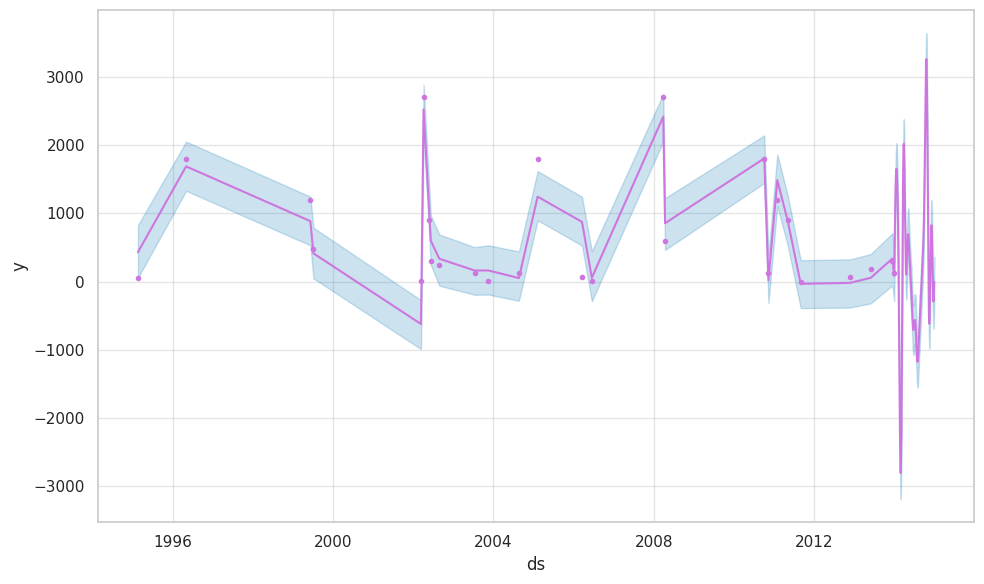

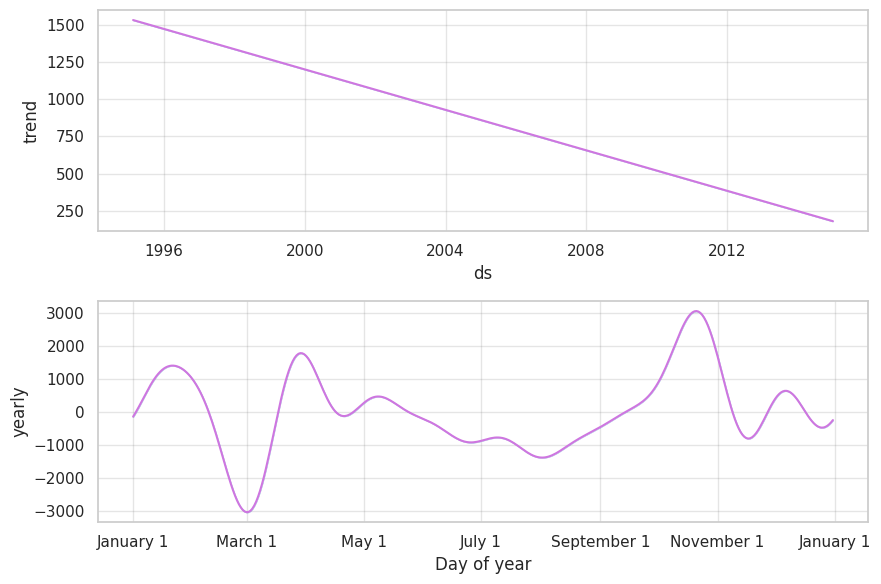

In [332]:
import matplotlib.pyplot as plt

# Rename the columns to 'ds' and 'y' before fitting the model
sacramento_other_unknown_seconds_sum_df = sacramento_other_unknown_seconds_sum_df.rename(columns={'datetime': 'ds', 'total_seconds': 'y'})

# Fit the Prophet model
model = Prophet()
model.fit(sacramento_other_unknown_seconds_sum_df)


# Create future dataframe for forecasting
future_trends_sacramento_other_unknown = model.make_future_dataframe(periods=forecasting_period, freq=forecasting_frequency)
forecast_trends_sacramento_other_unknown = model.predict(future_trends_sacramento_other_unknown)

# Generate the forecast plot
fig = model.plot(forecast_trends_sacramento_other_unknown)

# Customize the colors for the forecast plot (all purple)
ax = fig.gca()
lines = ax.get_lines()
for line in lines:
    line.set_color('#ce76e0')

# Plot the forecast components
figures = model.plot_components(forecast_trends_sacramento_other_unknown)

# Change colors for components plot
for ax in figures.get_axes():
    lines = ax.get_lines()
    for line in lines:
        line.set_color('#ce76e0')



# Phase 5: GeoMapping

In [333]:
#getting list of states from dataframe with 90 perenctile records
geocoding_top_states = us_ufo_state_top_df['state'].tolist()
geocoding_top_states

['az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa']

In [334]:
#convert states to uppercase to be able to match with publicly sourced data
states = [s.upper() for s in geocoding_top_states]
states

['AZ', 'CA', 'FL', 'HI', 'LA', 'MS', 'NY', 'TX', 'VA', 'WA']

Arizona, California, Hawaii, Louisiana, Mississippi, New York, Texas, Virginia, and Washington
'az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa'

In [335]:
abbreviation_to_name = {
    # https://en.wikipedia.org/wiki/List_of_states_and_territories_of_the_United_States#States.
    "AK": "Alaska",
    "AL": "Alabama",
    "AR": "Arkansas",
    "AZ": "Arizona",
    "CA": "California",
    "CO": "Colorado",
    "CT": "Connecticut",
    "DE": "Delaware",
    "FL": "Florida",
    "GA": "Georgia",
    "HI": "Hawaii",
    "IA": "Iowa",
    "ID": "Idaho",
    "IL": "Illinois",
    "IN": "Indiana",
    "KS": "Kansas",
    "KY": "Kentucky",
    "LA": "Louisiana",
    "MA": "Massachusetts",
    "MD": "Maryland",
    "ME": "Maine",
    "MI": "Michigan",
    "MN": "Minnesota",
    "MO": "Missouri",
    "MS": "Mississippi",
    "MT": "Montana",
    "NC": "North Carolina",
    "ND": "North Dakota",
    "NE": "Nebraska",
    "NH": "New Hampshire",
    "NJ": "New Jersey",
    "NM": "New Mexico",
    "NV": "Nevada",
    "NY": "New York",
    "OH": "Ohio",
    "OK": "Oklahoma",
    "OR": "Oregon",
    "PA": "Pennsylvania",
    "RI": "Rhode Island",
    "SC": "South Carolina",
    "SD": "South Dakota",
    "TN": "Tennessee",
    "TX": "Texas",
    "UT": "Utah",
    "VA": "Virginia",
    "VT": "Vermont",
    "WA": "Washington",
    "WI": "Wisconsin",
    "WV": "West Virginia",
    "WY": "Wyoming",
    # https://en.wikipedia.org/wiki/List_of_states_and_territories_of_the_United_States#Federal_district.
    "DC": "District of Columbia",
    # https://en.wikipedia.org/wiki/List_of_states_and_territories_of_the_United_States#Inhabited_territories.
    "AS": "American Samoa",
    "GU": "Guam GU",
    "MP": "Northern Mariana Islands",
    "PR": "Puerto Rico PR",
    "VI": "U.S. Virgin Islands",
}


#credit: https://gist.github.com/JeffPaine/3083347

In [336]:
#creating list of state abbreviation and name from abbreviation_to_name
states_dict = {s.lower(): abbreviation_to_name[s] for s in states}
states_dict

{'az': 'Arizona',
 'ca': 'California',
 'fl': 'Florida',
 'hi': 'Hawaii',
 'la': 'Louisiana',
 'ms': 'Mississippi',
 'ny': 'New York',
 'tx': 'Texas',
 'va': 'Virginia',
 'wa': 'Washington'}

In [337]:
#getting list of states from newly created dictionary
states_lower_abb = [s for s in states_dict]
states_lower_abb

['az', 'ca', 'fl', 'hi', 'la', 'ms', 'ny', 'tx', 'va', 'wa']

In [338]:
#creating copy of the dataframe to maintain original data
geo_df = cleaned_us_ufo_df.loc[cleaned_us_ufo_df['state'].isin(geocoding_top_states)]
geo_df

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form,TimeRange
46858,1910-06-01 15:00:00,wills point,tx,us,cigar,120.0,32.7091667,-96.008056,1910,circular,1910-1919
66131,1937-08-15 21:00:00,fontana,ca,us,light,600.0,34.092222,-117.434167,1937,light,1930-1939
10813,1944-01-01 12:00:00,san diego,ca,us,cigar,180.0,32.7152778,-117.156389,1944,circular,1940-1949
46869,1945-06-01 13:30:00,jasper,fl,us,fireball,300.0,30.5180556,-82.948333,1945,light,1940-1949
54587,1945-07-10 01:30:00,portsmouth,va,us,formation,180.0,36.8352778,-76.298611,1945,formation_changing,1940-1949
...,...,...,...,...,...,...,...,...,...,...,...
46000,2014-05-06 23:00:00,melbourne,fl,us,sphere,45.0,28.0833333,-80.608333,2014,circular,2000-2014
46145,2014-05-07 09:30:00,port richey,fl,us,unknown,1.0,28.2713889,-82.719722,2014,other_unknown,2000-2014
46147,2014-05-07 15:00:00,san jose,ca,us,disk,30.0,37.3394444,-121.893889,2014,circular,2000-2014
46151,2014-05-07 20:30:00,visalia,ca,us,fireball,180.0,36.3302778,-119.291111,2014,light,2000-2014


In [339]:
#mapping state name by looking up state abbreviation column in dictionary
geo_df['state_name'] = geo_df['state'].map(lambda x: states_dict[x])
geo_df

<ipython-input-339-f683f8e54adf>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  geo_df['state_name'] = geo_df['state'].map(lambda x: states_dict[x])


,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form,TimeRange,state_name
46858,1910-06-01 15:00:00,wills point,tx,us,cigar,120.0,32.7091667,-96.008056,1910,circular,1910-1919,Texas
66131,1937-08-15 21:00:00,fontana,ca,us,light,600.0,34.092222,-117.434167,1937,light,1930-1939,California
10813,1944-01-01 12:00:00,san diego,ca,us,cigar,180.0,32.7152778,-117.156389,1944,circular,1940-1949,California
46869,1945-06-01 13:30:00,jasper,fl,us,fireball,300.0,30.5180556,-82.948333,1945,light,1940-1949,Florida
54587,1945-07-10 01:30:00,portsmouth,va,us,formation,180.0,36.8352778,-76.298611,1945,formation_changing,1940-1949,Virginia
...,...,...,...,...,...,...,...,...,...,...,...,...
46000,2014-05-06 23:00:00,melbourne,fl,us,sphere,45.0,28.0833333,-80.608333,2014,circular,2000-2014,Florida
46145,2014-05-07 09:30:00,port richey,fl,us,unknown,1.0,28.2713889,-82.719722,2014,other_unknown,2000-2014,Florida
46147,2014-05-07 15:00:00,san jose,ca,us,disk,30.0,37.3394444,-121.893889,2014,circular,2000-2014,California
46151,2014-05-07 20:30:00,visalia,ca,us,fireball,180.0,36.3302778,-119.291111,2014,light,2000-2014,California


In [340]:
geo_df["average_duration_min"] = geo_df['duration (seconds)'] / 60
geo_df["average_duration_hour"] = geo_df['average_duration_min'] / 60
geo_df.sort_values(by=['state'], inplace=True)
display(geo_df.head())

<ipython-input-340-2f452b7a5415>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  geo_df["average_duration_min"] = geo_df['duration (seconds)'] / 60
<ipython-input-340-2f452b7a5415>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  geo_df["average_duration_hour"] = geo_df['average_duration_min'] / 60
<ipython-input-340-2f452b7a5415>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/

,datetime,city,state,country,shape,duration (seconds),latitude,longitude,year,form,TimeRange,state_name,average_duration_min,average_duration_hour
1164,2012-10-12 18:55:00,phoenix,az,us,other,300.0,33.4483333,-112.073333,2012,other_unknown,2000-2014,Arizona,5.0,0.083333
14506,2009-11-04 20:15:00,wellton,az,us,light,180.0,32.6727778,-114.146111,2009,light,2000-2014,Arizona,3.0,0.050000
23533,2005-01-28 21:50:00,mesa,az,us,light,600.0,33.4222222,-111.821944,2005,light,2000-2014,Arizona,10.0,0.166667
39256,2013-04-26 21:00:00,tucson,az,us,light,300.0,32.2216667,-110.925833,2013,light,2000-2014,Arizona,5.0,0.083333
39110,2013-04-25 22:30:00,phoenix,az,us,circle,600.0,33.4483333,-112.073333,2013,circular,2000-2014,Arizona,10.0,0.166667


In [ ]:
!import panel as pn

In [ ]:
# Load the cleaned data
#cleaned_ufo_df = pd.read_csv('cleaned_ufo_data.csv', index_col=False)

# Ensure there are no leading/trailing spaces in column names
geo_df.columns = geo_df.columns.str.strip()

# Drop the unnamed column if it exists
geo_df = geo_df.loc[:, ~geo_df.columns.str.contains('^Unnamed')]

# Ensure that 'longitude' and 'latitude' columns are of numeric type
geo_df['longitude'] = pd.to_numeric(geo_df['longitude'], errors='coerce')
geo_df['latitude'] = pd.to_numeric(geo_df['latitude'], errors='coerce')

# Check the columns to ensure they are correctly named and of numeric type
#print("Column Names:")
#print(geo_df.columns)
#print("\nData Types:")
#print(geo_df[['longitude', 'latitude']].dtypes)
#print("\nFirst Few Rows:")
#print(geo_df[['longitude', 'latitude']].head())

# Ensure that 'longitude' and 'latitude' columns exist and are correctly named
if 'longitude' in geo_df.columns and 'latitude' in geo_df.columns:
    # Plotting using hvplot
    try:
        fig = geo_df.hvplot.points(
            'longitude', 'latitude',  geo=True, c='shape',
            color = 'red',
            #aggregator ='count',
            s='average_duration_hour',
            #width=300, height=400, subplots=True, shared_axes=False,
            hover_cols=['year', 'city', 'form'],
            groupby=['state_name'],
            # #, #'city'],
            by='form',
            widgets={'state_name': pn.widgets.RadioButtonGroup},
            muted_color = 'white',muted_alpha = 0.1,
            alpha=0.5, tiles='OSM',
            xlim=(-10,-165), ylim=(18,62), widget_location='bottom',
            #xlim=(float(cleaned_ufo_ca.longitude.min()), float(cleaned_ufo_ca.longitude.max())),
            #ylim=(float(cleaned_ufo_ca.latitude.min()), float(cleaned_ufo_ca.latitude.max()))
        )
        display(fig)  # Use display to render the plot inline in Jupyter
    except Exception as e:
        print(f"Error while plotting: {e}")
else:
    print("The columns 'longitude' and 'latitude' must be present in the DataFrame.")

In [345]:
import holoviews as hv
import hvplot.pandas
import panel as pn

# Define the specific colors for each form
form_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'other_unknown': '#8968CD',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800'
}

# Ensure there are no leading/trailing spaces in column names
geo_df.columns = geo_df.columns.str.strip()

# Drop the unnamed column if it exists
geo_df = geo_df.loc[:, ~geo_df.columns.str.contains('^Unnamed')]

# Ensure that 'longitude' and 'latitude' columns are of numeric type
geo_df['longitude'] = pd.to_numeric(geo_df['longitude'], errors='coerce')
geo_df['latitude'] = pd.to_numeric(geo_df['latitude'], errors='coerce')

# Ensure that 'longitude' and 'latitude' columns exist and are correctly named
if 'longitude' in geo_df.columns and 'latitude' in geo_df.columns:
    # Map the form column to corresponding colors using the form_colors dictionary
    geo_df['form_color'] = geo_df['form'].map(form_colors)

    # Plotting using hvplot
    try:
        fig = geo_df.hvplot.points(
            'longitude', 'latitude', geo=True,
            color='form_color',  # Color points based on the form colors
            s='average_duration_hour',  # Size by average duration
            hover_cols=['year', 'city', 'form'],
            groupby=['state_name'],  # Group by state
            widgets={'state_name': pn.widgets.RadioButtonGroup},
            muted_color='white', muted_alpha=0.1,
            alpha=0.5, tiles='OSM',
            xlim=(-165, -10), ylim=(18, 62), widget_location='bottom',
        )
        display(fig)  # Use display to render the plot inline in Jupyter
    except Exception as e:
        print(f"Error while plotting: {e}")
else:
    print("The columns 'longitude' and 'latitude' must be present in the DataFrame.")


Column
    [0] HoloViews(DynamicMap, sizing_mode='fixed', widget_location='bottom', widgets={'state_name': <...})
    [1] WidgetBox(align=('center', 'end'))
        [0] RadioButtonGroup(name='state_name', options=['Arizona', 'California', ...], value='Arizona')

In [347]:
import holoviews as hv
import hvplot.pandas
import panel as pn
# fav
# Define the specific colors for each form
form_colors = {
   'circular': '#00bfa0',
   'light': '#e7298a',
   'triangle': '#ffa300',
   'other_unknown': '#8968CD',
   'formation_changing': '#0000D1',
   'geometric': '#e6d800'
}

# Ensure there are no leading/trailing spaces in column names
geo_df.columns = geo_df.columns.str.strip()

# Drop the unnamed column if it exists
geo_df = geo_df.loc[:, ~geo_df.columns.str.contains('^Unnamed')]

# Ensure that 'longitude' and 'latitude' columns are of numeric type
geo_df['longitude'] = pd.to_numeric(geo_df['longitude'], errors='coerce')
geo_df['latitude'] = pd.to_numeric(geo_df['latitude'], errors='coerce')

# Ensure that 'longitude' and 'latitude' columns exist and are correctly named
if 'longitude' in geo_df.columns and 'latitude' in geo_df.columns:
    # Map the form column to corresponding colors using the form_colors dictionary
    geo_df['form_color'] = geo_df['form'].map(form_colors)

    # Plotting using hvplot
    try:
        fig = geo_df.hvplot.points(
            'longitude', 'latitude', geo=True,
            color='form_color',  # Color points based on the form colors
            s='average_duration_hour',  # Size by average duration
            hover_cols=['year', 'city', 'form'],
            groupby=['state_name', 'form'],  # Group by state and form
            widgets={
                'state_name': pn.widgets.RadioButtonGroup,  # State toggle on bottom
                'form': pn.widgets.RadioButtonGroup
            },
            muted_color='white', muted_alpha=0.1,
            alpha=0.5, tiles='OSM',
            xlim=(-165, -10), ylim=(18, 62),
            widget_location='bottom'
            #widget_location=bottom}  # State toggle on bottom, form toggle on right
        )
        display(fig)  # Use display to render the plot inline in Jupyter
    except Exception as e:
        print(f"Error while plotting: {e}")
else:
    print("The columns 'longitude' and 'latitude' must be present in the DataFrame.")


Column
    [0] HoloViews(DynamicMap, sizing_mode='fixed', widget_location='bottom', widgets={'state_name': <class 'pan...})
    [1] WidgetBox(align=('center', 'end'))
        [0] RadioButtonGroup(name='state_name', options=['Arizona', 'California', ...], value='Arizona')
        [1] RadioButtonGroup(name='form', options=['other_unknown', ...], value='other_unknown')